# Errors in prediction of Dst from Sub-L1/STEREO-A

This script evaluates the errors in the prediction of Dst from solar wind measurements taken at a point behind in Earth's orbit that experiences the rotation in solar wind streams earlier.

Operations:
1. DATA READING - Reads in STEREO-A and OMNI data.
2. DATA CORRECTIONS - Applies time shift and wind expansion corrections to STEREO-A data.
3. DATA ANALYSIS - Longitudinal dependence, latitudinal dependence, event-based analysis.

In [1]:
# Conda dependencies are listed under environment.yml
import os
import sys
import copy
from datetime import datetime, timedelta
import getpass
import logging
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
from matplotlib.dates import num2date, date2num
import numpy as np
import pdb
import pickle
import requests
import scipy.io
from scipy import stats
import scipy
import warnings
from sunpy.time import parse_time
import sklearn
import pandas as pd
import matplotlib.dates as mdates
import astropy.units as u
from scipy.optimize import curve_fit, least_squares, minimize
import time
import numba
from numba import jit
import multiprocessing as mp
#import multiprocess as mp

import seaborn as sns
from sklearn.metrics import mean_squared_error

#import heliosat
import predstorm as ps
#from predstorm.config.constants import AU, dist_to_L1
from predstorm.predict import dst_loss_function

warnings.filterwarnings('ignore') # some numpy mean-of-empty-slice runtime warnings

data_path = '/data/aswo/data/insitu_python/'

/export/home/aswo/eweiler/miniconda3/envs/jupydst/lib/python3.7/site-packages/sklearn/utils/validation.py:37: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  LARGE_SPARSE_SUPPORTED = LooseVersion(scipy_version) >= '0.14.0'


In [2]:
# Function for printing statistics on dst diffs
def get_statistics(dst_pred, dst_real, source='L1', printtext=True):
    """Prints some nice statistics, that's all.
    
    Parameters
    ----------
    dst_pred : np.ndarray
        Array containing predicted Dst values.
    dst_real : np.ndarray
        Array containing real Dst values. Same length as dst_pred.
    source : str (opt, default='L1')
        String to denote source for comparison string prints.
    printtext : bool (opt, default=True)
        If True, prints string summarising stats.
        
    Returns
    -------
    stat_dict : dict
        Dictionary containing values under the keys ['diff_mean', 'diff_std',
        'xcorr', 'ppmc', 'mae', 'rmse']"""

    dst_diff = dst_real - dst_pred
    dst_diff_mean = np.sum(dst_diff) / len(dst_diff)
    dst_diff_std = np.sqrt(np.sum(dst_diff*dst_diff) / len(dst_diff))
    t = np.linspace(0.0, stbh['time'][-1] - stbh['time'][0], len(dst_real), endpoint=False)
    dt = np.linspace(-t[-1], t[-1], 2*len(dst_real)-1)
    xcorr = scipy.signal.correlate(dst_real, dst_pred)
    ppmc = np.corrcoef(dst_real, dst_pred)[0][1]
    mae = np.sum(np.abs(dst_diff)) / len(dst_diff)
    rmse = np.sqrt(mean_squared_error(dst_real, dst_pred))
    if printtext:
        print("DATA FROM {}".format(source))
        print("----------"+'-'*len(source))
        print('Dst diff mean +/- std: {:.2f} +/- {:.2f}'.format(dst_diff_mean, dst_diff_std))
        print("")
        print('Dst obs  mean +/- std: {:.2f} +/- {:.2f}'.format(np.nanmean(dst_real), np.nanstd(dst_real)))
        print('Dst pred mean +/- std: {:.2f} +/- {:.2f}'.format(np.nanmean(dst_pred), np.nanstd(dst_pred)))
        print('Dst obs  min / max: {:.2f} / {:.2f}'.format(np.nanmin(dst_real), np.nanmax(dst_real)))
        print('Dst pred min / max: {:.2f} / {:.2f}'.format(np.nanmin(dst_pred), np.nanmax(dst_pred)))
        print()
        print("Pearson correlation: {:.2f} ".format(ppmc))
        print("Cross-correlation:   {:.1f} hours".format(24.*dt[xcorr.argmax()]))
        print("Mean absolute error: {:.2f} nT".format(mae))
        print("RMSE:                {:.2f} nT".format(rmse))
        print()

    stat_dict = {}
    stat_dict['diff_mean'] = dst_diff_mean
    stat_dict['diff_std'] = dst_diff_std
    stat_dict['xcorr'] = 24.*dt[xcorr.argmax()]
    stat_dict['ppmc'] = ppmc
    stat_dict['mae'] = mae
    stat_dict['rmse'] = rmse

    return stat_dict

In [3]:
# STARTING PARAMETERS
# -------------------

t_pers = 27.27           # days

# Plotting parameters
nfig = 1
sns.set(style="whitegrid")
figwidth = 12
figheight = 5
figsize_half = (figwidth/2, figheight)
varcolors = {'speed': 'teal', 'btot': 'orange', 'bx': 'green', 'by': 'brown', 'bz': 'purple'}
modc = {'omni': 'r', 'sta': 'b', 'pers': 'grey'}
modnames = modc.keys()
alpha_pers = 0.7


## DATA READING

1. Reading in STEREO-A data. SatData objects is stored as pickles to speed up reading time.
2. Read OMNI2 data set.
3. Create persistence model (with 27-day recurrence) from OMNI data.

In [4]:
# Load STEREO-A data
from predstorm.data import SatData
from predstorm.data import PositionData

#[sta, sta_h] = pickle.load(open(data_path+'stereoa_2007_now_rtn.p', 'rb'))
[sta_input, sta_h] = pickle.load(open(data_path+'stereoa_beacon_gsm_last_300days_now.p', 'rb'))
scut=np.where(sta_input.time> parse_time('2023-04-01').datetime)[0][0]
sta_input = sta_input[scut:-1]
print(sta_h, len(sta_input))

[solo_input, solo_h] = pickle.load(open(data_path+'solo_2020_now_rtn.p', 'rb'))
print(solo_h, len(solo_input))

STEREO-A magnetic field (IMPACT instrument, science data) and plasma data (PLASTIC, preliminary science data), obtained from https://stereo-ssc.nascom.nasa.gov/data/ins_data/impact/level2/ahead/ and   https://stereo-ssc.nascom.nasa.gov/data/ins_data/plastic/level2/Protons/Derived_from_1D_Maxwellian/ASCII/1min/A/2020/ Timerange: 2023-Mar-31 05:09 to 2024-Jan-25 05:09, with an average time resolution of 60 seconds. The data are available in a numpy recarray, fields can be accessed by sta.time, sta.bx, sta.vt etc. Missing data has been set to "np.nan". Total number of data points: 432001. Units are btxyz [nT, GSM], vt [km/s], np[cm^-3], tp [K], heliospheric position x/y/z/r/lon/lat [AU, degree, HEEQ]. Made with https://github.com/cmoestl/heliocats By C. Moestl, E. Weiler, E. E. Davies. File creation date: 2024-Jan-25 05:18 UTC 430868
Science level 2 solar wind magnetic field (MAG) and plasma data (SWA) from Solar Orbiter, obtained from https://soar.esac.esa.int/soar/  Timerange: 2020-Apr-

In [5]:
# --------------------------------------------------------------------------
# **************************************************************************
#
# Make a SatData Object out of STEREO-A input data
#
# **************************************************************************
# --------------------------------------------------------------------------
# ||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||
# vvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvv


sta_0 = SatData({'time': date2num(sta_input.time),
               'btot': sta_input.bt, 'bx': sta_input.bx, 
               'by': sta_input.by, 'bz': sta_input.bz,
               'speed': sta_input.vt, 'density': sta_input.np, 
               'temp': sta_input.tp}, source='STEREO-A')
Positions = PositionData([sta_input.r, np.deg2rad(sta_input.lon), np.deg2rad(sta_input.lat)], postype='rlonlat')

Positions.h['Units'] = 'AU'
Positions.h['ReferenceFrame'] = 'HEEQ'
Positions.h['Observer'] = 'Sun'
sta_0.pos = Positions

sta_0.interp_nans()
sta_0 = sta_0.make_hourly_data()

sta_0.h['DataSource'] = "STEREO-A Beacon"
sta_0.h['SamplingRate'] = mdates.num2date(sta_0['time'][1]) - mdates.num2date(sta_0['time'][0])
#sta_.h['ReferenceFrame'] = "RTN"
sta_0.h['referenceFrame'] = 'GSM'
#stb.h['HeliosatObject'] = STEREO_A
sta_0.h['Instruments'] = ['PLASTIC', 'IMPACT']
sta_0.h['CoordinateSystem'] = 'rlonlat'


print(sta_0)

Length of data:		7181
Keys in data:		['speed', 'density', 'temp', 'bx', 'by', 'bz', 'btot']
First data point:	2023-04-01 01:00:00+00:00
Last data point:	2024-01-25 05:00:00+00:00

Header information:
                   DataSource:	STEREO-A Beacon
                    SourceURL:	
                 SamplingRate:	1:00:00
               ReferenceFrame:	
                  FileVersion:	{}
                  Instruments:	['PLASTIC', 'IMPACT']
                 RemovedTimes:	[]
          PlasmaDataIntegrity:	10
               referenceFrame:	GSM
             CoordinateSystem:	rlonlat

Variable statistics:
         VAR        MEAN         STD
       speed      416.39       88.65
     density        2.84        2.20
        temp        0.00        0.00
          bx        0.18        3.95
          by        0.03        4.75
          bz       -0.41        4.15
        btot        6.63        3.44



In [6]:
solo_0 = SatData({'time': date2num(solo_input.time),
               'btot': solo_input.bt, 'br': solo_input.bx, 
               'bt': solo_input.by, 'bn': solo_input.bz,
               'speed': solo_input.vt, 'density': solo_input.np, 'temp': solo_input.tp}, source='SolarOrbiter')
Positions_solo = PositionData([solo_input.r, np.deg2rad(solo_input.lon), np.deg2rad(solo_input.lat)], postype='rlonlat')

Positions_solo.h['Units'] = 'AU'
Positions_solo.h['ReferenceFrame'] = 'HEEQ'
Positions_solo.h['Observer'] = 'Sun'
solo_0.pos = Positions_solo

solo_0.interp_nans()
solo_0 = solo_0.make_hourly_data()

solo_0.h['DataSource'] = "SolarOrbiter L2"
solo_0.h['SamplingRate'] = mdates.num2date(solo_0['time'][1]) - mdates.num2date(solo_0['time'][0])
solo_0.h['ReferenceFrame'] = "RTN"
#solo_0.h['Instruments'] = ['PLASTIC', 'IMPACT']
solo_0.h['CoordinateSystem'] = 'rlonlat'

solo_0.convert_RTN_to_GSE()
solo_0.convert_GSE_to_GSM()

print(solo_0)

Length of data:		30335
Keys in data:		['speed', 'density', 'temp', 'btot', 'br', 'bt', 'bn', 'bx', 'by', 'bz']
First data point:	2020-04-15 01:00:00+00:00
Last data point:	2023-09-30 23:00:00+00:00

Header information:
                   DataSource:	SolarOrbiter L2
                    SourceURL:	
                 SamplingRate:	1:00:00
               ReferenceFrame:	GSM
                  FileVersion:	{}
                  Instruments:	[]
                 RemovedTimes:	[]
          PlasmaDataIntegrity:	10
             CoordinateSystem:	rlonlat

Variable statistics:
         VAR        MEAN         STD
       speed      416.50       99.03
     density       17.43       23.89
        temp   136152.92   123406.34
        btot       10.26        8.21
          br       -0.40        8.66
          bt        0.39        7.21
          bn        0.12        6.34
          bx       -0.04        7.56
          by       -0.05        8.09
          bz       -0.03        6.71



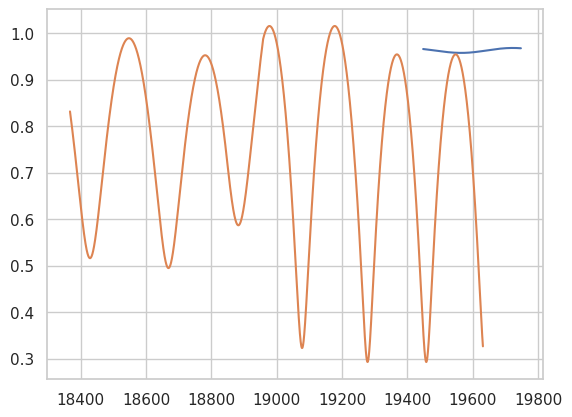

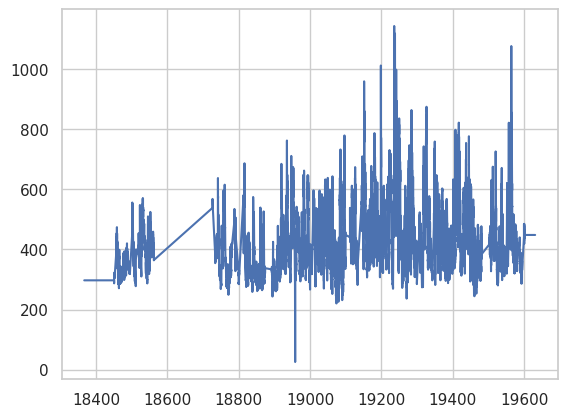

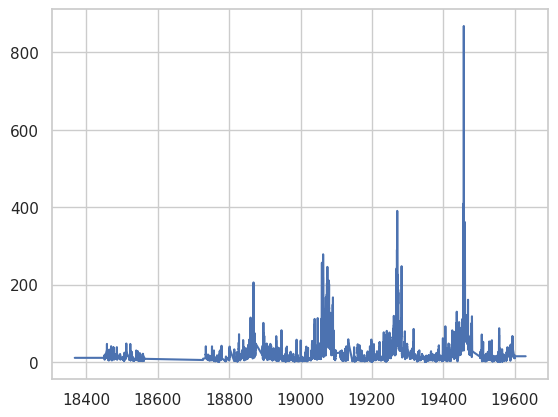

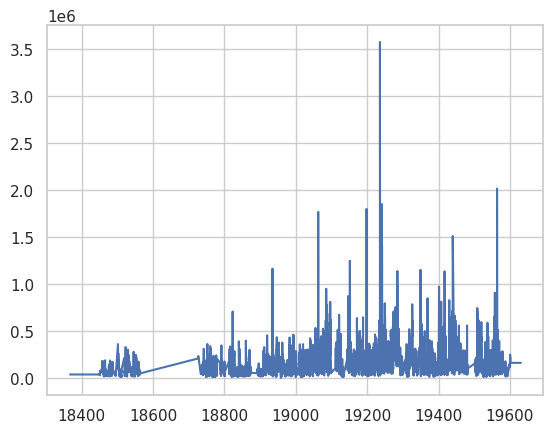

In [7]:
plt.figure(1)
plt.plot(sta_0['time'], sta_0.pos['r'])
plt.plot(solo_0['time'], solo_0.pos['r'])
plt.figure(2)
plt.plot(solo_0['time'], solo_0['speed'])
plt.figure(3)
plt.plot(solo_0['time'], solo_0['density'])
plt.figure(4)
plt.plot(solo_0['time'], solo_0['temp'])

In [8]:
#Load NOAA Data
noaa_dst = pickle.load(open(data_path+'noaa_dst_last_300files_now.p', 'rb'))
[noaa_b, noaa_bh] = pickle.load(open(data_path+'noaa_rtsw_last_300files_now.p', 'rb'))

noaa_dst1 = SatData({'time': [date2num(noaa_dst[x][0]) for x in range(len(noaa_dst))],
               'dst': [noaa_dst[x][1] for x in range(len(noaa_dst))]}, source='NOAA')

noaa_dst1.h['DataSource'] = "NOAA DST"
noaa_dst1.h['SamplingRate'] = mdates.num2date(noaa_dst1['time'][1]) - mdates.num2date(noaa_dst1['time'][0])
noaa_dst1.h['referenceFrame'] = 'GSM'
noaa_dst1.h['CoordinateSystem'] = 'rlonlat'

noaa_b1 = SatData({'time': date2num(noaa_b.time), 'btot': noaa_b.bt, 'bx': noaa_b.bx, 'by': noaa_b.by, 'bz': noaa_b.bz,
               'speed': noaa_b.vt, 'density': noaa_b.np, 'temp': noaa_b.tp}, source='NOAA')

Positions_noaa = PositionData([noaa_b.r, np.deg2rad(noaa_b.lon), np.deg2rad(noaa_b.lat)], postype='rlonlat')
Positions_noaa.h['Units'] = 'AU'
noaa_b1.pos = Positions_noaa

noaa = noaa_b1.interp_to_time(noaa_dst1['time'])
noaa['dst'] = noaa_dst1['dst']

noaa.h['DataSource'] = "NOAA MAG"
noaa.h['SamplingRate'] = mdates.num2date(noaa['time'][1]) - mdates.num2date(noaa['time'][0])
noaa.h['referenceFrame'] = 'GSM'
#noaa.h['Instruments'] = ['PLASTIC', 'IMPACT']
noaa.h['CoordinateSystem'] = 'rlonlat'

print(noaa)

Length of data:		5525
Keys in data:		['speed', 'density', 'temp', 'bx', 'by', 'bz', 'btot', 'dst']
First data point:	2023-06-09 00:00:00+00:00
Last data point:	2024-01-25 04:00:00+00:00

Header information:
                   DataSource:	NOAA MAG
                    SourceURL:	
                 SamplingRate:	1:00:00
               ReferenceFrame:	
                  FileVersion:	{}
                  Instruments:	[]
                 RemovedTimes:	[]
          PlasmaDataIntegrity:	10
               referenceFrame:	GSM
             CoordinateSystem:	rlonlat

Variable statistics:
         VAR        MEAN         STD
       speed      420.24       77.27
     density        4.86        4.86
        temp   116061.27   113598.37
          bx       -0.93        3.68
          by        0.24        4.48
          bz       -0.12        3.84
        btot        6.28        3.23
         dst      -10.13       20.93



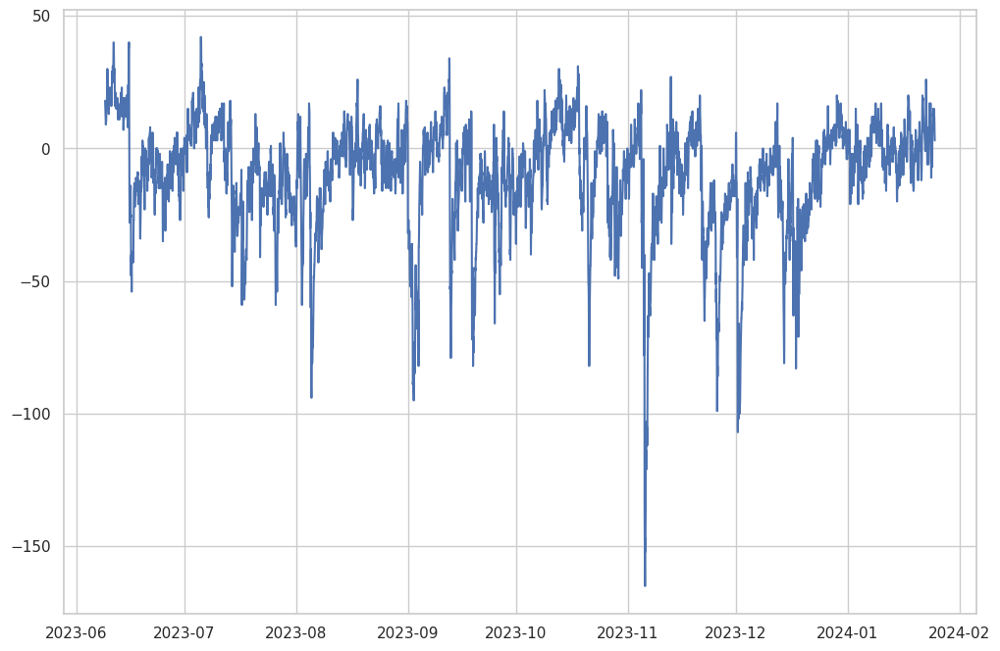

In [9]:
#plt.plot(noaa['time'], noaa['bx'])
plt.figure(figsize=(12,8))
plt.plot(mdates.num2date(noaa['time']), noaa['dst'])
#plt.plot(noaa_b['time'], noaa_b['r'])

In [10]:
#LOAD OMNI Data
[omni_input, omni_h] = pickle.load(open(data_path+'omni_1963_now.p', 'rb'))
print(omni_h)
scut=np.where(omni_input.time> parse_time('2020-03-01').datetime)[0][0]
omni_input = omni_input[scut:-1]

omni_0 = SatData({'time': date2num(omni_input.time),
               'dst': omni_input.dst,
               'density': omni_input.np, 
               'temp': omni_input.tp,
               'speed': omni_input.vt,
               'bx': omni_input.bx, 'by': omni_input.by, 'bz': omni_input.bz, 'btot': omni_input.bt}, source='OMNI')


omni_0.h['DataSource'] = "OMNI"
omni_0.h['SamplingRate'] = omni_input['time'][1] - omni_input['time'][0]
omni_0.h['ReferenceFrame'] = "GSM"
omni_0.h['CoordinateSystem'] = 'rlonlat'

Positions_omni = PositionData([omni_input.r, np.deg2rad(omni_input.lon), np.deg2rad(omni_input.lat)], postype='rlonlat')

#Positions_omni.h['Units'] = 'AU'
#Positions_omni.h['ReferenceFrame'] = 'HEEQ'
#Positions_omni.h['Observer'] = 'Sun'
omni_0.pos = Positions_omni

omni_0.interp_nans()

print(omni_0)

Near Earth OMNI2 1 hour solar wind and geomagnetic indices data since 1963. Obtained from https://spdf.gsfc.nasa.gov/pub/data/omni/low_res_omni/  Timerange: 1963-Jan-01 00:00 to 2024-Dec-31 23:00. The data are available in a numpy recarray, fields can be accessed by o.time, o.bx, o.vt etc. Missing data has been set to "np.nan". Total number of data points: 543504. For units and documentation see: https://spdf.gsfc.nasa.gov/pub/data/omni/low_res_omni/omni2.text, the heliospheric position of Earth was added and is given in x/y/z/r/lon/lat [AU, degree, HEEQ]. Made with https://github.com/cmoestl/heliocats heliocats.data.save_omni_data .By C. Moestl (twitter @chrisoutofspace), A. J. Weiss, and D. Stansby. File creation date: 2024-Jan-24 21:03 UTC
Length of data:		42406
Keys in data:		['speed', 'density', 'temp', 'bx', 'by', 'bz', 'btot', 'dst']
First data point:	2020-03-01 01:00:00+00:00
Last data point:	2024-12-31 22:00:00+00:00

Header information:
                   DataSource:	OMNI
   

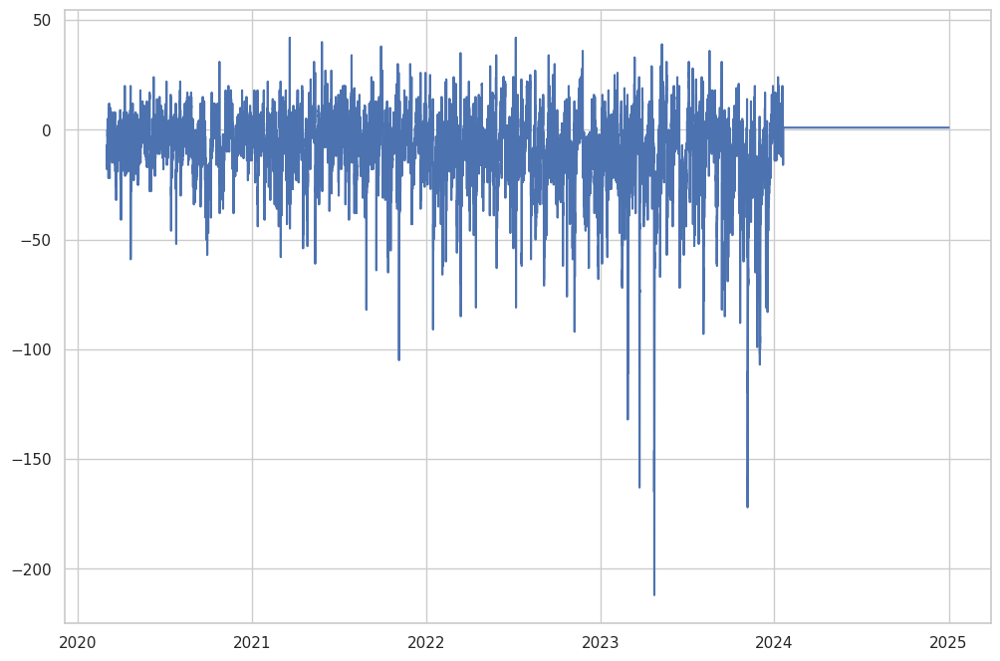

In [11]:
#plt.plot(omni_0['time'], omni_0.pos['r'])
plt.figure(figsize=(12,8))
plt.plot(mdates.num2date(omni_0['time']), omni_0['dst'])

In [12]:
# Copy data for 27-day 'persistence' or recurrence model
    
pers = copy.deepcopy(omni_0)
pers['time'] += t_pers # add 27 days
pers = pers.interp_to_time(omni_0['time'])

pers_noaa = copy.deepcopy(noaa)
pers_noaa['time'] += t_pers # add 27 days
pers_noaa = pers_noaa.interp_to_time(noaa['time'])
    
print(pers, pers_noaa)

Length of data:		42406
Keys in data:		['speed', 'density', 'temp', 'bx', 'by', 'bz', 'btot', 'dst']
First data point:	2020-03-28 07:28:48+00:00
Last data point:	2024-12-31 22:00:00+00:00

Header information:
                   DataSource:	OMNI
                    SourceURL:	
                 SamplingRate:	0.04166666666424135
               ReferenceFrame:	GSM
                  FileVersion:	{}
                  Instruments:	[]
                 RemovedTimes:	[]
          PlasmaDataIntegrity:	10
             CoordinateSystem:	rlonlat

Variable statistics:
         VAR        MEAN         STD
       speed      400.39       86.48
     density        7.50        5.21
        temp    78729.50    79496.94
          bx        0.63        3.08
          by       -1.41        4.23
          bz        0.25        2.38
        btot        5.52        2.64
         dst       -6.63       14.53
 Length of data:		5525
Keys in data:		['speed', 'density', 'temp', 'bx', 'by', 'bz', 'btot', 'dst']
First da

## DATA CORRECTION

1. Cut time series to STEREO-A data within angle bracket evaluated. 
2. Shift STEREO-A wind variables (magn. field variables, density) to smaller Earth orbit.
3. Calculate Temerin-Li Dst prediction for each set of input solar wind variables. (Important to do this before CME removal so that we get the full Dst development without missing time windows.)
4. Shift time in STEREO-B data to expected arrival times at L1.
7. Save corrected data as pickled objects for easy and quick loading later.
8. Plot some data as sanity check.

In [13]:
print('load positions')   

#positions needed for arrival time/speed calculation and plotting below
[psp, solo, sta, stereob_recon, bepi, wind, earth, mercury, venus, mars, jupiter, saturn, uranus, neptune]=pickle.load( open(data_path+'positions_psp_solo_sta_bepi_wind_planets_HEEQ_10min_rad.p', "rb" ) )

print('done')

load positions
done


In [14]:
validation_data = pd.read_csv('data/sub-L1_IDs.csv', delimiter=';', header=0)

cme_donki = pd.read_json('data/DONKI.json')
cme_donki['time21_5'] = mdates.date2num(cme_donki.time21_5)

data_donki = cme_donki.groupby('associatedCMEID').mean().reset_index()

ic=pd.read_csv('data/stereoa.csv', delimiter=',', header=0) 
ic_wind=pd.read_csv('data/wind.csv', delimiter=',', header=0) 

#for i in range(len(validation_data)):
print(ic.icme_start_time[0])
print(mdates.date2num(datetime.strptime(ic.icme_start_time[0], '%Y-%m-%d %H:%M')))

print('Corresponding DONKI-IDs: ', validation_data)
print(' ')
sta_icme_start_time = mdates.date2num(ic.icme_start_time)
wind_icme_start_time = mdates.date2num(ic_wind.icme_start_time)
#print(mdates.date2num(2023-04-23 17:00))
print('input data loaded')

2020-04-19 05:06
18371.2125
Corresponding DONKI-IDs:                            DONKI
0   2020-04-14T21:54:00-CME-001
1   2021-11-02T02:48:00-CME-001
2   2022-03-07T00:12:00-CME-001
3   2022-03-10T19:23:00-CME-001
4   2023-04-21T18:12:00-CME-001
5   2023-07-11T19:24:00-CME-001
6   2023-07-14T19:10:00-CME-001
7   2023-07-17T23:36:00-CME-001
8   2023-07-28T22:36:00-CME-001
9   2023-09-16T09:12:00-CME-001
10  2023-09-22T02:24:00-CME-001
11  2023-10-31T22:12:00-CME-001
 
input data loaded


In [15]:
#Update initial parameters via minimizing RMSE (actual heliospheric distance - calculated radius using drag-based model)

gamma_update = [] 
ambient_wind_update = []
speed_update = []
velocity = []

for i in range(len(validation_data)):
    index = data_donki.associatedCMEID[data_donki.associatedCMEID == str(validation_data.DONKI[i])].index[0]
    #index_measure = ic.icmecat_id[ic.icmecat_id == str(validation_data.ICME_Monitor[i])].index[0]
    
    distance0 = 21.5*u.solRad.to(u.km)
   
    t0_num = data_donki.time21_5[index]
    t0 = mdates.num2date(t0_num)
    print(t0)
    gamma_init = 0.1                  
    ambient_wind_init = 400
    speed_init = data_donki.speed[index]
    x0 = [speed_init, ambient_wind_init, gamma_init]
    print('Initial Parameters (DONKI): ', gamma_init, ambient_wind_init, speed_init)
    
    kindays = 10
    n_ensemble = 50000
    halfwidth = np.deg2rad(37.)
    res_in_min = 10
    f = 0.7
    
    sc_measure_name = ic.sc_insitu[i]
    
    print('Sub-L1 monitor s/c: ', sc_measure_name)
    
    if sc_measure_name == 'PSP':
        sc_measure = psp
    if sc_measure_name == 'SolarOrbiter':
        sc_measure = solo
    if sc_measure_name == 'STEREO-A':
        sc_measure = sta
    if sc_measure_name == 'BepiColombo':
        sc_measure = bepi
    if sc_measure_name == 'Wind':
        sc_measure = wind

    sc_ind_measure = np.argmin(np.abs(t0_num-sc_measure.time))

    if np.abs(np.deg2rad(data_donki.longitude[index])) + np.abs(sc_measure.lon[sc_ind_measure]) > np.pi and np.sign(np.deg2rad(data_donki.longitude[index])) != np.sign(sc_measure.lon[sc_ind_measure]): 
        delta_sc_measure = np.deg2rad(data_donki.longitude[index]) - (sc_measure.lon[sc_ind_measure] + 2 * np.pi * np.sign(np.deg2rad(data_donki.longitude[index])))
    
    else:
        delta_sc_measure = np.deg2rad(data_donki.longitude[index]) - sc_measure.lon[sc_ind_measure]
    
    index_sc_heliodistance = np.argmin(abs(sta_icme_start_time[i]-sc_measure.time))
    cme_prop_time = (parse_time(ic.icme_start_time[i])-parse_time(mdates.num2date(data_donki.time21_5[index]))).sec
    print(mdates.num2date(data_donki.time21_5[index]+cme_prop_time/3600/24))
    
    def cme_r_prop(x, time_diff, distance0=distance0):
        if x[0] >= x[1]:
            accsign = 1.

        else:
            accsign = -1.
        
        rdrag = (accsign / (x[2] * 1e-7)) * np.log(1 + (accsign * x[2] * 1e-7) * ((x[0] - x[1]) * time_diff)) + x[1] * time_diff + distance0
        vdrag = (x[0] - x[1]) / (1 + (accsign * (x[2] * 1e-7) * (x[0] - x[1]) * time_diff)) + x[1]
        
        return rdrag, vdrag
    
    rdrag, vdrag = cme_r_prop(x0, cme_prop_time)
    print(rdrag*u.km.to(u.au), vdrag)
    
    def rmse(x, time_diff=cme_prop_time, r_sc=sc_measure.r[index_sc_heliodistance], cme_delta=delta_sc_measure): #v_sc=speed_ic, 
               
        if x[0] >= x[1]:
            accsign = 1.

        else:
            accsign = -1.
        
        r_at_sc = (accsign / (x[2] * 1e-7)) * np.log(1 + (accsign * x[2] * 1e-7) * ((x[0] - x[1]) * time_diff)) + x[1] * time_diff + distance0
        #v_at_sc= (x[2] - x[1]) / (1 + (accsign * (x[2] * 1e-7) * (x[0] - x[1]) * time_diff)) + x[1]
        
        cme_r_au = r_at_sc*u.km.to(u.au)
        
        theta_monitor = np.arctan(f**2 * np.tan(halfwidth))
        omega_monitor = np.sqrt(np.cos(theta_monitor)**2 * (f**2 - 1) + 1)   
        cme_b_monitor = cme_r_au * omega_monitor * np.sin(halfwidth) / (np.cos((halfwidth) - theta_monitor) + omega_monitor * np.sin(halfwidth))    
        cme_a_monitor = cme_b_monitor / f
        cme_c_monitor = cme_r_au - cme_b_monitor
        
        root = np.sin(cme_delta)**2 * f**2 * (cme_b_monitor**2 - cme_c_monitor**2) + np.cos(cme_delta)**2 * cme_b_monitor**2
        distance_sc_monitor = (cme_c_monitor * np.cos(cme_delta) + np.sqrt(root)) / (np.sin(cme_delta)**2 * f**2 + np.cos(cme_delta)**2)
        
        rmse = np.sqrt((r_sc - distance_sc_monitor)**2)
        
        return rmse

    params_opt = minimize(rmse, x0, bounds=((0, None), (0, None), (0, None)), method='Nelder-Mead')
    
    print(params_opt.message)
    
    parameter = [params_opt.x[0], params_opt.x[1], params_opt.x[2]]
    print('Optimized Parameters: [gamma, ambient wind, inital CME speed]: ', parameter)
    
    gamma_update.append(params_opt.x[2])
    ambient_wind_update.append(params_opt.x[1])
    speed_update.append(params_opt.x[0])
    
    def check(x, time_diff=cme_prop_time, cme_delta=delta_sc_measure): #v_sc=speed_ic, 

        r_at_sc, v_at_sc = cme_r_prop(x, cme_prop_time)

        cme_r_au = r_at_sc*u.km.to(u.au)
        cme_v_au = v_at_sc

        theta_monitor = np.arctan(f**2 * np.tan(halfwidth))
        omega_monitor = np.sqrt(np.cos(theta_monitor)**2 * (f**2 - 1) + 1)   
        cme_b_monitor = cme_r_au * omega_monitor * np.sin(halfwidth) / (np.cos((halfwidth) - theta_monitor) + omega_monitor * np.sin(halfwidth))    
        cme_a_monitor = cme_b_monitor / f
        cme_c_monitor = cme_r_au - cme_b_monitor

        root = np.sin(cme_delta)**2 * f**2 * (cme_b_monitor**2 - cme_c_monitor**2) + np.cos(cme_delta)**2 * cme_b_monitor**2
        distance_sc_monitor = (cme_c_monitor * np.cos(cme_delta) + np.sqrt(root)) / (np.sin(cme_delta)**2 * f**2 + np.cos(cme_delta)**2)

        return distance_sc_monitor, cme_v_au, cme_r_au

    check_distance, velocity_at_sc, apex_distance = check(x=parameter)
    velocity.append(velocity_at_sc)
    print('Actual position of sub-L1 monitor: ', sc_measure.r[index_sc_heliodistance])
    print('Calculated STEREO-A position and apex distance using updated paramters: ', check_distance, velocity_at_sc, apex_distance)
    print(' ')


2020-04-15 15:51:00+00:00
Initial Parameters (DONKI):  0.1 400 232.0
Sub-L1 monitor s/c:  SolarOrbiter
2020-04-19 05:06:00+00:00
0.6426357365855241 289.1522256649547
Optimization terminated successfully.
Optimized Parameters: [gamma, ambient wind, inital CME speed]:  [395.0109521268073, 722.7479726612246, 0.06493200865889115]
Actual position of sub-L1 monitor:  0.808524846854322
Calculated STEREO-A position and apex distance using updated paramters:  0.8085248297825504 524.4922347922887 1.0652329878683306
 
2021-11-02 05:52:00+00:00
Initial Parameters (DONKI):  0.1 400 1151.0
Sub-L1 monitor s/c:  SolarOrbiter
2021-11-03 14:03:00+00:00
0.8282283686585424 801.5809563145156
Optimization terminated successfully.
Optimized Parameters: [gamma, ambient wind, inital CME speed]:  [1179.3559796207555, 408.429924308737, 0.09885238459952517]
Actual position of sub-L1 monitor:  0.8433347049424142
Calculated STEREO-A position and apex distance using updated paramters:  0.8433346985213682 817.8557259

In [22]:
time_shift_hours = []
time_shift_err0 = []
time_shift_err1 = []

min_time = []
max_time = []

all0 = []
omni_all = []
pers_all = []

for i in range(len(validation_data)):
    print(f'Processing CME {i+1}')
    
    index = data_donki.associatedCMEID[data_donki.associatedCMEID == str(validation_data.DONKI[i])].index[0]
    distance0 = 21.5*u.solRad.to(u.km)
    gamma_init = gamma_update[i]
    ambient_wind_init = ambient_wind_update[i]
    speed_init = speed_update[i]

    n_ensemble = 100000


    sc_measure_name = ic.sc_insitu[i]
    
    print('Sub-L1 monitor s/c: ', sc_measure_name)
    
    if sc_measure_name == 'PSP':
        sc_measure = psp
    if sc_measure_name == 'SolarOrbiter':
        sc_measure = solo
    if sc_measure_name == 'STEREO-A':
        sc_measure = sta
    if sc_measure_name == 'BepiColombo':
        sc_measure = bepi
    if sc_measure_name == 'Wind':
        sc_measure = wind
    
    sc_name = 'Wind' 
    if sc_name == 'PSP':
        sc = psp
    if sc_name == 'SolarOrbiter':
        sc = solo
    if sc_name == 'STEREO-A':
        sc = sta
    if sc_name == 'BepiColombo':
        sc = bepi
    if sc_name == 'Wind':
        sc = wind

        
    cme_v=np.zeros(3)
    cme_r_ensemble=np.zeros(n_ensemble)
    cme_v_ensemble=np.zeros(n_ensemble)

    gamma = np.abs(np.random.normal(gamma_init,0.1,n_ensemble))
    ambient_wind = np.random.normal(ambient_wind_init,100,n_ensemble)
    speed = np.random.normal(speed_init,100,n_ensemble)

    accsign_ensemble = np.ones(n_ensemble)
    accsign_ensemble[speed < ambient_wind] = -1.

    cme_prop_time = (parse_time(ic.icme_start_time[i])-parse_time(mdates.num2date(data_donki.time21_5[index]))).sec
    
    cme_r_ensemble = (accsign_ensemble / (gamma * 1e-7)) * np.log(1 + (accsign_ensemble * (gamma * 1e-7) * ((speed - ambient_wind) * cme_prop_time))) + ambient_wind * cme_prop_time + distance0
    cme_v_ensemble = (speed - ambient_wind) / (1 + (accsign_ensemble * (gamma * 1e-7) * (speed - ambient_wind) * cme_prop_time)) + ambient_wind
                   
    #print(np.mean(cme_r_ensemble*u.km.to(u.au)))
    cme_v[0]=np.mean(cme_v_ensemble)
    cme_v[1]=np.mean(cme_v_ensemble) - 2*np.std(cme_v_ensemble)
    cme_v[2]=np.mean(cme_v_ensemble) + 2*np.std(cme_v_ensemble)
    
    icme_arr_ind = np.argmin(np.abs(mdates.date2num(datetime.strptime(ic.icme_start_time[i], '%Y-%m-%d %H:%M'))-sc_measure.time))
    icme_arr_wind_ind = np.argmin(np.abs(mdates.date2num(datetime.strptime(ic.icme_start_time[i], '%Y-%m-%d %H:%M'))-sc.time))
    
    delta_r = np.abs(sc.r[icme_arr_wind_ind]-sc_measure.r[icme_arr_ind])*u.au.to(u.km)
    
    time_shift = np.zeros(3)
    if speed_init >= ambient_wind_init:
        accsign = 1.

    else:
        accsign = -1
    #time_shift_hours.append((delta_r * ((cme_v[0] - ambient_wind_init) / (1 + (accsign * (gamma_init * 1e-7) * (cme_v[0] - ambient_wind_init) * delta_r/cme_v[0])) + ambient_wind_init)**(-1))/3600.)
    #time_shift_err0.append((delta_r * ((cme_v[1] - ambient_wind_init) / (1 + (accsign * (gamma_init * 1e-7) * (cme_v[1] - ambient_wind_init) * delta_r/cme_v[1])) + ambient_wind_init)**(-1))/3600.)
    #time_shift_err1.append((delta_r * ((cme_v[2] - ambient_wind_init) / (1 + (accsign * (gamma_init * 1e-7) * (cme_v[2] - ambient_wind_init) * delta_r/cme_v[2])) + ambient_wind_init)**(-1))/3600.)

    time_shift_hours.append(delta_r * (cme_v[0])**(-1)/3600.)
    time_shift_err0.append(delta_r * (cme_v[1])**(-1)/3600.)
    time_shift_err1.append(delta_r * (cme_v[2])**(-1)/3600.)

    
    print('time shift in hours: ', time_shift_hours[i])
    print(datetime.strptime(ic.icme_start_time[i], '%Y-%m-%d %H:%M')+timedelta(hours=time_shift_hours[i]))
    print(datetime.strptime(ic.icme_start_time[i], '%Y-%m-%d %H:%M')+timedelta(hours=time_shift_err0[i]))
    print(datetime.strptime(ic.icme_start_time[i], '%Y-%m-%d %H:%M')+timedelta(hours=time_shift_err1[i]))
    print('Actual arrival time: ', ic_wind.icme_start_time[i])
    print((mdates.date2num(datetime.strptime(ic_wind.icme_start_time[i], '%Y-%m-%d %H:%M'))-mdates.date2num(datetime.strptime(ic.icme_start_time[i], '%Y-%m-%d %H:%M')+timedelta(seconds=time_shift_hours[i])))*24)
    print(' ')
    
    min_time.append(datetime.strptime(ic.icme_start_time[i], "%Y-%m-%d %H:%M")-timedelta(days=3))
    max_time.append(datetime.strptime(ic.icme_start_time[i], "%Y-%m-%d %H:%M")+timedelta(days=5))
    
    if ic.sc_insitu[i] == 'STEREO-A':
        sta_cut = copy.deepcopy(sta_0)
        sta_cut = sta_cut.cut(starttime=min_time[i], endtime=max_time[i])
        all0.append(sta_cut)
        #all1.append(sta_cut)
        #all2.append(sta_cut)
    
    elif ic.sc_insitu[i] == 'SolarOrbiter':
        solo_cut = copy.deepcopy(solo_0)
        solo_cut = solo_cut.cut(starttime=min_time[i], endtime=max_time[i])
        all0.append(solo_cut)
        #all1.append(solo_cut)
        #all2.append(solo_cut)
    
    if ic_wind.sc_insitu[i] == 'OMNI':
        omni_cut = copy.deepcopy(omni_0)
        omni_cut = omni_cut.cut(starttime=min_time[i], endtime=max_time[i])
        pers_cut = copy.deepcopy(pers)
        pers_cut = pers_cut.cut(starttime=min_time[i], endtime=max_time[i])
        omni_all.append(omni_cut)
        pers_all.append(pers_cut)
        
    elif ic_wind.sc_insitu[i] == 'NOAA':
        noaa_cut = copy.deepcopy(noaa)
        noaa_cut = noaa_cut.cut(starttime=min_time[i], endtime=max_time[i])
        pers_cut_noaa = copy.deepcopy(pers_noaa)
        pers_cut_noaa = pers_cut_noaa.cut(starttime=min_time[i], endtime=max_time[i])
        omni_all.append(noaa_cut)
        pers_all.append(pers_cut_noaa)
        

Processing CME 1
Sub-L1 monitor s/c:  SolarOrbiter
time shift in hours:  14.259592163432673
2020-04-19 19:21:34.531788
2020-04-20 04:01:19.584343
2020-04-19 15:26:55.334006
Actual arrival time:  2020-04-20 01:34
20.462705668935087
 
Processing CME 2
Sub-L1 monitor s/c:  SolarOrbiter
time shift in hours:  6.924189097993656
2021-11-03 20:58:27.080753
2021-11-04 01:39:21.323649
2021-11-03 18:59:02.025506
Actual arrival time:  2021-11-03 19:40
5.6147432808356825
 
Processing CME 3
Sub-L1 monitor s/c:  SolarOrbiter
time shift in hours:  39.71238923938071
2022-03-10 06:28:44.601262
2022-03-11 01:02:01.191046
2022-03-09 20:53:14.573593
Actual arrival time:  2022-03-10 16:12
49.42230211413698
 
Processing CME 4
Sub-L1 monitor s/c:  SolarOrbiter
time shift in hours:  31.915436519465665
2022-03-13 03:47:55.571470
2022-03-13 14:59:21.555078
2022-03-12 21:13:15.521371
Actual arrival time:  2022-03-13 10:04
38.17446793417912
 
Processing CME 5
Sub-L1 monitor s/c:  STEREO-A
time shift in hours:  1.5

In [273]:
print(all0)

[<predstorm.data.SatData object at 0x7f99e0b45710>, <predstorm.data.SatData object at 0x7f99e0b45590>, <predstorm.data.SatData object at 0x7f99e0b45ed0>, <predstorm.data.SatData object at 0x7f9b1a6fe7d0>, <predstorm.data.SatData object at 0x7f99e022d310>, <predstorm.data.SatData object at 0x7f99e022dd50>, <predstorm.data.SatData object at 0x7f99e022df90>, <predstorm.data.SatData object at 0x7f99e022df50>, <predstorm.data.SatData object at 0x7f99e022db90>, <predstorm.data.SatData object at 0x7f9b1a6fed10>, <predstorm.data.SatData object at 0x7f99e024f790>, <predstorm.data.SatData object at 0x7f99e024ff10>]


In [199]:
calculate_arrival = True

time_shift_hours = []
time_shift_err0 = []
time_shift_err1 = []

min_time = []
max_time = []

all0 = []
omni_all = []
pers_all = []

print(ic.icme_start_time)

for i in range(len(validation_data)):
#def donki_kinematics(i):
    index = data_donki.associatedCMEID[data_donki.associatedCMEID == str(validation_data.DONKI[i])].index[0]

    distance0 = 21.5*u.solRad.to(u.km)
   
    t0_num = data_donki.time21_5[index]
    t0 = mdates.num2date(t0_num)
    gamma_init = gamma[i]                  
    ambient_wind_init = ambient_wind[i]
    speed_init = speed[i]
    
    #print(t0_num-mdates.date2num(ic.icme_start_time[i]))
    
    #gamma_init = 0.1
    #ambient_wind_init = 400
    #speed_init = data_donki.speed[index]
    
    parameter = [gamma_init, ambient_wind_init, speed_init]
    print('Parameters used for calculating arrival time: ', parameter)
    
    kindays = 10
    n_ensemble = 100
    halfwidth = np.deg2rad(37.)
    res_in_min = 10
    f = 0.7
    
    sc_name = 'Wind' 
    if sc_name == 'PSP':
        sc = psp
    if sc_name == 'SolarOrbiter':
        sc = solo
    if sc_name == 'STEREO-A':
        sc = sta
    if sc_name == 'BepiColombo':
        sc = bepi
    if sc_name == 'Wind':
        sc = wind
    
    sc_ind = np.argmin(np.abs(t0_num-sc.time))

    if np.abs(np.deg2rad(data_donki.longitude[index])) + np.abs(sc.lon[sc_ind]) > np.pi and np.sign(np.deg2rad(data_donki.longitude[index])) != np.sign(sc.lon[sc_ind]): 
        delta_sc = np.deg2rad(data_donki.longitude[index]) - (sc.lon[sc_ind] + 2 * np.pi * np.sign(np.deg2rad(data_donki.longitude[index])))
    
    else:
        delta_sc = np.deg2rad(data_donki.longitude[index]) - sc.lon[sc_ind]
    
    #times for each event kinematic
    time1=[]
    tstart1=copy.deepcopy(t0)

    tend1=tstart1+timedelta(days=kindays)
    #make 30 min datetimes
    while tstart1 < tend1:

        time1.append(tstart1)  
        tstart1 += timedelta(minutes=res_in_min)    

    #make kinematics
    
    kindays_in_min = int(kindays*24*60/res_in_min)
    

    cme_lon=np.ones(kindays_in_min)*data_donki.longitude.iloc[index]
    cme_lat=np.ones(kindays_in_min)*data_donki.latitude.iloc[index]
    
    cme_delta=delta_sc*np.ones([kindays_in_min,3])
    cme_hit=np.zeros(kindays_in_min)
    cme_hit[np.abs(delta_sc)<halfwidth] = 1
    distance_sc = np.empty([kindays_in_min,3])
    distance_sc[:] = np.nan
    
    def r(x):
        timestep=np.zeros([kindays_in_min,n_ensemble])
        cme_r=np.zeros([kindays_in_min, 3])
        cme_v=np.zeros([kindays_in_min, 3])
        cme_id=np.chararray(kindays_in_min, itemsize=27)
        cme_r_ensemble=np.zeros([kindays_in_min, n_ensemble])
        cme_v_ensemble=np.zeros([kindays_in_min, n_ensemble])
        cme_B = np.zeros([kindays_in_min, 3])
        
        for j in np.arange(0,len(cme_r)-1,1):
            
            gamma_ensemble=np.random.normal(x[0], 0.025, n_ensemble)
            gamma_ensemble[gamma_ensemble<0]=x[0]
            ambient_wind_ensemble=np.random.normal(x[1], 50, n_ensemble)
            speed_ensemble=np.random.normal(x[2], 25, n_ensemble)

            accsign = np.ones(n_ensemble)
            accsign[speed_ensemble < ambient_wind_ensemble] = -1.
        
            
            cme_id[0]=data_donki.associatedCMEID.iloc[index]
            cme_id[j+1]=data_donki.associatedCMEID.iloc[index]
            cme_r[0]=distance0*u.km.to(u.au)

            timestep[j+1]=timestep[j]+res_in_min*60 #seconds (speed given in kilometers per second)

            distance0_list = np.array(distance0*np.ones(n_ensemble))
            
            #calculate radial distance for each timestep, CME, and ensemble member
            cme_r_ensemble[j+1]=(accsign / (gamma_ensemble * 1e-7)) * np.log(1 + (accsign * (gamma_ensemble * 1e-7) * ((speed_ensemble - ambient_wind_ensemble) * timestep[j+1]))) + ambient_wind_ensemble * timestep[j+1] + distance0_list
            cme_v_ensemble[j+1] = (speed_ensemble - ambient_wind_ensemble) / (1 + (accsign * (gamma_ensemble * 1e-7) * (speed_ensemble - ambient_wind_ensemble) * timestep[j+1])) + ambient_wind_ensemble
            
            cme_r[j+1][0]=np.mean(cme_r_ensemble[j+1])*u.km.to(u.au)
            cme_r[j+1][1]=np.mean(cme_r_ensemble[j+1])*u.km.to(u.au) - 2*np.std(cme_r_ensemble[j+1])*u.km.to(u.au)
            cme_r[j+1][2]=np.mean(cme_r_ensemble[j+1])*u.km.to(u.au) + 2*np.std(cme_r_ensemble[j+1])*u.km.to(u.au)
            
            cme_v[j+1][0]=np.mean(cme_v_ensemble[j+1])*u.km.to(u.au)
            cme_v[j+1][1]=np.mean(cme_v_ensemble[j+1])*u.km.to(u.au) - 2*np.std(cme_v_ensemble[j+1])*u.km.to(u.au)
            cme_v[j+1][2]=np.mean(cme_v_ensemble[j+1])*u.km.to(u.au) + 2*np.std(cme_v_ensemble[j+1])*u.km.to(u.au)
            
        return cme_r, cme_v

    cme_r, cme_v = r(parameter)
    
    #Ellipse parameters   
    theta = np.arctan(f**2*np.ones([kindays_in_min,3]) * np.tan(halfwidth*np.ones([kindays_in_min,3])))
    omega = np.sqrt(np.cos(theta)**2 * (f**2*np.ones([kindays_in_min,3]) - 1) + 1)   
    cme_b = cme_r * omega * np.sin(halfwidth*np.ones([kindays_in_min,3])) / (np.cos(halfwidth*np.ones([kindays_in_min,3]) - theta) + omega * np.sin(halfwidth*np.ones([kindays_in_min,3])))    
    cme_a = cme_b / f*np.ones([kindays_in_min,3])
    cme_c = cme_r - cme_b
        
    root = np.sin(cme_delta)**2 * f**2*np.ones([kindays_in_min,3]) * (cme_b**2 - cme_c**2) + np.cos(cme_delta)**2 * cme_b**2
    distance_sc[cme_hit.all() == 1] = (cme_c * np.cos(cme_delta) + np.sqrt(root)) / (np.sin(cme_delta)**2 * f**2*np.ones([kindays_in_min,3]) + np.cos(cme_delta)**2) #distance from SUN in AU for given point on ellipse

    arr_time = []
    arr_speed = []
    arrival = []
    time_shift = []
    if np.isnan(distance_sc).all() == False:
    
        #arr_time_ind = np.argmin(np.abs(t0_num-mdates.date2num(ic.icme_start_time[i])))
        #icme_arr_ind = np.argmin(np.abs(sc_measure.time-mdates.date2num(ic.icme_start_time[i])))
        #icme_arr_wind_ind = np.argmin(np.abs(sc.time-mdates.date2num(ic.icme_start_time[i])))

        for t in range(3):
            index_arr = np.argmin(np.abs(distance_sc[:,t] - sc.r[sc_ind]))
            #distance_diff = np.diff(distance_sc[:,t]*u.au.to(u.km))
            #time_diff = np.diff(timestep[:,0])
            #speed_at_sc = distance_diff / time_diff
            arr_time.append(time1[int(index_arr)])
            #time_shift.append((sc.r[icme_arr_wind_ind]-sc_measure[icme_arr_ind])*1./cme_v[:,t][arr_time_ind])
            #arr_speed.append(speed_at_sc[int(index_arr-1)])
        
        err_arr_time = (arr_time[1]-arr_time[2]).total_seconds()/3600. 
        #arr_time_new = datetime.strptime(ic.icme_start_time[i], "%Y-%m-%d %H:%M:%S")-timedelta(seconds=time_shift[0])
        #arrival.append([ic_wind.sc_insitu, delta_sc, arr_time[0], np.round(err_arr_time,2), (parse_time(arr_time[0])-parse_time(ic_wind.icme_start_time)).sec/3600])    

    print('Predicted arrival time using updated parameters: ', arr_time[0])
    #print('Predicted arrival time using updated parameters (NEW): ', arr_time_new)
    #print('Actual arrival time at ', str(ic.sc_insitu[i]), ': ', ic.icme_start_time[i])
    print('Actual arrival time at Wind: ', ic_wind.icme_start_time[i])
    print((mdates.date2num(datetime.strptime(ic_wind.icme_start_time[i], '%Y-%m-%d %H:%M'))-mdates.date2num(arr_time[0]))*24)
    
    
    
    time_shift_hours.append((parse_time(arr_time[0]) - parse_time(ic.icme_start_time[i])).sec/3600)
    time_shift_err0.append((parse_time(arr_time[1]) - parse_time(ic.icme_start_time[i])).sec/3600)
    time_shift_err1.append((parse_time(arr_time[2]) - parse_time(ic.icme_start_time[i])).sec/3600)
    
    print('Time shift: ', time_shift_hours[i])
    print(' ')
    
    
    min_time.append(datetime.strptime(ic.icme_start_time[i], "%Y-%m-%d %H:%M")-timedelta(days=3))
    max_time.append(datetime.strptime(ic.icme_start_time[i], "%Y-%m-%d %H:%M")+timedelta(days=5))
    
    if ic.sc_insitu[i] == 'STEREO-A':
        sta_cut = copy.deepcopy(sta_0)
        sta_cut = sta_cut.cut(starttime=min_time[i], endtime=max_time[i])
        all0.append(sta_cut)
        #all1.append(sta_cut)
        #all2.append(sta_cut)
    
    elif ic.sc_insitu[i] == 'SolarOrbiter':
        solo_cut = copy.deepcopy(solo_0)
        solo_cut = solo_cut.cut(starttime=min_time[i], endtime=max_time[i])
        all0.append(solo_cut)
        #all1.append(solo_cut)
        #all2.append(solo_cut)
    
    if ic_wind.sc_insitu[i] == 'OMNI':
        omni_cut = copy.deepcopy(omni_0)
        omni_cut = omni_cut.cut(starttime=min_time[i], endtime=max_time[i])
        pers_cut = copy.deepcopy(pers)
        pers_cut = pers_cut.cut(starttime=min_time[i], endtime=max_time[i])
        omni_all.append(omni_cut)
        pers_all.append(pers_cut)
        
    elif ic_wind.sc_insitu[i] == 'NOAA':
        noaa_cut = copy.deepcopy(noaa)
        noaa_cut = noaa_cut.cut(starttime=min_time[i], endtime=max_time[i])
        pers_cut_noaa = copy.deepcopy(pers_noaa)
        pers_cut_noaa = pers_cut_noaa.cut(starttime=min_time[i], endtime=max_time[i])
        omni_all.append(noaa_cut)
        pers_all.append(pers_cut_noaa)
        
    #return all0, omni_all, pers_all, time_shift_hours, time_shift_err0, time_shift_err1 
    
    
print('done')

0     2020-04-19 05:06
1     2021-11-03 14:03
2     2022-03-08 14:46
3     2022-03-11 19:53
4     2023-04-23 14:29
5     2023-07-14 10:47
6     2023-07-16 12:50
7     2023-07-20 15:29
8     2023-08-01 09:31
9     2023-09-18 09:03
10    2023-09-24 17:50
11    2023-11-04 00:17
Name: icme_start_time, dtype: object
Parameters used for calculating arrival time:  [0.06493200865889115, 722.7479726612246, 395.0109521268073]
Predicted arrival time using updated parameters:  2020-04-19 11:21:00+00:00
Actual arrival time at Wind:  2020-04-20 01:34
14.216666666732635
Time shift:  6.249999999999998
 
Parameters used for calculating arrival time:  [0.09885238459952517, 408.429924308737, 1179.3559796207555]
Predicted arrival time using updated parameters:  2021-11-03 21:12:00+00:00
Actual arrival time at Wind:  2021-11-03 19:40
-1.5333333333546761
Time shift:  7.149999999999999
 
Parameters used for calculating arrival time:  [0.09234576635690232, 410.8990618346474, 556.7575332072252]
Predicted arriv

Event:  1


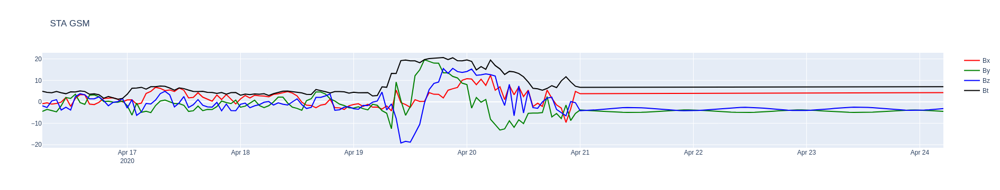

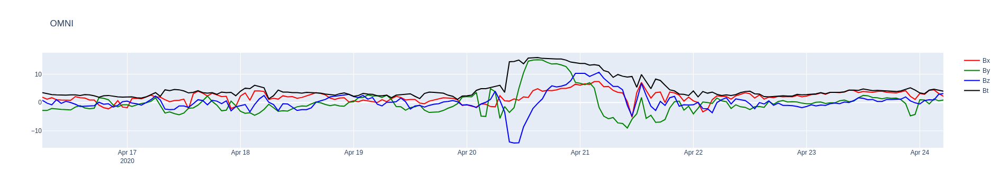

Event:  2


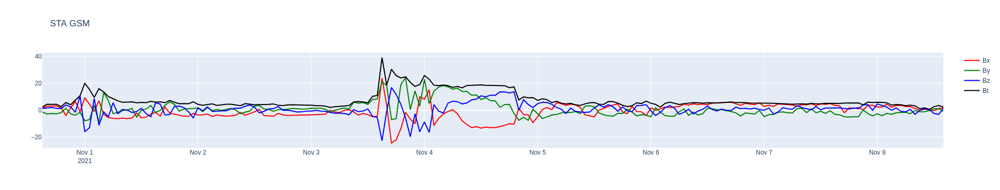

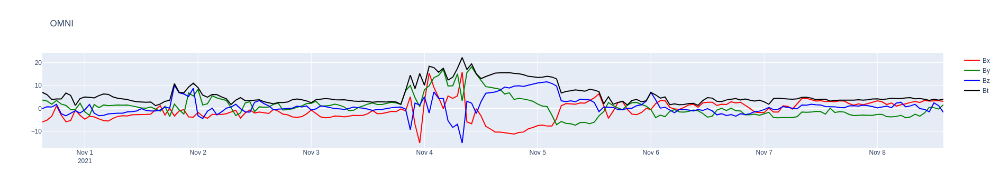

Event:  3


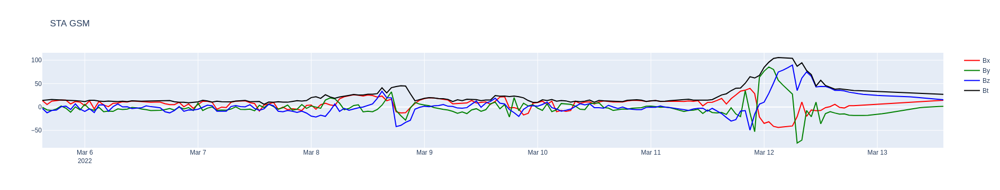

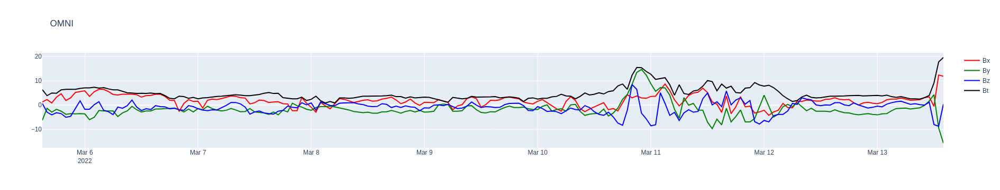

Event:  4


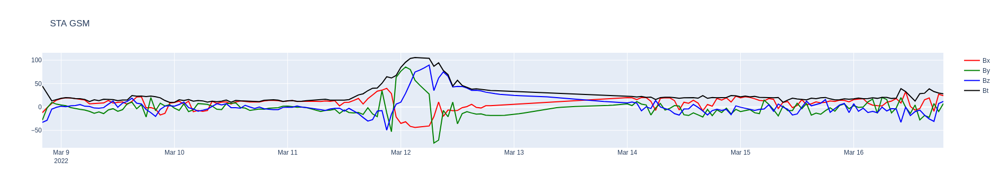

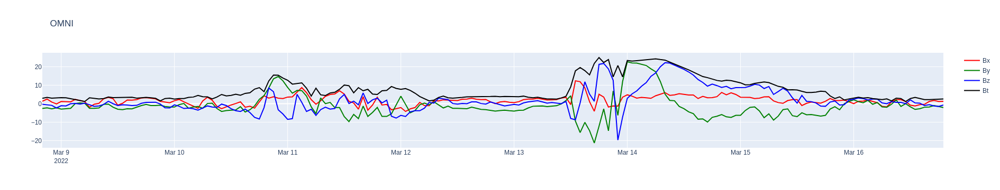

Event:  5


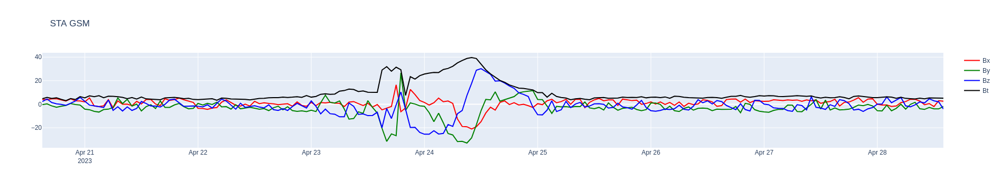

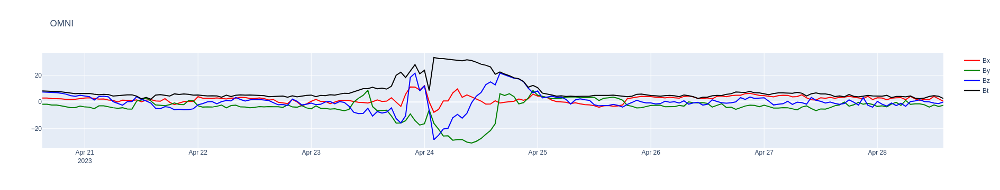

Event:  6


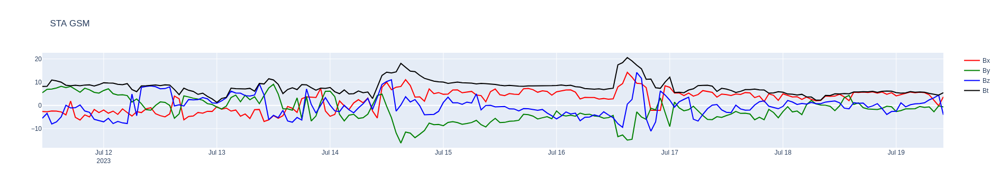

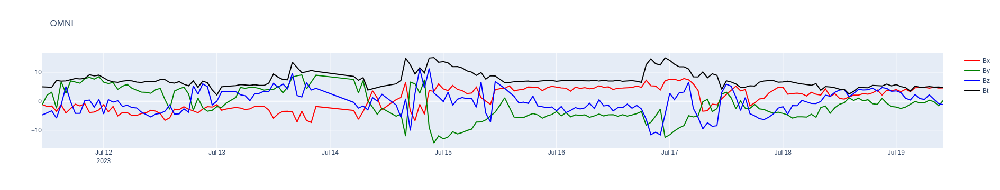

Event:  7


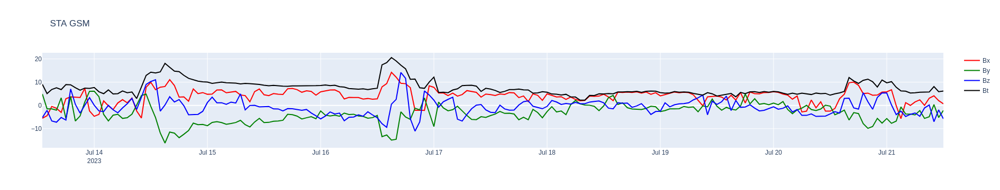

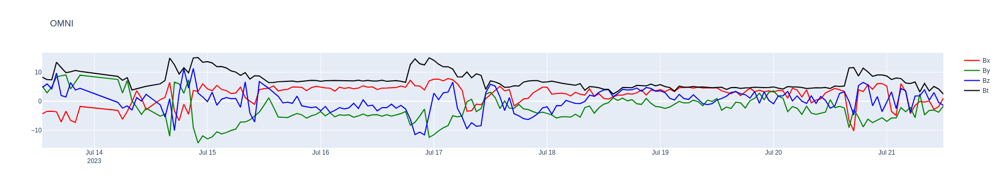

Event:  8


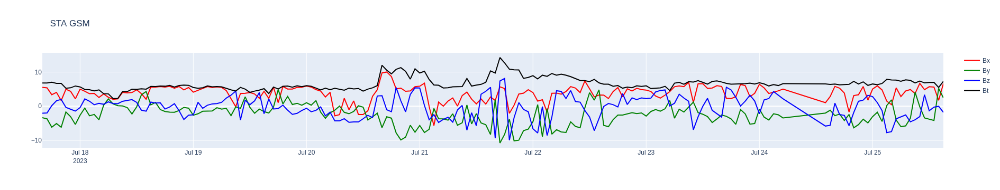

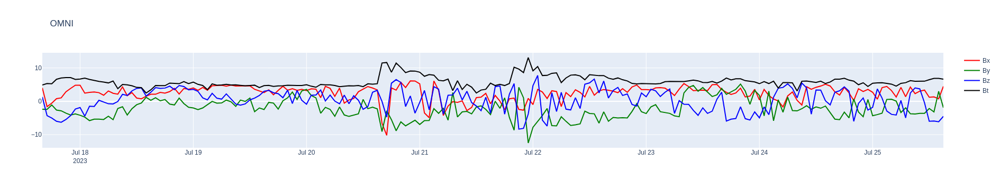

Event:  9


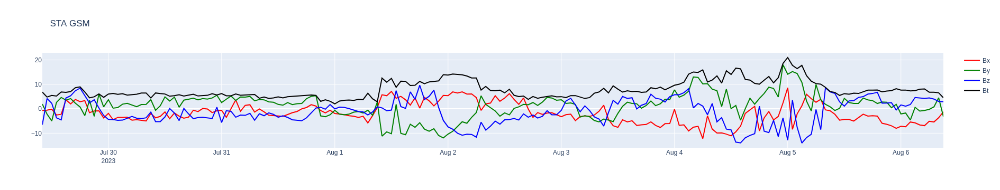

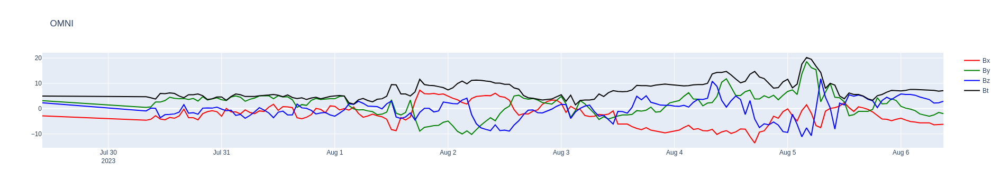

Event:  10


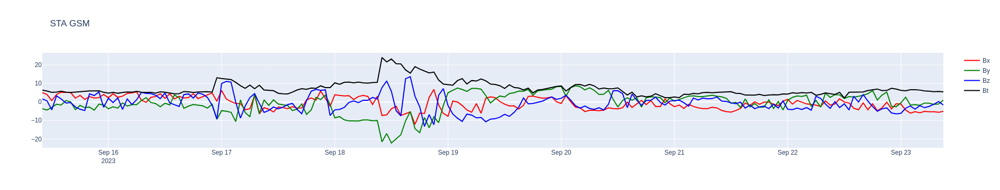

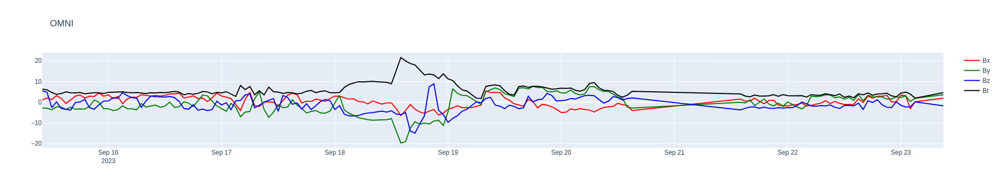

Event:  11


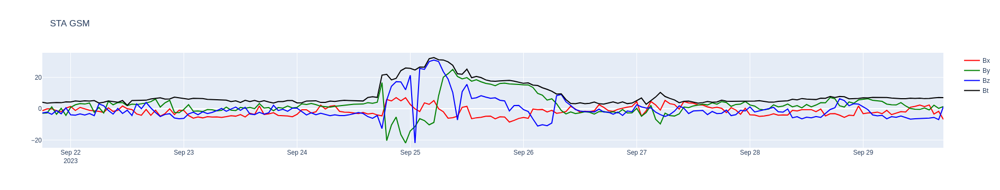

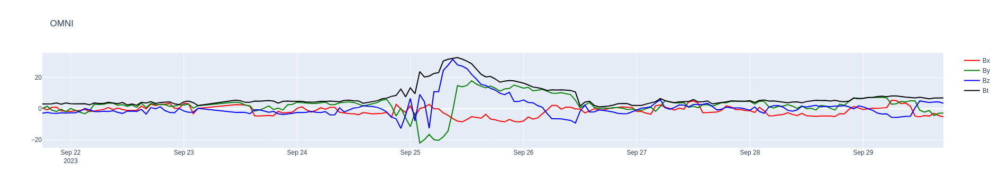

Event:  12


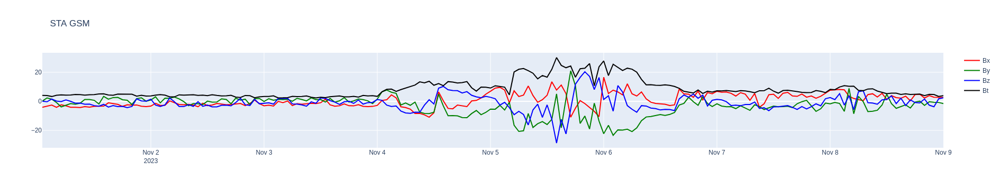

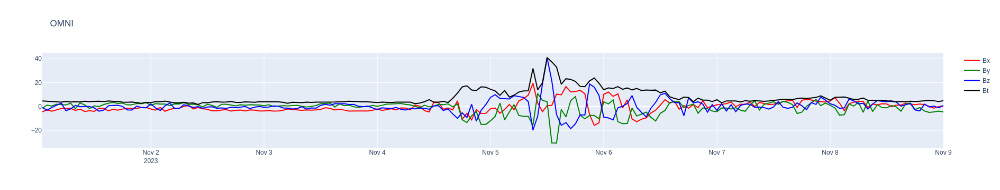

In [23]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import plotly.io as pio
from plotly.offline import iplot, init_notebook_mode
import plotly.express as px

nrows=1

for i in range(len(all0)):
    print('Event: ', i+1)

    fig1 = make_subplots(rows=nrows, cols=1, shared_xaxes=True)

    fig1.add_trace(go.Scatter(x=mdates.num2date(all0[i]['time']), y=all0[i]['bx'], name='Bx',line_color='red'), row=1, col=1)
    fig1.add_trace(go.Scatter(x=mdates.num2date(all0[i]['time']), y=all0[i]['by'], name='By',line_color='green'), row=1, col=1)
    fig1.add_trace(go.Scatter(x=mdates.num2date(all0[i]['time']), y=all0[i]['bz'], name='Bz',line_color='blue'), row=1, col=1)
    fig1.add_trace(go.Scatter(x=mdates.num2date(all0[i]['time']), y=all0[i]['btot'], name='Bt',line_color='black'), row=1, col=1)

    fig1.update_layout(title='STA GSM')

    fig1.show()


    fig2 = make_subplots(rows=nrows, cols=1, shared_xaxes=True)

    fig2.add_trace(go.Scatter(x=mdates.num2date(omni_all[i]['time']), y=omni_all[i]['bx'], name='Bx',line_color='red'), row=1, col=1)
    fig2.add_trace(go.Scatter(x=mdates.num2date(omni_all[i]['time']), y=omni_all[i]['by'], name='By',line_color='green'), row=1, col=1)
    fig2.add_trace(go.Scatter(x=mdates.num2date(omni_all[i]['time']), y=omni_all[i]['bz'], name='Bz',line_color='blue'), row=1, col=1)
    fig2.add_trace(go.Scatter(x=mdates.num2date(omni_all[i]['time']), y=omni_all[i]['btot'], name='Bt',line_color='black'), row=1, col=1)

    fig2.update_layout(title='OMNI')

    fig2.show()

    #fig3 = make_subplots(rows=nrows, cols=1, shared_xaxes=True)

    #for column, color in zip(['b_x', 'b_y', 'b_z', 'b_tot'], ['red', 'green', 'blue', 'black']):
    #fig3.add_trace(go.Scatter(x=pers_all[i]['time'], y=pers_all[i]['bx'], name='Bx',line_color='red'), row=1, col=1)
    #fig3.add_trace(go.Scatter(x=pers_all[i]['time'], y=pers_all[i]['by'], name='By',line_color='green'), row=1, col=1)
    #fig3.add_trace(go.Scatter(x=pers_all[i]['time'], y=pers_all[i]['bz'], name='Bz',line_color='blue'), row=1, col=1)
    #fig3.add_trace(go.Scatter(x=pers_all[i]['time'], y=pers_all[i]['btot'], name='Bt',line_color='black'), row=1, col=1)

    #fig3.update_layout(title='PERSISTENCE')

    #fig.write_html(f'/Users/chris/python/heliocats/measure.html')
    #fig3.show()

In [24]:
# Shift wind from sub-L1 to L1 to account for orbital distance and areal expansion:
# NOTE: To check influence of this scaling, just uncomment this line and compare results
for i in range(len(all0)):
    all0[i].shift_wind_to_L1(omni_all[i].pos)
    #all1[i].shift_wind_to_L1(omni_all[i].pos)
    #all2[i].shift_wind_to_L1(omni_all[i].pos)
#print(stah_0)
#print(omni_0)

In [26]:
# Shift time from current STA position to L1
all1 = []
all2 = []
for i in range(len(all0)):
    #t_unmapped = copy.deepcopy(all0[i]['time'])
    #stah = stah.shift_time_to_L1(method='new', sun_syn=t_pers, L1Pos=omni_1.pos)
    all0[i]['time'] = all0[i]['time'] + time_shift_hours[i]/24.
    all1_single = copy.deepcopy(all0[i])
    all1_single['time'] = all1_single['time'] + time_shift_err0[i]/24.
    all1.append(all1_single)
    all2_single = copy.deepcopy(all0[i])
    all2_single['time'] = all2_single['time'] + time_shift_err1[i]/24.
    all2.append(all2_single)
    
    # Keep unmapped/mapped time arrays to know which actual time maps to which shifted time
    #t_mapped = copy.deepcopy(all0[i]['time'])
    #print(time_shift_hours[i])
    #if use_stereo_beacon:
    #stah = stah.make_hourly_data()
    #else: # time ranges don't match for L2 data, this makes it easier:
    #all0[i] = all0[i].interp_to_time(omni_all[i]['time'])
    #all1[i] = all1[i].interp_to_time(omni_all[i]['time'])
    
    #all2[i] = all2[i].interp_to_time(omni_all[i]['time'])
    #pers = pers.interp_to_time(omni_1['time'])
#stbh.load_positions()
print(all0[0], all1[0])

Length of data:		192
Keys in data:		['speed', 'density', 'temp', 'btot', 'br', 'bt', 'bn', 'bx', 'by', 'bz', 'time']
First data point:	2020-04-16 20:15:34.531788+00:00
Last data point:	2020-04-24 19:15:34.531788+00:00

Header information:
                   DataSource:	SolarOrbiter L2
                    SourceURL:	
                 SamplingRate:	1:00:00
               ReferenceFrame:	GSM
                  FileVersion:	{}
                  Instruments:	[]
                 RemovedTimes:	[]
          PlasmaDataIntegrity:	10
             CoordinateSystem:	rlonlat

Variable statistics:
         VAR        MEAN         STD
       speed      297.07        0.00
     density        6.88        0.23
        temp    37563.46        0.00
        btot        5.44        3.24
          br       -1.84        1.90
          bt        1.61        4.60
          bn       -0.14        3.26
          bx        1.76        1.96
          by       -1.56        3.96
          bz       -0.84        3.92
    

Event:  1


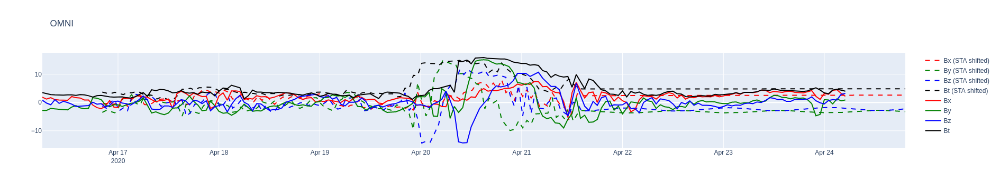

Event:  2


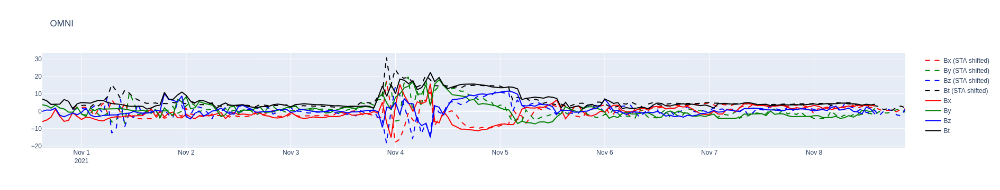

Event:  3


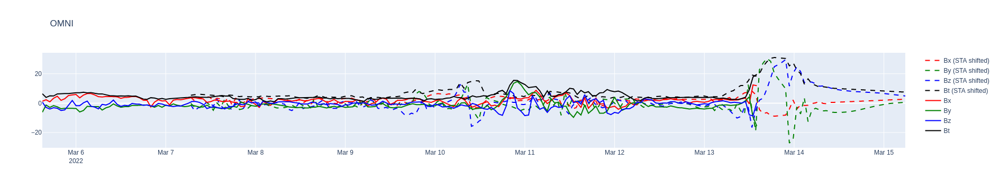

Event:  4


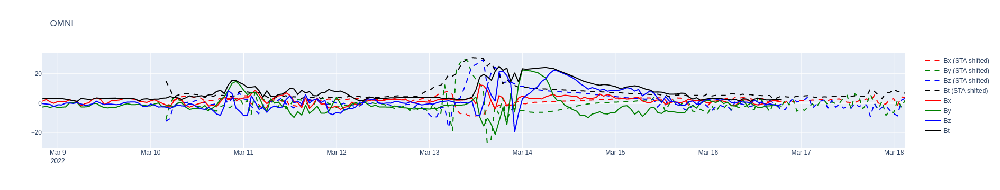

Event:  5


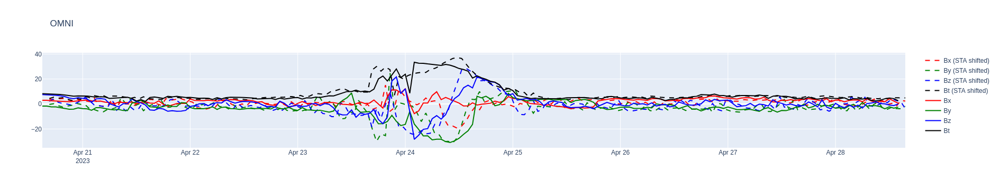

Event:  6


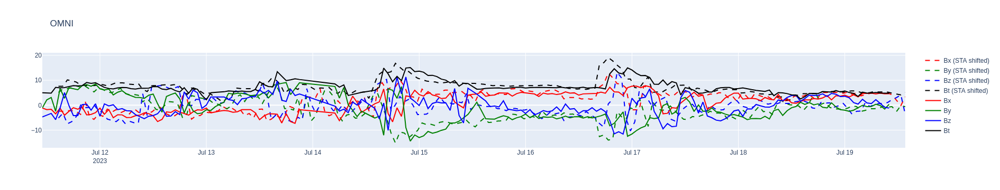

Event:  7


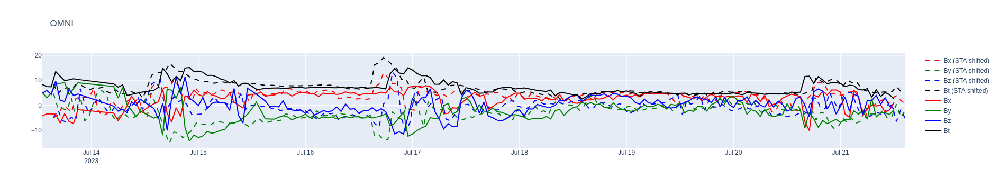

Event:  8


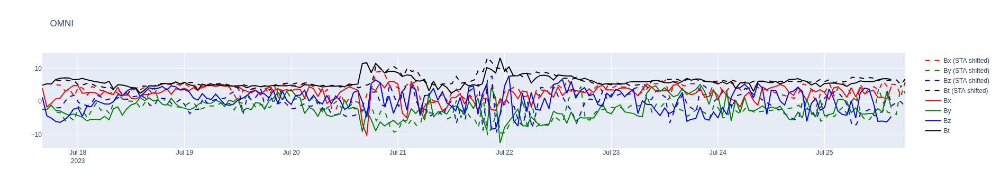

Event:  9


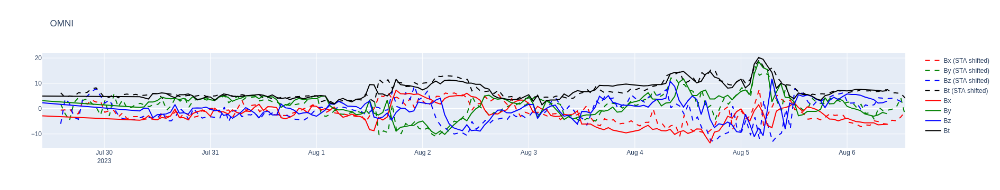

Event:  10


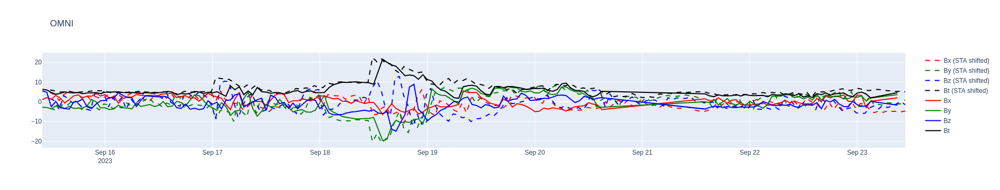

Event:  11


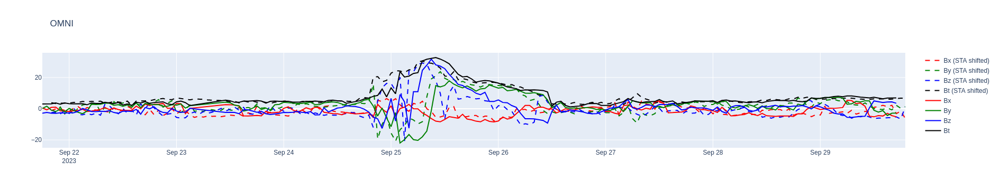

Event:  12


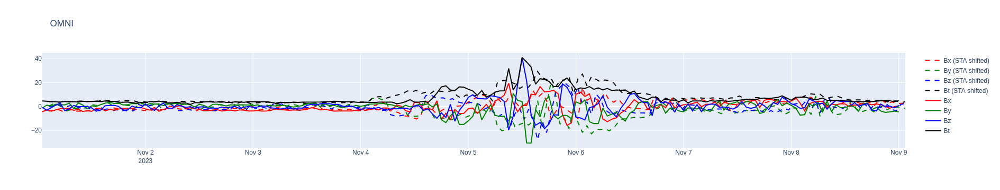

In [27]:
nrows=1

for i in range(len(all0)):

    print('Event: ', i+1)
    
    fig = make_subplots(rows=nrows, cols=1, shared_xaxes=True)

    #for column, color in zip(['b_x', 'b_y', 'b_z', 'b_tot'], ['red', 'green', 'blue', 'black']):
    fig.add_trace(go.Scatter(x=mdates.num2date(all0[i]['time']), y=all0[i]['bx'], name='Bx (STA shifted)', line=dict(color='red', width=2,
                                  dash='dash')), row=1, col=1)
    fig.add_trace(go.Scatter(x=mdates.num2date(all0[i]['time']), y=all0[i]['by'], name='By (STA shifted)', line=dict(color='green', width=2,
                                  dash='dash')), row=1, col=1)
    fig.add_trace(go.Scatter(x=mdates.num2date(all0[i]['time']), y=all0[i]['bz'], name='Bz (STA shifted)', line=dict(color='blue', width=2,
                                  dash='dash')), row=1, col=1)
    fig.add_trace(go.Scatter(x=mdates.num2date(all0[i]['time']), y=all0[i]['btot'], name='Bt (STA shifted)', line=dict(color='black', width=2,
                                  dash='dash')), row=1, col=1)

    #fig.add_trace(go.Scatter(x=stah_1['time'], y=stah_1['bx'], name='Bx (STA shifted)', line=dict(color='red', width=2,
    #                              dash='dash')), row=1, col=1)
    #fig.add_trace(go.Scatter(x=stah_1['time'], y=stah_1['by'], name='By (STA shifted)', line=dict(color='green', width=2,
    #                              dash='dash')), row=1, col=1)
    #fig.add_trace(go.Scatter(x=stah_1['time'], y=stah_1['bz'], name='Bz (STA shifted)', line=dict(color='blue', width=2,
    #                              dash='dash')), row=1, col=1)
    #fig.add_trace(go.Scatter(x=stah_1['time'], y=stah_1['btot'], name='Bt (STA shifted)', line=dict(color='black', width=2,
    #                              dash='dash')), row=1, col=1)

    fig.add_trace(go.Scatter(x=mdates.num2date(omni_all[i]['time']), y=omni_all[i]['bx'], name='Bx',line_color='red'), row=1, col=1)
    fig.add_trace(go.Scatter(x=mdates.num2date(omni_all[i]['time']), y=omni_all[i]['by'], name='By',line_color='green'), row=1, col=1)
    fig.add_trace(go.Scatter(x=mdates.num2date(omni_all[i]['time']), y=omni_all[i]['bz'], name='Bz',line_color='blue'), row=1, col=1)
    fig.add_trace(go.Scatter(x=mdates.num2date(omni_all[i]['time']), y=omni_all[i]['btot'], name='Bt',line_color='black'), row=1, col=1)

    fig.update_layout(title='OMNI')

    fig.show()

In [28]:
# Calculate model Dst
print(sklearn.__version__)

for i in range(len(all0)):

    all0[i]['dst'] = all0[i].make_dst_prediction(method='temerin_li_2006', t_correction=True)['dst']
    all1[i]['dst'] = all1[i].make_dst_prediction(method='temerin_li_2006', t_correction=True)['dst']
    all2[i]['dst'] = all2[i].make_dst_prediction(method='temerin_li_2006', t_correction=True)['dst']
    # (Use 'ae' to not overwrite OMNI Kyoto Dst values)
    omni_all[i]['ae'] = omni_all[i].make_dst_prediction(method='temerin_li_2006', t_correction=True)['dst']
    pers_all[i]['dst'] = pers_all[i].make_dst_prediction(method='temerin_li_2006', t_correction=True)['dst']
# Apply correction using formerly-trained GradientBoostingRegressor (sklearn) model:
# (This model provides a correction to the original Temerin-Li output as an enhancement.)

#with open('dst_pred_model_2023-05-04.pickle', 'rb') as f:
#    model = pickle.load(f)
#print(model.__getstate__()['_sklearn_version'])
 #   dstdiff_pred = stah.make_dst_prediction_from_model(model)['dst']
 #   dstdiff_pred_omni = omni_1.make_dst_prediction_from_model(model)['dst']
 #   dstdiff_pred_pers = pers.make_dst_prediction_from_model(model)['dst']
 #   stah['dst'] += dstdiff_pred
 #   omni_1['ae'] += dstdiff_pred_omni
 #   pers['dst'] += dstdiff_pred_pers

print('done')

0.20.3
done


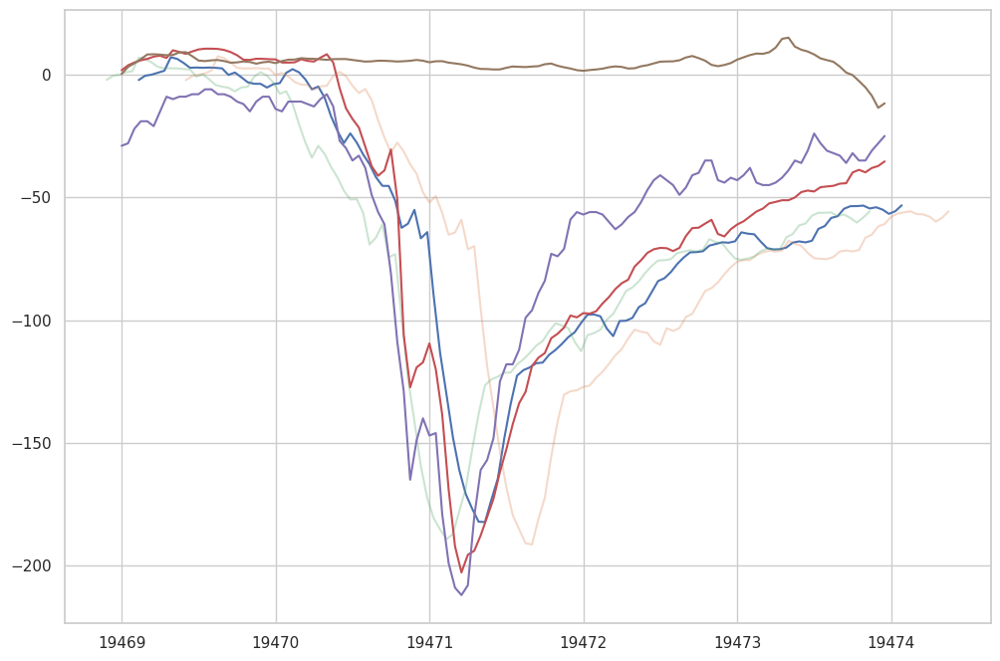

In [37]:
#Plot Dst 

plt.figure(1, figsize=(12,8))
plt.plot(stah_0['time'], stah_0['dst'])
plt.plot(stah_1['time'], stah_1['dst'], alpha=0.3)
plt.plot(stah_2['time'], stah_2['dst'], alpha=0.3)
#plt.fill_between(x=stah_0['dst'], y1=stah_2['time'], y2=stah_1['time'])
#plt.errorbar(stah_0['time'], stah_0['dst'], xerr=stah_1['time']-stah_2['time'], alpha=.3)
plt.plot(omni_0['time'], omni_0['ae'])
plt.plot(omni_0['time'], omni_0['dst'])
plt.plot(pers['time'], pers['dst'])
#plt.plot(stah['time'], stah['dst'])

### Cut data to time range

Data is prepared, so cut to final time range, save results for statistical comparison and continue with data analysis.

In [26]:
# Final cut
stime_new = num2date(max((omni_['time'][0], stah['time'][0], pers['time'][0])))
etime_new = num2date(min((omni_['time'][-1], stah['time'][-1], pers['time'][-1])))
print()

print('Time range correction after time shift:')
print('start:', stime_new)
print('end:  ', etime_new)

stbh = stah.cut(starttime=stime_new, endtime=etime_new)
omni = omni_.cut(starttime=stime_new, endtime=etime_new)
pers = pers.cut(starttime=stime_new, endtime=etime_new)
print("After cut:", len(omni), len(stbh), len(pers))


Time range correction after time shift:
start: 2023-04-22 05:00:00+00:00
end:   2023-04-26 23:00:00+00:00
After cut: 114 119 114


### Save / load pickled objects

Reading takes a while, so pickle the processed files for reading on the next run.

In [17]:
pickle_path_s = 'data/stb_satdata_h_proc.p'
with open(pickle_path_s, 'wb') as pickle_file_s:
    pickle.dump(stbh, pickle_file_s)
pickle_path_o = 'data/omni_satdata_h_proc.p'
with open(pickle_path_o, 'wb') as pickle_file_o:
    pickle.dump(omni, pickle_file_o)
pickle_path_p = 'data/pers_satdata_h_proc.p'
with open(pickle_path_p, 'wb') as pickle_file_p:
    pickle.dump(pers, pickle_file_p)
pickle_path_m = 'data/mapping_arrays.p'
mapping_arrays = [t_unmapped, t_mapped, stbh_lats, stbh_lons]
with open(pickle_path_m, 'wb') as pickle_file_m:
    pickle.dump(mapping_arrays, pickle_file_m)

In [18]:
# ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
# ||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||
# --------------------------------------------------------------------------
# **************************************************************************
#
# IF LOADING DATA OBJECTS FROM PICKLE FILES, SKIP ALL ABOVE
#
# **************************************************************************
# --------------------------------------------------------------------------

pickle_path_s = 'data/stb_satdata_h_proc.p'
pickle_path_o = 'data/omni_satdata_h_proc.p'
pickle_path_p = 'data/pers_satdata_h_proc.p'
pickle_path_m = 'data/mapping_arrays.p'
stbh = pickle.load(open(pickle_path_s, 'rb'))
omni = pickle.load(open(pickle_path_o, 'rb'))
pers = pickle.load(open(pickle_path_p, 'rb'))
[t_unmapped, t_mapped, stbh_lats, stbh_lons] = pickle.load(open(pickle_path_m, 'rb'))

In [23]:
omni = omni_
omni_mean, omni_std = copy.deepcopy(omni), copy.deepcopy(omni)
stah_mean, stah_std = copy.deepcopy(stah), copy.deepcopy(stah)
pers_mean, pers_std = copy.deepcopy(pers), copy.deepcopy(pers)
for sw_var in ['speed', 'btot', 'bx', 'by', 'bz']:
    for i in range(mean_range, len(stbh)-mean_range):
        omni_mean[sw_var][i] = np.nanmean(omni[sw_var][i-mean_range:i+mean_range])
        omni_std[sw_var][i] = np.nanstd(omni[sw_var][i-mean_range:i+mean_range])
        stah_mean[sw_var][i] = np.nanmean(stbh[sw_var][i-mean_range:i+mean_range])
        stah_std[sw_var][i] = np.nanstd(stah[sw_var][i-mean_range:i+mean_range])
        pers_mean[sw_var][i] = np.nanmean(pers[sw_var][i-mean_range:i+mean_range])
        pers_std[sw_var][i] = np.nanstd(pers[sw_var][i-mean_range:i+mean_range])

NameError: name 'mean_range' is not defined

### Make plot of data set


That's it.

Event:  1


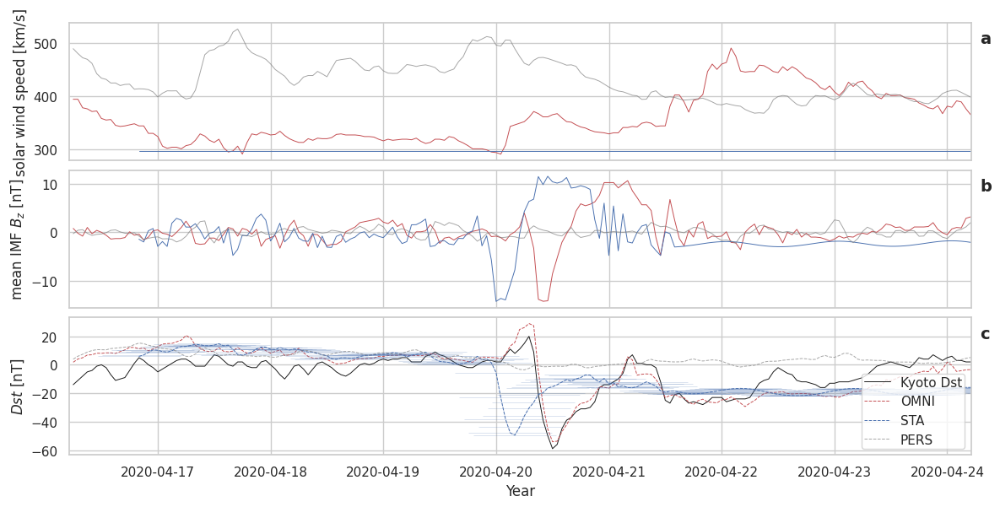

Event:  2


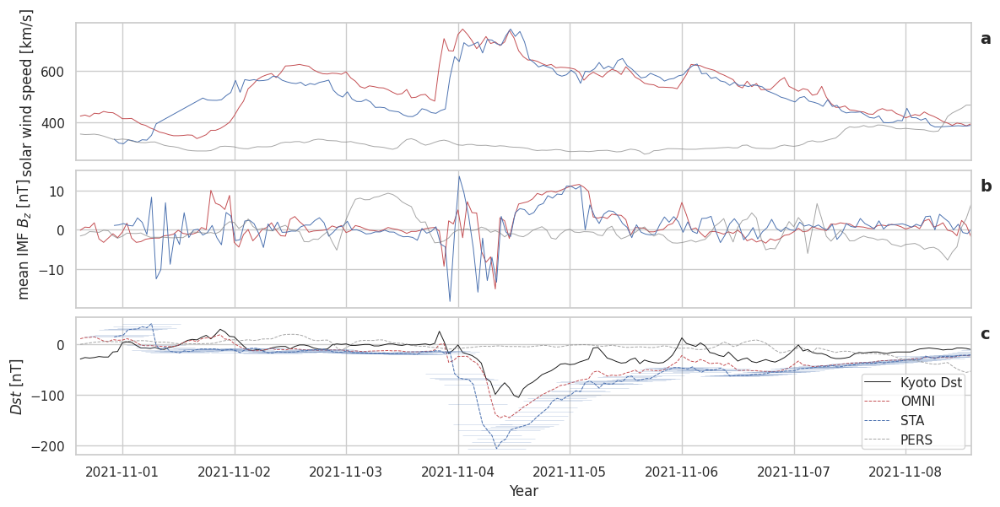

Event:  3


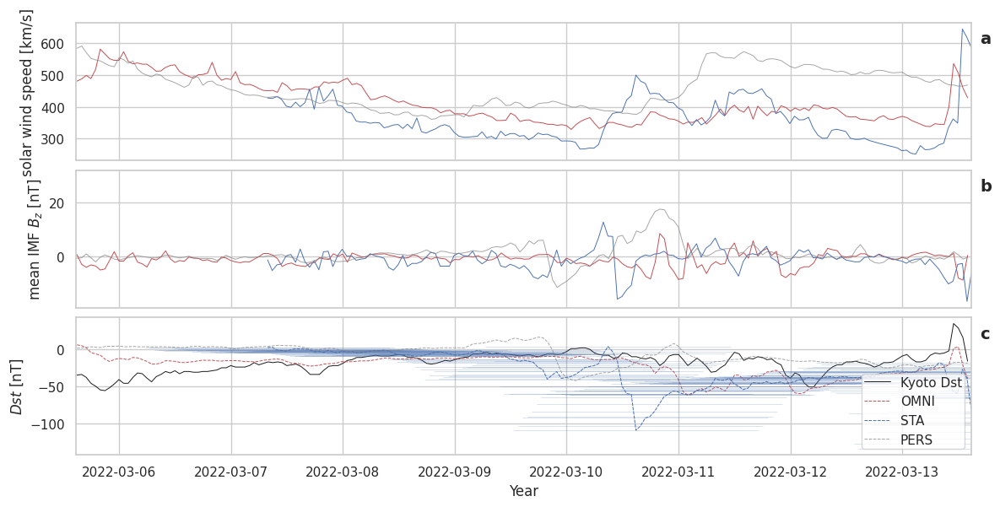

Event:  4


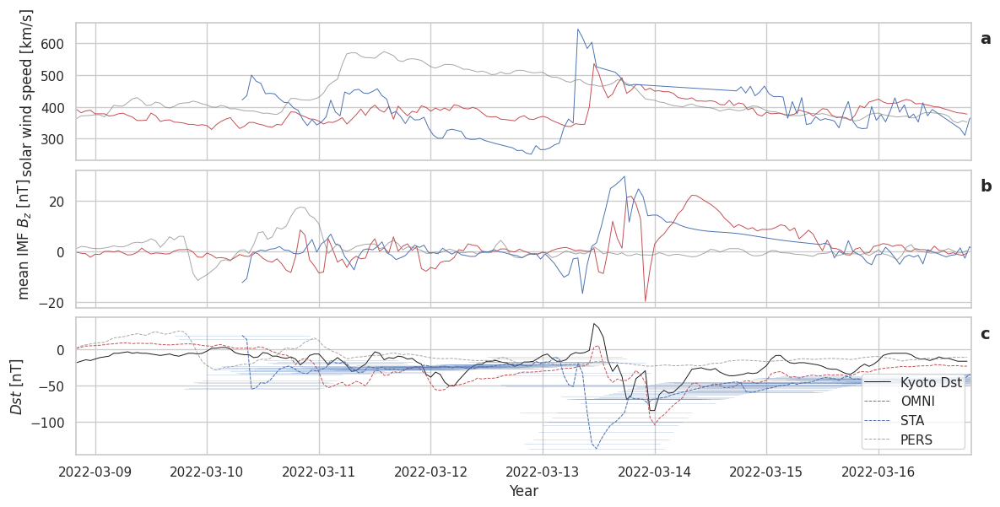

Event:  5


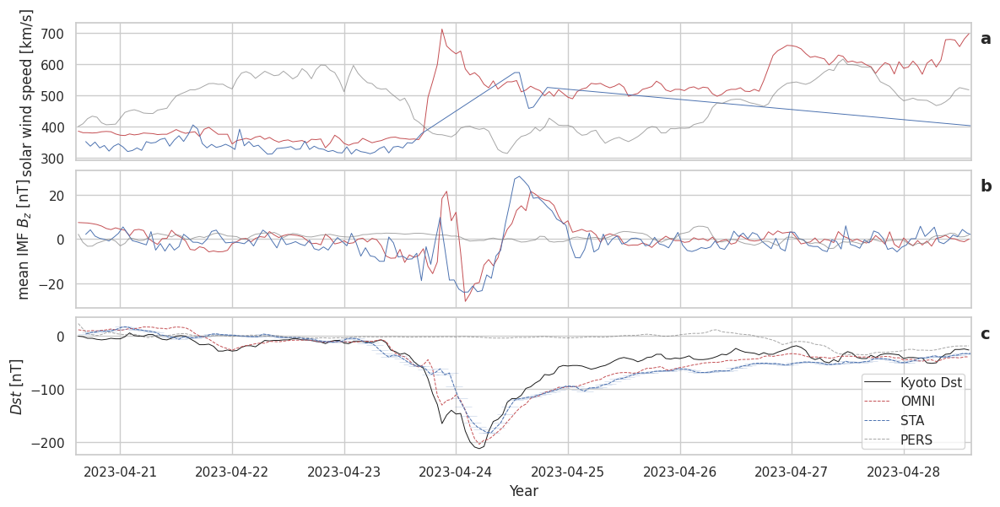

Event:  6


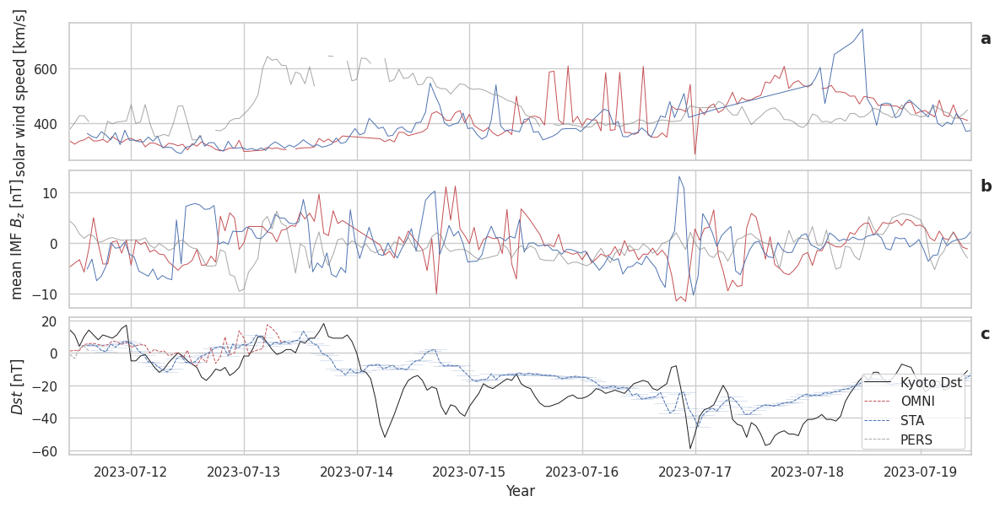

Event:  7


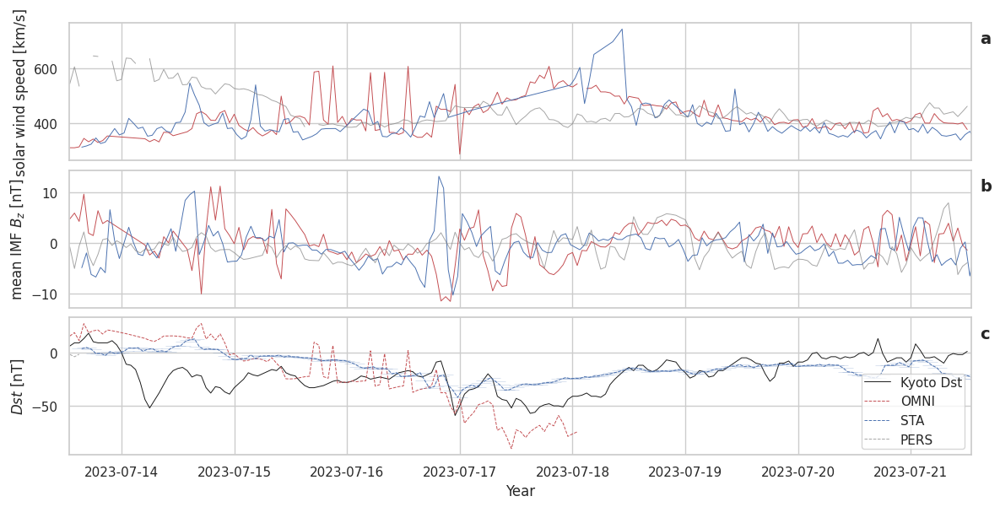

Event:  8


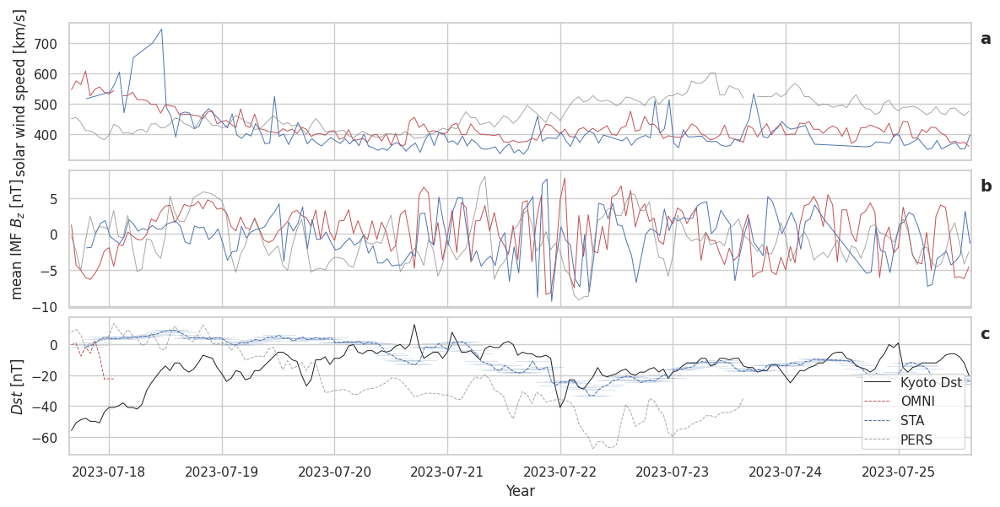

Event:  9


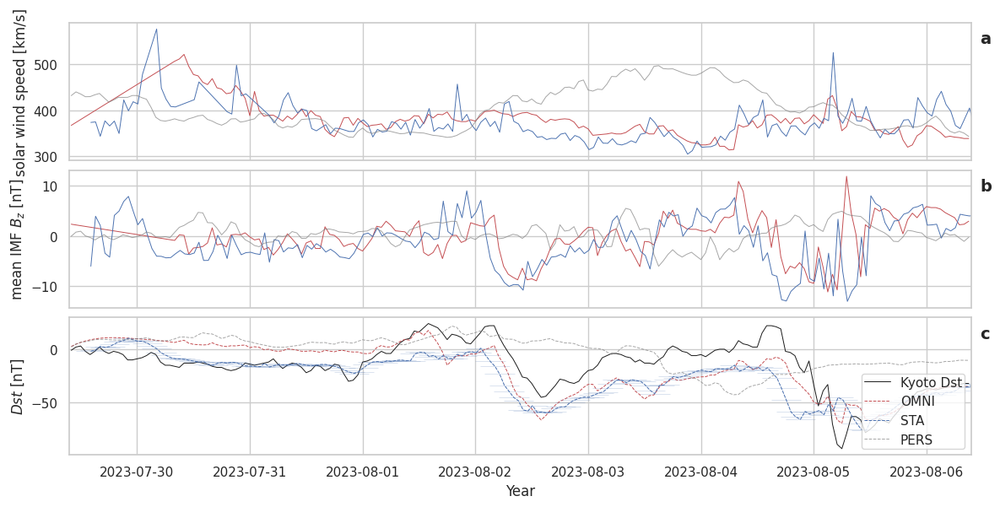

Event:  10


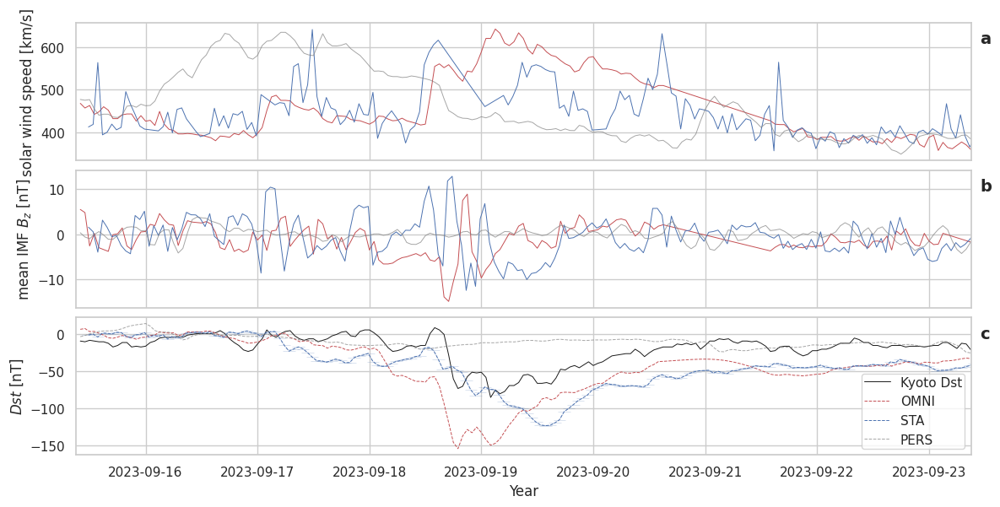

Event:  11


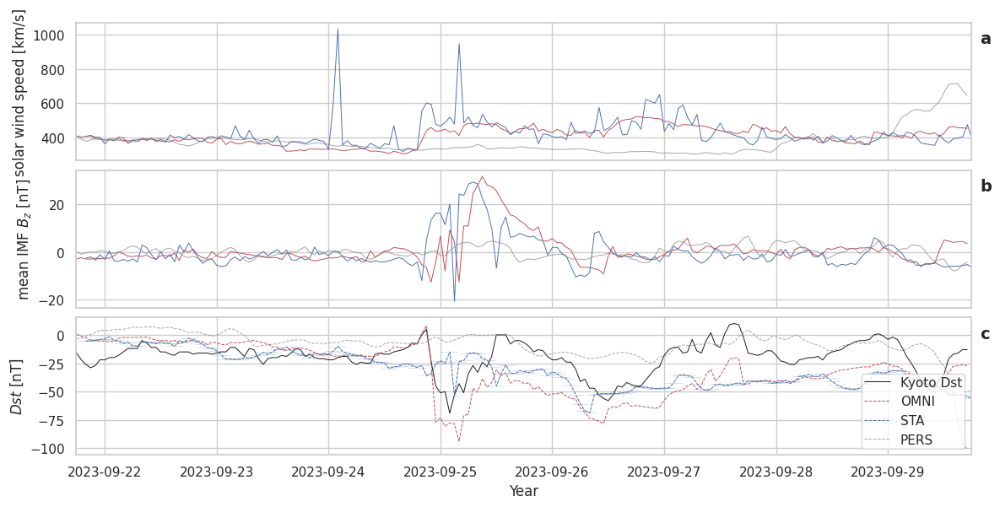

Event:  12


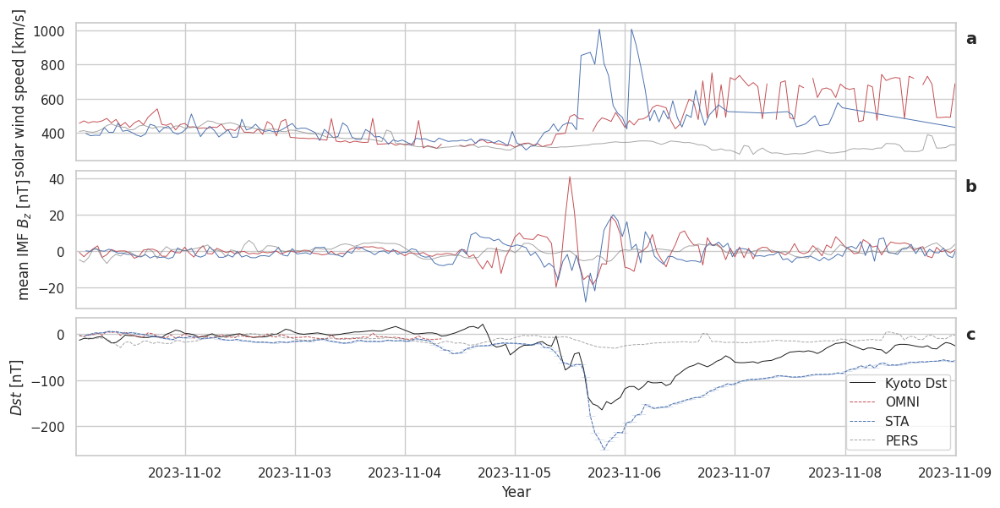

In [280]:
for i in range(len(all0)):
    
    print('Event: ', i+1)

    omni_mean, omni_std = copy.deepcopy(omni_all[i]), copy.deepcopy(omni_all[i])
    stah_mean, stah_std = copy.deepcopy(all0[i]), copy.deepcopy(all0[i])
    pers_mean, pers_std = copy.deepcopy(pers_all[i]), copy.deepcopy(pers_all[i])

    nfig += 1
    main_lw = 0.7
    fig, (ax1, ax2, ax3) = plt.subplots(3, 1, num=nfig, figsize=(figwidth,6), sharex=True)
    ax1.plot_date(omni_all[i]['time'], omni_all[i]['speed'], '-', c=modc['omni'], lw=main_lw, label="OMNI")
    ax1.plot_date(all0[i]['time'], all0[i]['speed'], '-', c=modc['sta'], lw=main_lw, label="STA")
    ax1.plot_date(pers_all[i]['time'], pers_all[i]['speed'], '-', c=modc['pers'], alpha=alpha_pers, lw=main_lw, label="PERS")
    #ax2.plot_date(omni['time'], omni['bz'], '-', c=modc['omni'], lw=0.3, alpha=0.3)
    ax2.plot_date(omni_all[i]['time'], omni_mean['bz'], '-', c=modc['omni'], lw=main_lw, label="OMNI")
    #ax2.plot_date(stbh['time'], stbh['bz'], '-', c=modc['stb'], lw=0.3, alpha=0.3)
    ax2.plot_date(all0[i]['time'], stah_mean['bz'], '-', c=modc['sta'], lw=main_lw, label="STB")
    ax2.plot_date(pers_all[i]['time'], pers_mean['bz'], '-', c=modc['pers'], alpha=alpha_pers, lw=main_lw, label="PERS")
    ax3.plot_date(omni_all[i]['time'], omni_all[i]['dst'], 'k-', lw=main_lw, label='Kyoto Dst')
    ax3.plot_date(omni_all[i]['time'], omni_all[i]['ae'], '--', c=modc['omni'], lw=main_lw, label='OMNI')
    ax3.plot_date(all0[i]['time'], all0[i]['dst'], '--', c=modc['sta'], lw=main_lw, label='STA')
    ax3.errorbar(all0[i]['time'], all0[i]['dst'], xerr=all1[i]['time']-all2[i]['time'], lw=main_lw, alpha=0.2)
    #ax3.plot_date(err_time0, stah['dst'], '--', c=modc['sta'], lw=main_lw, label='STA', alpha=0.3)
    #ax3.plot_date(err_time1, stah['dst'], '--', c=modc['sta'], lw=main_lw, label='STA', alpha=0.3)
    ax3.plot_date(pers_all[i]['time'], pers_all[i]['dst'], '--', c=modc['pers'], alpha=alpha_pers, lw=main_lw, label='PERS')
    #ax1.set_title('Solar wind speed, magnetic field and $Dst$ while STEREO-B at L5 ($-60 \pm 10^{\circ}$) point')

    angle_bracket_reduced = [-50, -70]
    #min_time = np.round(stah['time'][np.where(stah.pos['lon']*180/np.pi < angle_bracket_reduced[0])[0][0]], 0)
    #max_time = np.round(stah['time'][np.where(stah.pos['lon']*180/np.pi < angle_bracket_reduced[1])[0][0]], 0)
    ax1.set_xlim((min_time[i], max_time[i]))
    #ax1.set_ylim((230,650))
    #ax1.legend(loc="upper left", borderpad=0.2)
    ax1.set_ylabel("solar wind speed [km/s]")
    ax2.set_xlim((min_time[i], max_time[i]))
    #ax2.set_ylim((-10, 10))
    ax2.set_ylabel("mean IMF $B_{z}$ [nT]")
    ax3.set_xlim((min_time[i], max_time[i]))
    #ax3.set_ylim((-55,25))
    ax3.set_xlabel('Year')
    ax3.set_ylabel("$Dst$ [nT]")
    ax3.legend(loc="lower right", borderpad=0.2)
    for ax, ann in zip([ax1, ax2, ax3], ['a', 'b', 'c']):
        ax.text(1.01, 0.85, ann, transform=ax.transAxes, fontsize=14, weight='bold')
    plt.tight_layout()
    plt.subplots_adjust(hspace=0.07)
    plt.savefig("Plots/Dst_event_"+str(i+1)+".pdf")
    plt.show()

### Make plot of density curves of Dst

That's also it.

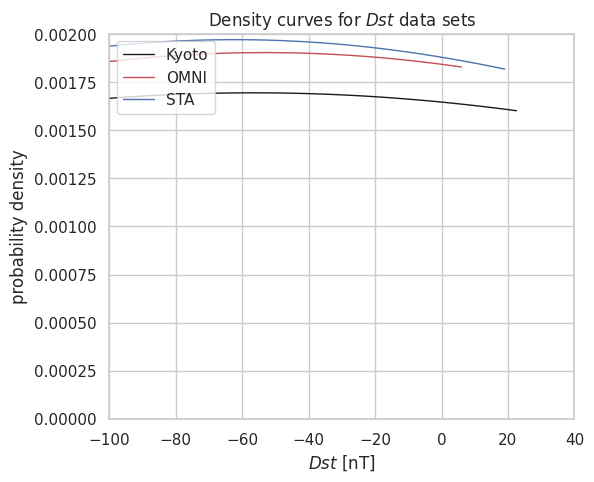

In [43]:
bw = 4
lw = 1
fig = plt.figure(figsize=figsize_half)
ax1 = sns.kdeplot(omni_0['ae'], bw=bw, color='k', lw=lw, label="Kyoto")
ax1 = sns.kdeplot(omni_0['dst'], bw=bw, color=modc['omni'], lw=lw, label="OMNI")
ax1 = sns.kdeplot(stah_0['dst'], bw=bw, color=modc['sta'], lw=lw, label="STA")
#ax1 = sns.kdeplot(pers['dst'], bw=bw, color=modc['pers'], alpha=alpha_pers, lw=lw, label="PERS")
plt.legend(loc="upper left")
plt.title("Density curves for $Dst$ data sets")
plt.xlim((-100,40))
plt.xlabel("$Dst$ [nT]")
plt.ylabel("probability density")
#plt.savefig("plots/density_curve.pdf")
plt.show()

## DATA ANALYSIS (FULL RANGE)

Some basic data preparation, and then...

1. Correlation of variables speed/magn. field as STEREO-B moves away from the Earth
2. Dst accuracy depending on L5-L1 longitude angle diff
3. Analysis of values according to Carrington rotation
4. Dst accuracy depending on L5-L1 latitude diff
5. Event-based analysis with 12-hour windows

In [22]:
# Remove all nans (= ICMEs)
print("With all data:     ", len(omni), len(stbh), len(pers))
before_icmes = len(omni)
# Get new locations for lon & lat
# (These are the original lat/lon variables for STB's location mapped to the new shifted times
# so that the positions match up to the solar wind variables, but not necessarily to the time.)
stbh_lats = np.interp(stbh['time'], t_mapped, stbh_lats)
stbh_lons = np.interp(stbh['time'], t_mapped, stbh_lons)
stbh_lats = stbh_lats[~np.isnan(omni.data[1])]
stbh_lons = stbh_lons[~np.isnan(omni.data[1])]
omni = omni.remove_nans()
stbh = stbh.remove_nans()
pers = pers.remove_nans()
stbh_mean, stbh_std = stbh_mean.remove_nans(), stbh_std.remove_nans()
omni_mean, omni_std = omni_mean.remove_nans(), omni_std.remove_nans()
stb2 = heliosat.STB()
stbh.load_positions()
print("Removed NaNs/ICMES:", len(omni), len(stbh), len(pers))
print("Len of mean arrays:", len(omni_mean), len(stbh_mean), len(stbh_std))
after_icmes = len(omni)
print("Data set has been reduced by {:.1f}% in size.".format(100.*(before_icmes-after_icmes)/before_icmes))

With all data:      42529 42529 42529
Removed NaNs/ICMES: 37745 37745 37745
Len of mean arrays: 38307 38307 38307
Data set has been reduced by 11.2% in size.


In [23]:
# Get model Dst
dst_temerinli_omni = omni['ae']
dst_temerinli_pers = pers['dst']
dst_temerinli = stbh['dst']
# Actual Dst for interval
odst = omni['dst']

print("Mean, Min and Max:")
for ndata, data in zip(['Kyoto', 'OMNI', 'STB', 'PERS'],[odst, dst_temerinli_omni, 
                                                         dst_temerinli, dst_temerinli_pers]):
    print("{}:\t{:.2f}\t-- {:.2f}\t-- {:.2f}".format(ndata, np.nanmean(data), np.nanmin(data), np.nanmax(data)))

Mean, Min and Max:
Kyoto:	-7.49	-- -118.00	-- 44.00
OMNI:	-7.25	-- -140.38	-- 39.91
STB:	-7.28	-- -172.16	-- 37.36
PERS:	-5.38	-- -164.96	-- 38.24


In [24]:
# Print some statistics:
print("DST DIFF (PRED-OBS) MEAN AND STANDARD DEVIATION")
print("-----------------------------------------------")
print("")
sd_omni = get_statistics(dst_temerinli_omni, odst, source='L1')
sd_stb = get_statistics(dst_temerinli, odst, source='STEREO-B')
sd_pers = get_statistics(dst_temerinli_pers, odst, source='PERSISTENCE MODEL')

DST DIFF (PRED-OBS) MEAN AND STANDARD DEVIATION
-----------------------------------------------

DATA FROM L1
------------
Dst diff mean +/- std: -0.24 +/- 5.04

Dst obs  mean +/- std: -7.49 +/- 11.53
Dst pred mean +/- std: -7.25 +/- 11.47
Dst obs  min / max: -118.00 / 44.00
Dst pred min / max: -140.38 / 39.91

Pearson correlation: 0.90 
Cross-correlation:   0.0 hours
Mean absolute error: 3.89 nT
RMSE:                5.04 nT

DATA FROM STEREO-B
------------------
Dst diff mean +/- std: -0.21 +/- 12.25

Dst obs  mean +/- std: -7.49 +/- 11.53
Dst pred mean +/- std: -7.28 +/- 11.04
Dst obs  min / max: -118.00 / 44.00
Dst pred min / max: -172.16 / 37.36

Pearson correlation: 0.41 
Cross-correlation:   -2.3 hours
Mean absolute error: 8.40 nT
RMSE:                12.25 nT

DATA FROM PERSISTENCE MODEL
---------------------------
Dst diff mean +/- std: -2.11 +/- 13.42

Dst obs  mean +/- std: -7.49 +/- 11.53
Dst pred mean +/- std: -5.38 +/- 11.30
Dst obs  min / max: -118.00 / 44.00
Dst pred min

In [25]:
# Save data to file for event-based analysis:
savearray = np.vstack((omni['time'], odst, dst_temerinli_omni, dst_temerinli, dst_temerinli_pers,
                       omni['speed'], stbh['speed'], pers['speed'])).T
fileheader = "time dst_kyoto dst_l1 dst_stb dst_pers v_l1 v_stb v_pers"
np.savetxt("results/dst_data_all.txt", savearray, fmt="%.5f", header=fileheader)

### Correlation of variables speed/magn. field as STEREO-B moves away from the Earth

Notes:
- The correlation in solar wind speed stays around 0.97 for dlon<5 deg, and drops to around 0.9 after that, showing that we are definitely seeing the same solar wind structures in both data sets. The magnetic field values are lower, starting at 0.7 and dropping off quickly. The correlation value for Bz drops off the fastest, reaching a correlation of 0.0 at dlon=-4.
- The correlation between total magnetic field values remains high, even at 0.6-0.7 at dlon=-10, showing that the same structures are still present even if the exact field rotation is different.
- For a sanity check we evaluated the cross-correlation of all variables at each slice of time. The offset with the highest correlation in the solar wind speed was always at dt=0, while values in the magnetic field components tended to vary around dt=0.

In [26]:
# LOOK AT VARIABLES BETWEEN -0 AND -10 LONS
# Verifying that the coordinate systems between STEREO-B and OMNI do actually match for magnetic field measurements
step = -1
testangles = np.arange(0, -10, step)

dttime = [num2date(t).replace(tzinfo=None) for t in stbh['time']]

cc_vals_10 = {'lons': [], 'speed': [], 'btot': [], 'bx': [], 'by': [], 'bz': []}
for dtest in testangles:
    t_inds = np.where((stbh_lons*180/np.pi > (dtest+step)) & (stbh_lons*180/np.pi < dtest))
    cc_vals_10['lons'].append(dtest)
    #print('Data points inside {} < angle < {}: {}'.format((dtest+step), dtest, len(t_inds[0])))
    t = np.linspace(0.0, stbh['time'][t_inds][-1] - stbh['time'][t_inds][0], len(t_inds[0]), endpoint=False)
    dt = np.linspace(-t[-1], t[-1], 2*len(t_inds[0])-1)
    for varo in ['speed', 'btot', 'bx', 'by', 'bz']:
        cc_val = np.corrcoef(omni[varo][t_inds], stbh[varo][t_inds])[0][1]
        cc_vals_10[varo].append(cc_val)
        xcorr = scipy.signal.correlate(stbh[varo][t_inds], omni[varo][t_inds])
        hours_offset = 24.*dt[xcorr.argmax()]
        #print("{} -- corr: {:.2f} -- offset: {:.0f} hrs".format(varo, cc_val, hours_offset))

Time range covered for analysis in angle bracket [-0, -110]:
start: 2009-08-02 00:00:00+00:00
end:   2010-01-29 00:00:00+00:00

2007-03-19 22:00:00+00:00 2007-05-29 08:00:00+00:00
Data points inside -0.4 < angle < -3.5: 1595
speed -- corr:      0.99 -- offset: 0 hrs
speed -- corr_mean: 0.99 -- corr_std: 0.90
btot -- corr:      0.82 -- offset: 0 hrs
btot -- corr_mean: 0.90 -- corr_std: 0.70
bx -- corr:      0.64 -- offset: 0 hrs
bx -- corr_mean: 0.79 -- corr_std: 0.47
by -- corr:      0.66 -- offset: 0 hrs
by -- corr_mean: 0.80 -- corr_std: 0.62
bz -- corr:      0.47 -- offset: 0 hrs
bz -- corr_mean: 0.62 -- corr_std: 0.72


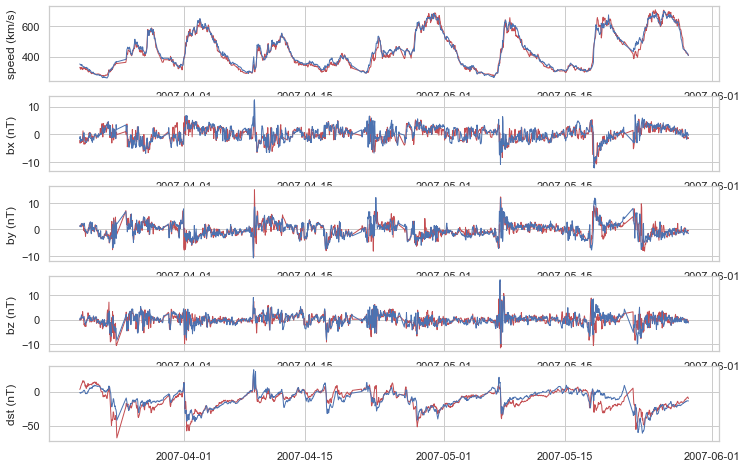

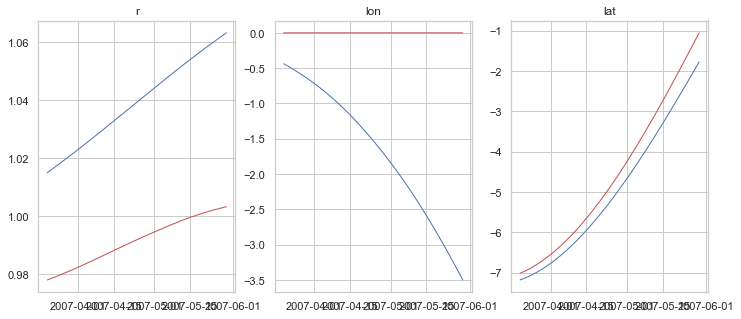

2007-03-19 22:00:00+00:00 2007-07-05 08:00:00+00:00
Data points inside -0.4 < angle < -6.5: 2442
speed -- corr:      0.97 -- offset: 0 hrs
speed -- corr_mean: 0.98 -- corr_std: 0.87
btot -- corr:      0.78 -- offset: 0 hrs
btot -- corr_mean: 0.86 -- corr_std: 0.61
bx -- corr:      0.59 -- offset: 0 hrs
bx -- corr_mean: 0.72 -- corr_std: 0.38
by -- corr:      0.62 -- offset: 0 hrs
by -- corr_mean: 0.75 -- corr_std: 0.50
bz -- corr:      0.40 -- offset: 0 hrs
bz -- corr_mean: 0.55 -- corr_std: 0.64


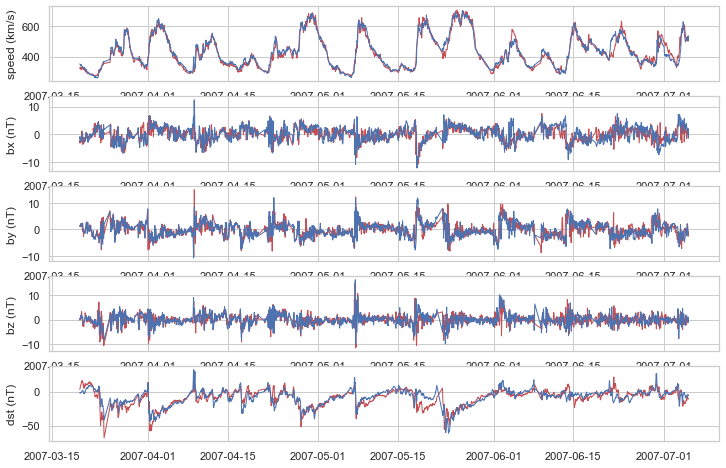

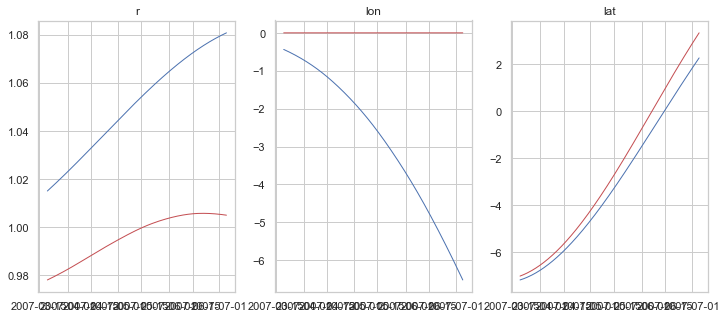

2007-05-13 11:00:00+00:00 2007-08-04 03:00:00+00:00
Data points inside -2.5 < angle < -9.5: 1898
speed -- corr:      0.95 -- offset: 0 hrs
speed -- corr_mean: 0.96 -- corr_std: 0.43
btot -- corr:      0.75 -- offset: 2 hrs
btot -- corr_mean: 0.81 -- corr_std: 0.45
bx -- corr:      0.58 -- offset: 1 hrs
bx -- corr_mean: 0.69 -- corr_std: 0.34
by -- corr:      0.53 -- offset: 1 hrs
by -- corr_mean: 0.65 -- corr_std: 0.36
bz -- corr:      0.15 -- offset: 2 hrs
bz -- corr_mean: 0.27 -- corr_std: 0.44


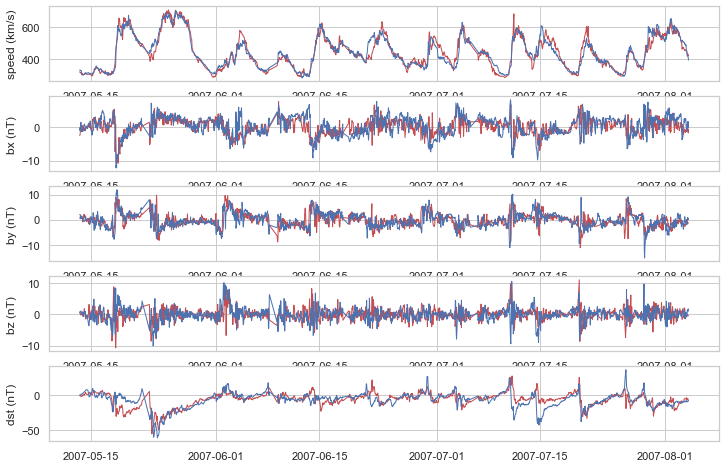

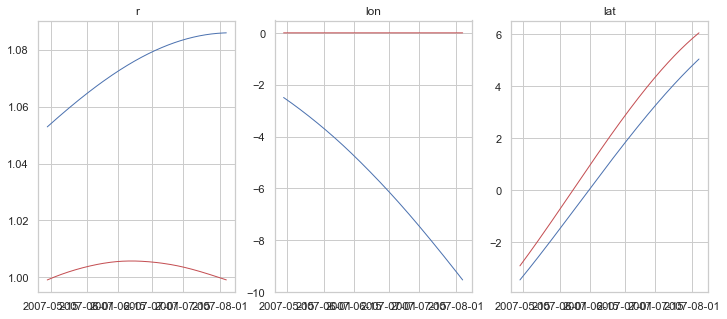

2007-06-24 05:00:00+00:00 2007-08-31 11:00:00+00:00
Data points inside -5.5 < angle < -12.5: 1616
speed -- corr:      0.92 -- offset: 0 hrs
speed -- corr_mean: 0.93 -- corr_std: 0.40
btot -- corr:      0.63 -- offset: 1 hrs
btot -- corr_mean: 0.70 -- corr_std: 0.43
bx -- corr:      0.44 -- offset: -1 hrs
bx -- corr_mean: 0.57 -- corr_std: 0.29
by -- corr:      0.45 -- offset: 1 hrs
by -- corr_mean: 0.57 -- corr_std: 0.42
bz -- corr:      0.10 -- offset: 8 hrs
bz -- corr_mean: 0.19 -- corr_std: 0.38


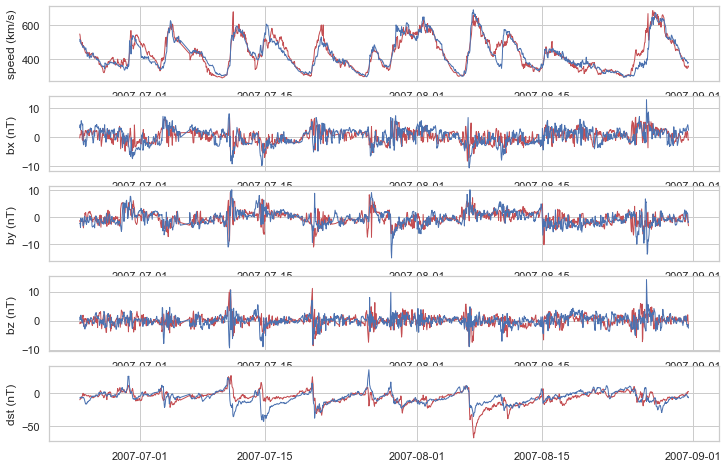

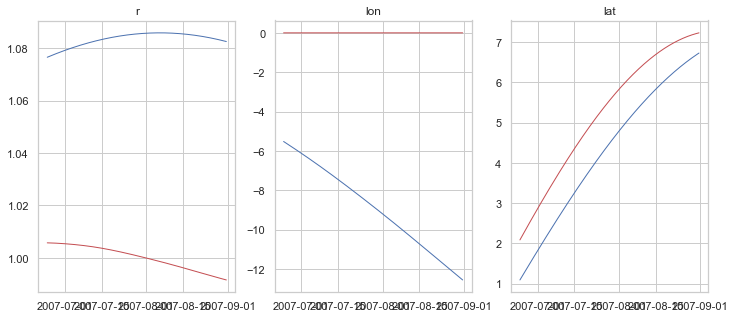

2007-07-25 12:00:00+00:00 2007-09-28 06:00:00+00:00
Data points inside -8.5 < angle < -15.5: 1555
speed -- corr:      0.94 -- offset: 0 hrs
speed -- corr_mean: 0.95 -- corr_std: 0.38
btot -- corr:      0.51 -- offset: 0 hrs
btot -- corr_mean: 0.59 -- corr_std: 0.36
bx -- corr:      0.43 -- offset: -1 hrs
bx -- corr_mean: 0.56 -- corr_std: 0.27
by -- corr:      0.44 -- offset: 1 hrs
by -- corr_mean: 0.57 -- corr_std: 0.30
bz -- corr:      0.12 -- offset: 8 hrs
bz -- corr_mean: 0.24 -- corr_std: 0.30


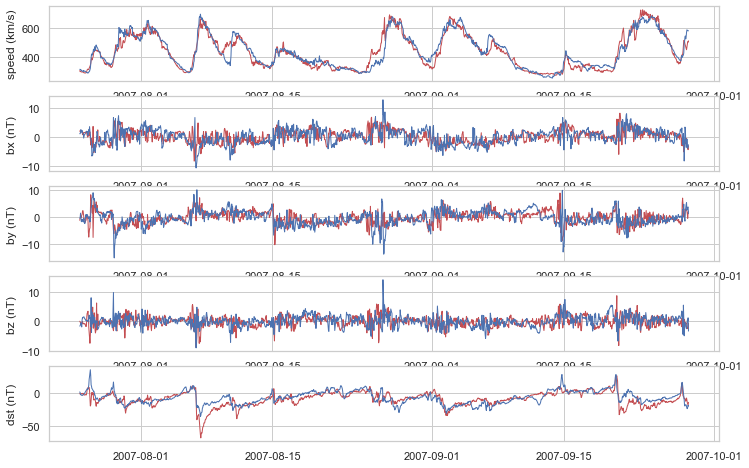

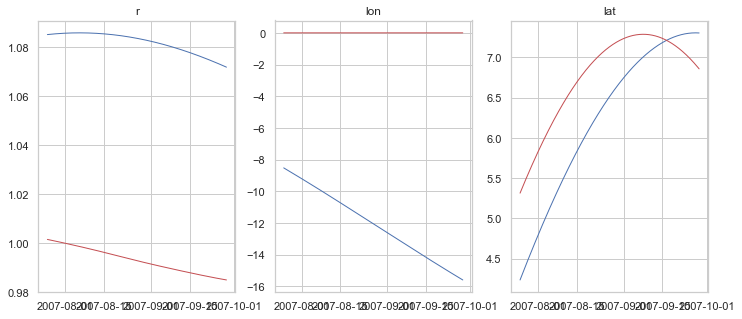

2007-08-22 10:00:00+00:00 2007-10-29 07:00:00+00:00
Data points inside -11.5 < angle < -18.5: 1616
speed -- corr:      0.93 -- offset: 0 hrs
speed -- corr_mean: 0.94 -- corr_std: 0.37
btot -- corr:      0.51 -- offset: 4 hrs
btot -- corr_mean: 0.57 -- corr_std: 0.30
bx -- corr:      0.47 -- offset: 5 hrs
bx -- corr_mean: 0.61 -- corr_std: 0.20
by -- corr:      0.43 -- offset: 0 hrs
by -- corr_mean: 0.56 -- corr_std: 0.31
bz -- corr:      0.13 -- offset: -9 hrs
bz -- corr_mean: 0.27 -- corr_std: 0.29


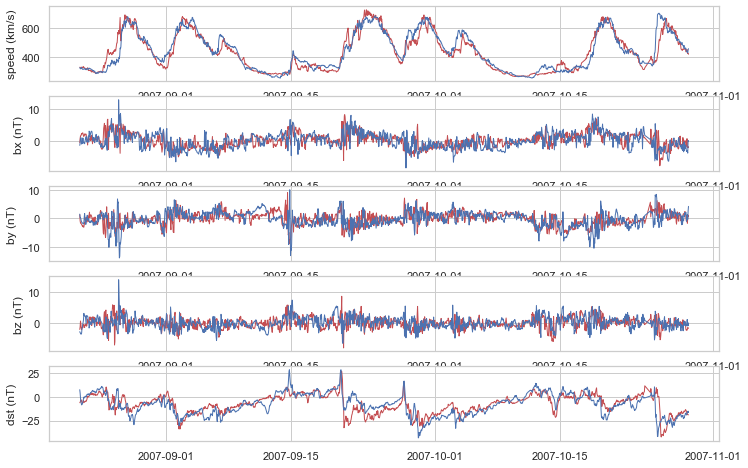

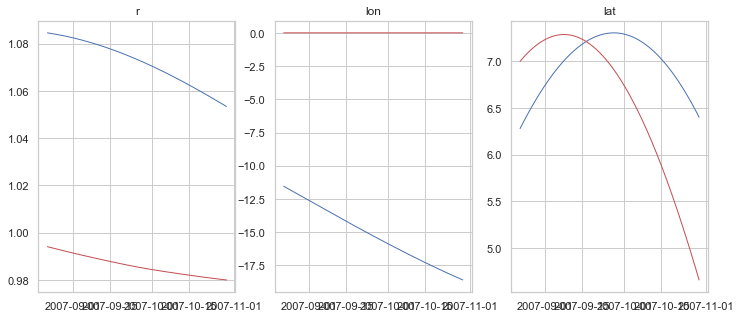

2007-09-18 17:00:00+00:00 2007-12-09 19:00:00+00:00
Data points inside -14.5 < angle < -21.5: 1921
speed -- corr:      0.89 -- offset: 0 hrs
speed -- corr_mean: 0.89 -- corr_std: 0.34
btot -- corr:      0.46 -- offset: 4 hrs
btot -- corr_mean: 0.51 -- corr_std: 0.25
bx -- corr:      0.41 -- offset: -12 hrs
bx -- corr_mean: 0.53 -- corr_std: 0.17
by -- corr:      0.45 -- offset: 1 hrs
by -- corr_mean: 0.56 -- corr_std: 0.18
bz -- corr:      0.09 -- offset: -2 hrs
bz -- corr_mean: 0.17 -- corr_std: 0.26


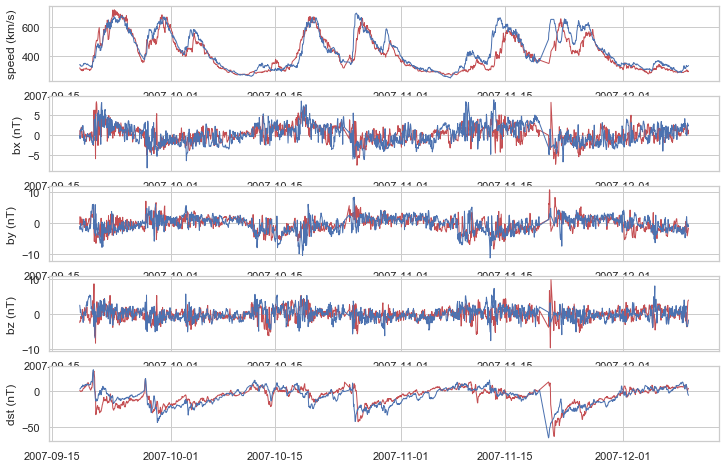

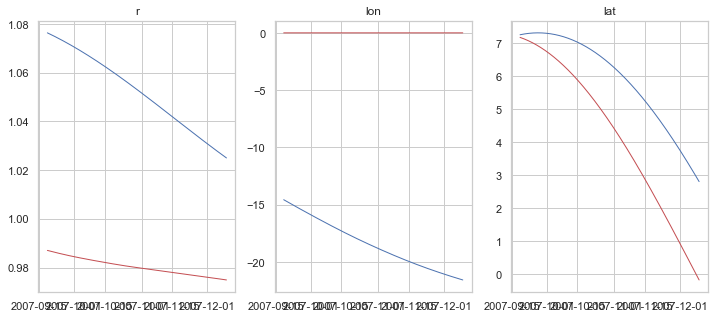

2007-10-18 07:00:00+00:00 2008-05-23 01:00:00+00:00
Data points inside -17.5 < angle < -24.5: 4958
speed -- corr:      0.87 -- offset: 0 hrs
speed -- corr_mean: 0.87 -- corr_std: 0.24
btot -- corr:      0.46 -- offset: 0 hrs
btot -- corr_mean: 0.51 -- corr_std: 0.20
bx -- corr:      0.50 -- offset: -2 hrs
bx -- corr_mean: 0.61 -- corr_std: 0.12
by -- corr:      0.41 -- offset: 8 hrs
by -- corr_mean: 0.52 -- corr_std: 0.16
bz -- corr:      0.06 -- offset: 15 hrs
bz -- corr_mean: 0.10 -- corr_std: 0.28


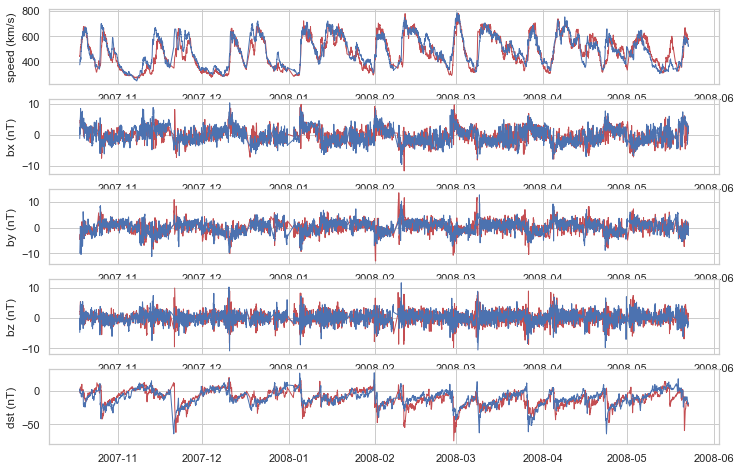

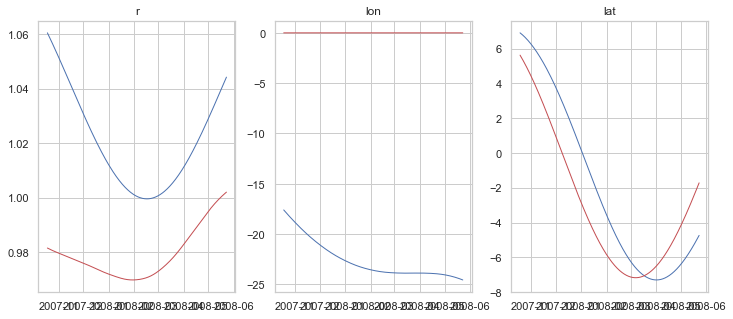

2007-11-24 00:00:00+00:00 2008-07-13 05:00:00+00:00
Data points inside -20.5 < angle < -27.5: 5316
speed -- corr:      0.85 -- offset: 0 hrs
speed -- corr_mean: 0.85 -- corr_std: 0.23
btot -- corr:      0.43 -- offset: 0 hrs
btot -- corr_mean: 0.49 -- corr_std: 0.20
bx -- corr:      0.47 -- offset: -2 hrs
bx -- corr_mean: 0.58 -- corr_std: 0.12
by -- corr:      0.39 -- offset: 8 hrs
by -- corr_mean: 0.50 -- corr_std: 0.17
bz -- corr:      0.04 -- offset: 15 hrs
bz -- corr_mean: 0.07 -- corr_std: 0.27


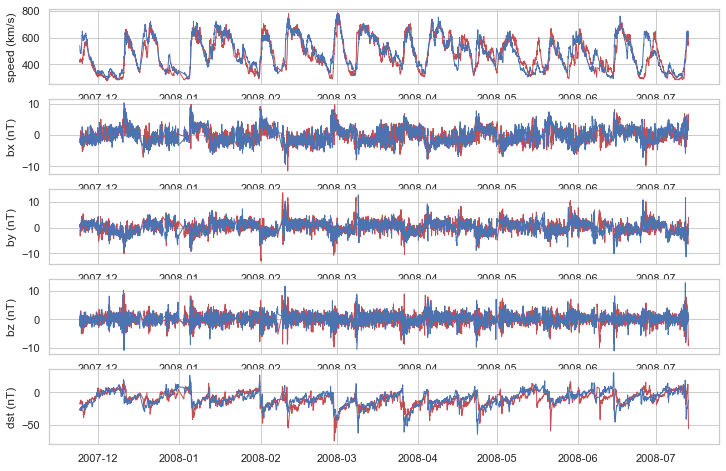

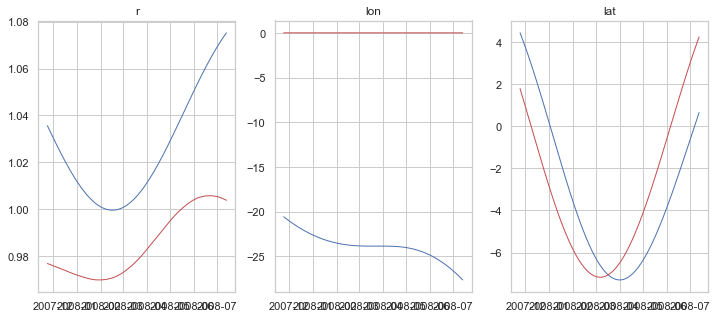

2008-01-31 12:00:00+00:00 2008-08-12 09:00:00+00:00
Data points inside -23.5 < angle < -30.5: 4509
speed -- corr:      0.84 -- offset: 0 hrs
speed -- corr_mean: 0.84 -- corr_std: 0.19
btot -- corr:      0.38 -- offset: 0 hrs
btot -- corr_mean: 0.44 -- corr_std: 0.19
bx -- corr:      0.45 -- offset: -2 hrs
bx -- corr_mean: 0.55 -- corr_std: 0.11
by -- corr:      0.40 -- offset: 3 hrs
by -- corr_mean: 0.51 -- corr_std: 0.16
bz -- corr:      0.05 -- offset: 14 hrs
bz -- corr_mean: 0.09 -- corr_std: 0.20


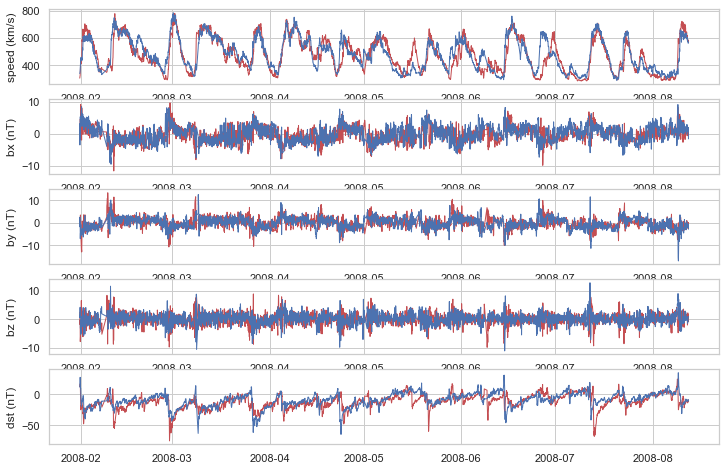

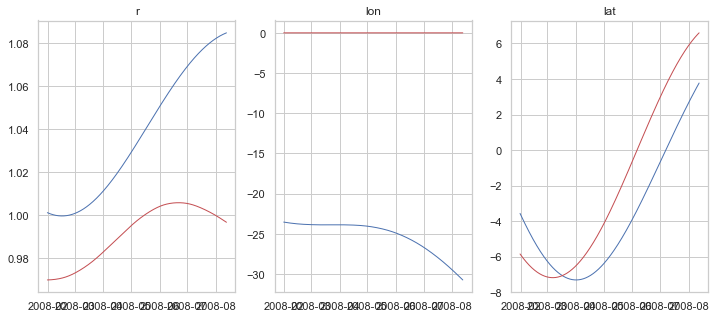

2008-06-30 17:00:00+00:00 2008-09-06 23:00:00+00:00
Data points inside -26.5 < angle < -33.5: 1599
speed -- corr:      0.92 -- offset: 0 hrs
speed -- corr_mean: 0.93 -- corr_std: 0.41
btot -- corr:      0.50 -- offset: -3 hrs
btot -- corr_mean: 0.57 -- corr_std: 0.34
bx -- corr:      0.38 -- offset: 6 hrs
bx -- corr_mean: 0.47 -- corr_std: 0.16
by -- corr:      0.36 -- offset: 3 hrs
by -- corr_mean: 0.46 -- corr_std: 0.25
bz -- corr:      0.07 -- offset: -5 hrs
bz -- corr_mean: 0.14 -- corr_std: 0.30


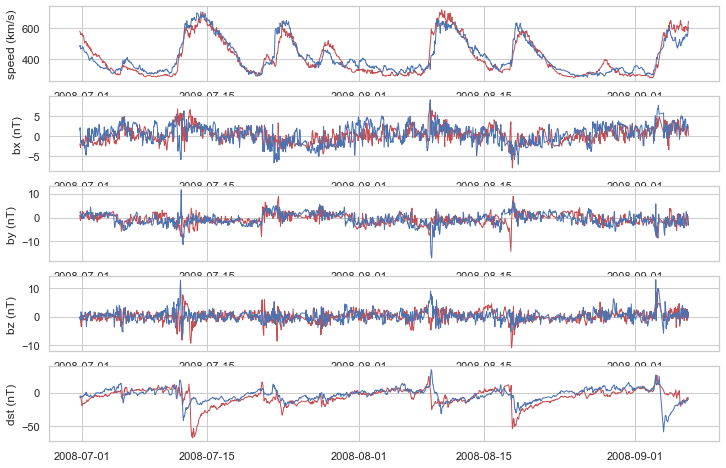

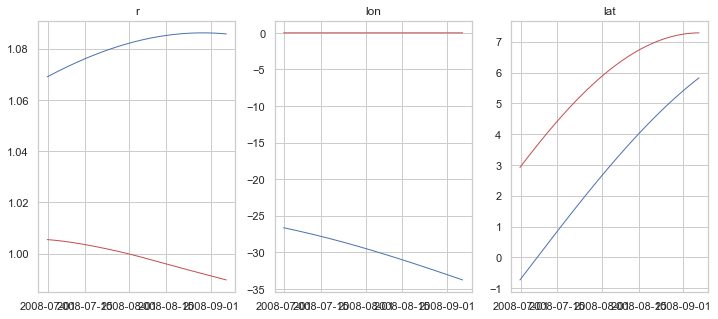

2008-08-02 23:00:00+00:00 2008-10-01 11:00:00+00:00
Data points inside -29.5 < angle < -36.5: 1351
speed -- corr:      0.94 -- offset: 0 hrs
speed -- corr_mean: 0.94 -- corr_std: 0.44
btot -- corr:      0.51 -- offset: -4 hrs
btot -- corr_mean: 0.58 -- corr_std: 0.33
bx -- corr:      0.34 -- offset: 5 hrs
bx -- corr_mean: 0.41 -- corr_std: 0.17
by -- corr:      0.25 -- offset: 18 hrs
by -- corr_mean: 0.33 -- corr_std: 0.18
bz -- corr:      0.15 -- offset: -6 hrs
bz -- corr_mean: 0.22 -- corr_std: 0.30


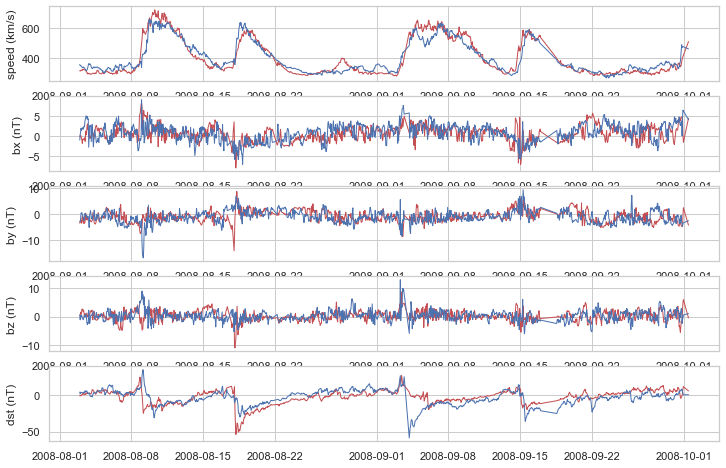

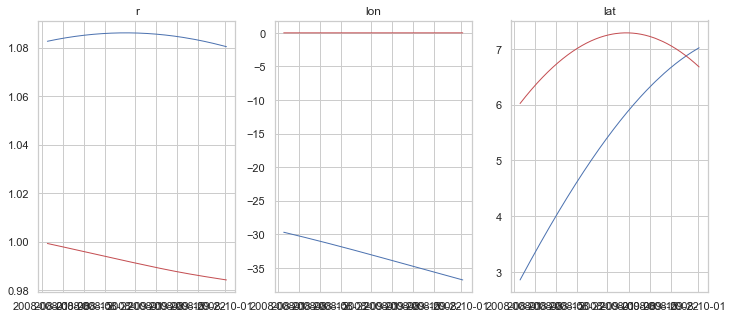

2008-08-29 13:00:00+00:00 2008-10-27 01:00:00+00:00
Data points inside -32.5 < angle < -39.5: 1260
speed -- corr:      0.95 -- offset: 0 hrs
speed -- corr_mean: 0.95 -- corr_std: 0.39
btot -- corr:      0.52 -- offset: 0 hrs
btot -- corr_mean: 0.60 -- corr_std: 0.34
bx -- corr:      0.32 -- offset: 6 hrs
bx -- corr_mean: 0.40 -- corr_std: 0.18
by -- corr:      0.27 -- offset: 10 hrs
by -- corr_mean: 0.37 -- corr_std: 0.24
bz -- corr:      0.17 -- offset: 0 hrs
bz -- corr_mean: 0.25 -- corr_std: 0.32


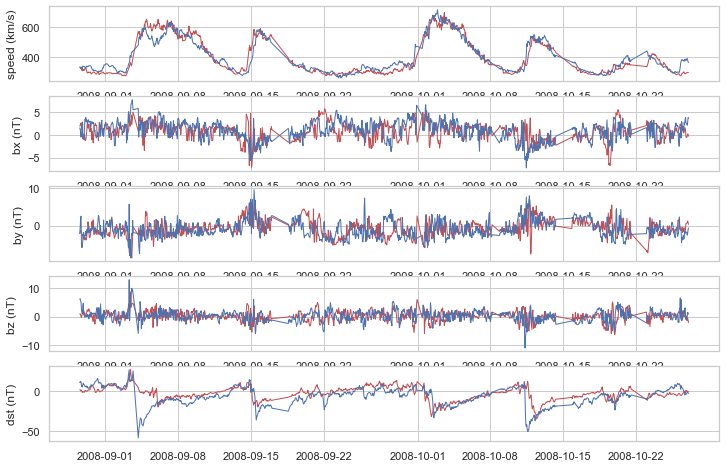

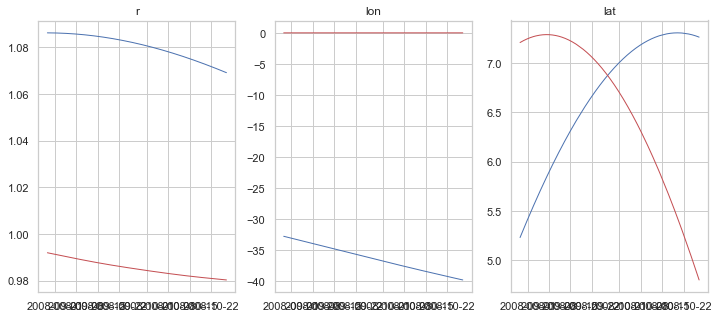

2008-09-23 01:00:00+00:00 2008-11-25 21:00:00+00:00
Data points inside -35.5 < angle < -42.5: 1421
speed -- corr:      0.91 -- offset: 0 hrs
speed -- corr_mean: 0.91 -- corr_std: 0.46
btot -- corr:      0.50 -- offset: 0 hrs
btot -- corr_mean: 0.56 -- corr_std: 0.33
bx -- corr:      0.32 -- offset: -1 hrs
bx -- corr_mean: 0.39 -- corr_std: 0.23
by -- corr:      0.27 -- offset: 17 hrs
by -- corr_mean: 0.35 -- corr_std: 0.26
bz -- corr:      0.06 -- offset: -17 hrs
bz -- corr_mean: 0.11 -- corr_std: 0.31


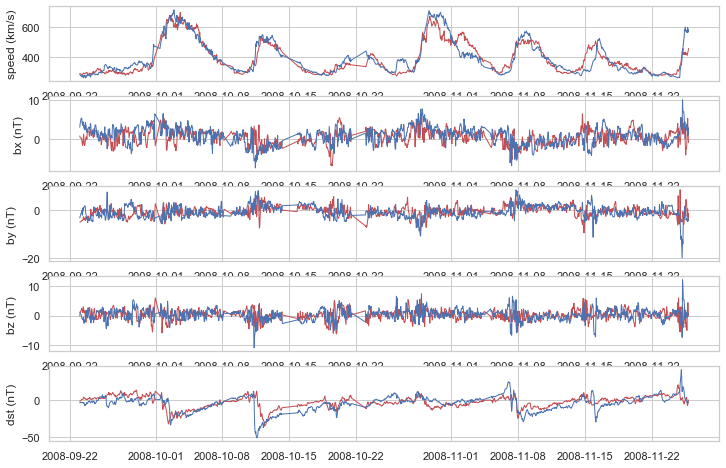

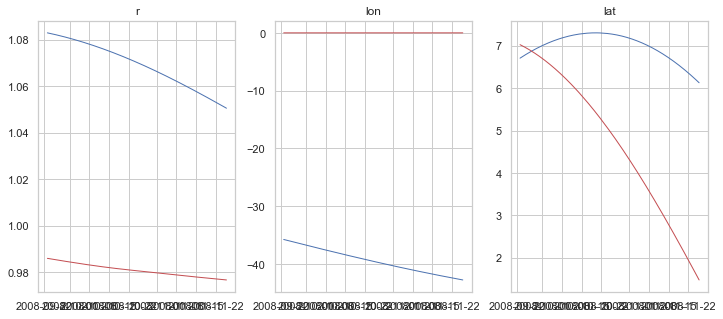

2008-10-18 04:00:00+00:00 2009-01-03 08:00:00+00:00
Data points inside -38.5 < angle < -45.5: 1731
speed -- corr:      0.77 -- offset: 0 hrs
speed -- corr_mean: 0.78 -- corr_std: 0.37
btot -- corr:      0.45 -- offset: -3 hrs
btot -- corr_mean: 0.50 -- corr_std: 0.33
bx -- corr:      0.40 -- offset: 0 hrs
bx -- corr_mean: 0.50 -- corr_std: 0.20
by -- corr:      0.29 -- offset: 4 hrs
by -- corr_mean: 0.37 -- corr_std: 0.17
bz -- corr:      0.05 -- offset: -265 hrs
bz -- corr_mean: 0.08 -- corr_std: 0.29


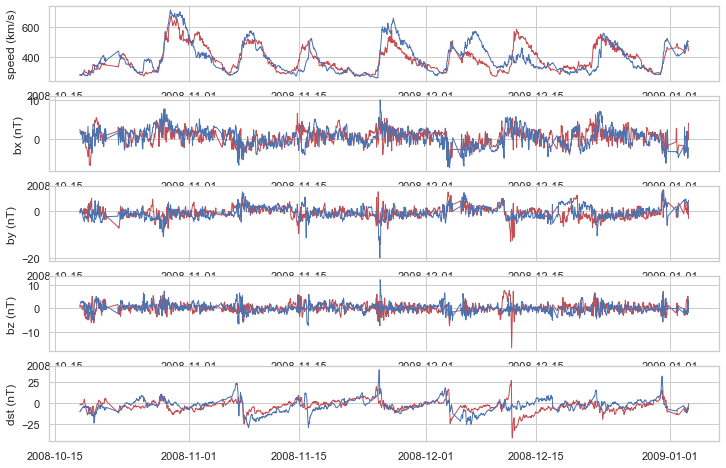

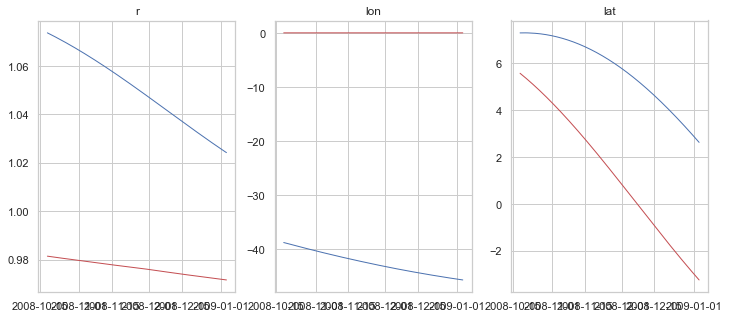

2008-11-15 09:00:00+00:00 2009-07-18 00:00:00+00:00
Data points inside -41.5 < angle < -48.5: 5412
speed -- corr:      0.58 -- offset: 0 hrs
speed -- corr_mean: 0.59 -- corr_std: 0.22
btot -- corr:      0.18 -- offset: 10 hrs
btot -- corr_mean: 0.21 -- corr_std: 0.11
bx -- corr:      0.26 -- offset: 3 hrs
bx -- corr_mean: 0.33 -- corr_std: 0.10
by -- corr:      0.24 -- offset: 4 hrs
by -- corr_mean: 0.30 -- corr_std: 0.08
bz -- corr:      0.04 -- offset: -755 hrs
bz -- corr_mean: 0.06 -- corr_std: 0.16


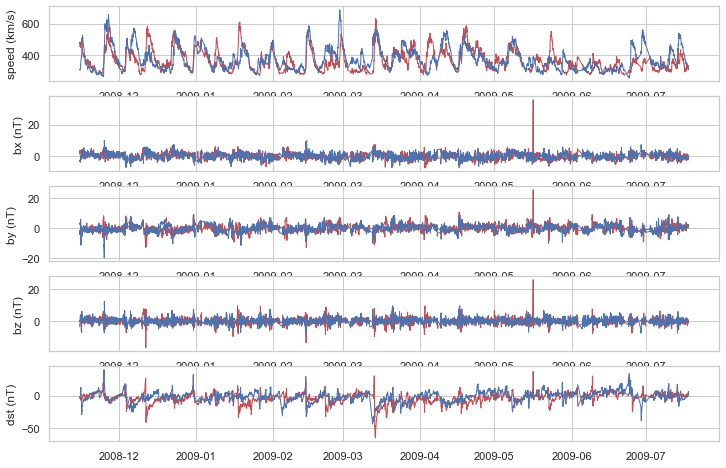

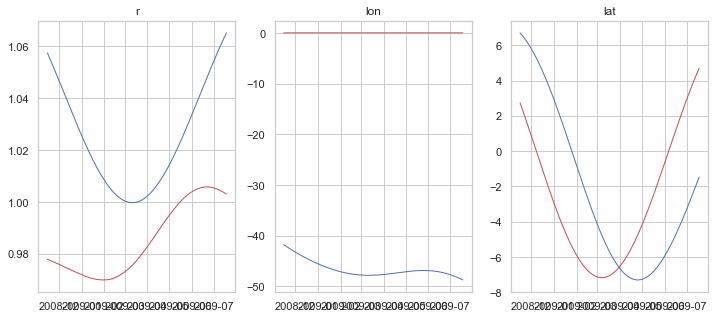

2008-12-20 00:00:00+00:00 2009-08-20 10:00:00+00:00
Data points inside -44.5 < angle < -51.5: 5262
speed -- corr:      0.56 -- offset: 0 hrs
speed -- corr_mean: 0.56 -- corr_std: 0.17
btot -- corr:      0.17 -- offset: 6 hrs
btot -- corr_mean: 0.20 -- corr_std: 0.10
bx -- corr:      0.24 -- offset: 3 hrs
bx -- corr_mean: 0.31 -- corr_std: 0.10
by -- corr:      0.23 -- offset: 4 hrs
by -- corr_mean: 0.28 -- corr_std: 0.08
bz -- corr:      0.05 -- offset: 1357 hrs
bz -- corr_mean: 0.08 -- corr_std: 0.18


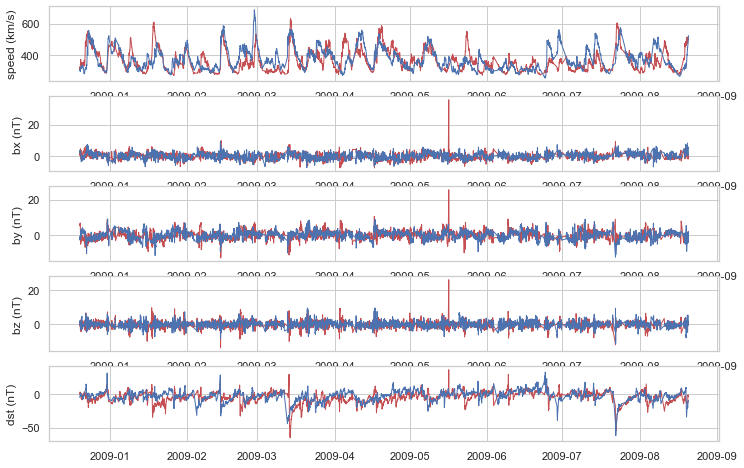

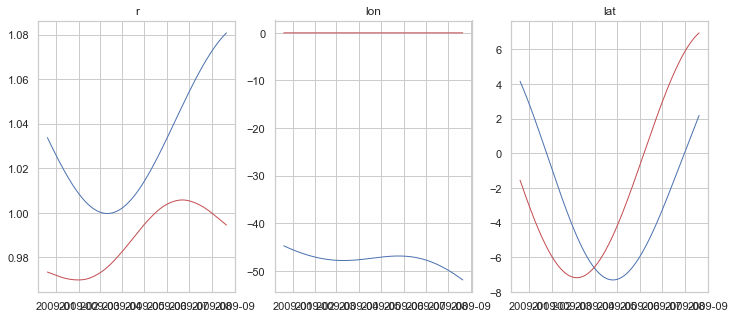

2009-02-16 23:00:00+00:00 2009-09-13 08:00:00+00:00
Data points inside -47.5 < angle < -54.4: 2780
speed -- corr:      0.53 -- offset: 0 hrs
speed -- corr_mean: 0.53 -- corr_std: 0.15
btot -- corr:      0.22 -- offset: 0 hrs
btot -- corr_mean: 0.17 -- corr_std: 0.07
bx -- corr:      0.27 -- offset: -9 hrs
bx -- corr_mean: 0.33 -- corr_std: 0.11
by -- corr:      0.21 -- offset: -16 hrs
by -- corr_mean: 0.24 -- corr_std: 0.08
bz -- corr:      0.04 -- offset: -13 hrs
bz -- corr_mean: 0.08 -- corr_std: 0.15


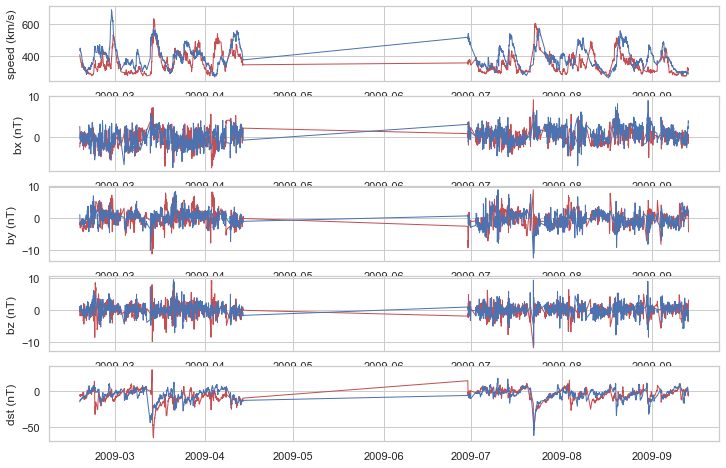

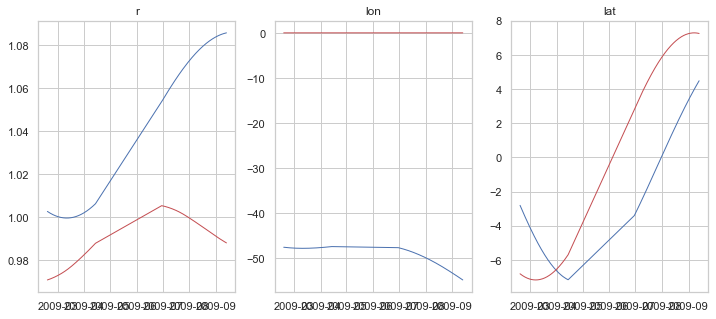

2009-08-10 21:00:00+00:00 2009-10-06 12:00:00+00:00
Data points inside -50.5 < angle < -57.4: 1207
speed -- corr:      0.54 -- offset: 0 hrs
speed -- corr_mean: 0.54 -- corr_std: 0.18
btot -- corr:      0.21 -- offset: -12 hrs
btot -- corr_mean: 0.24 -- corr_std: 0.04
bx -- corr:      0.30 -- offset: -3 hrs
bx -- corr_mean: 0.38 -- corr_std: 0.10
by -- corr:      0.21 -- offset: -10 hrs
by -- corr_mean: 0.27 -- corr_std: 0.12
bz -- corr:      0.13 -- offset: 5 hrs
bz -- corr_mean: 0.17 -- corr_std: 0.11


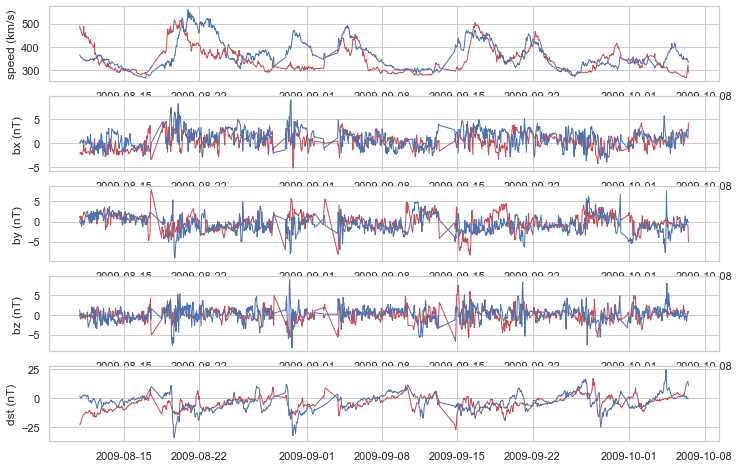

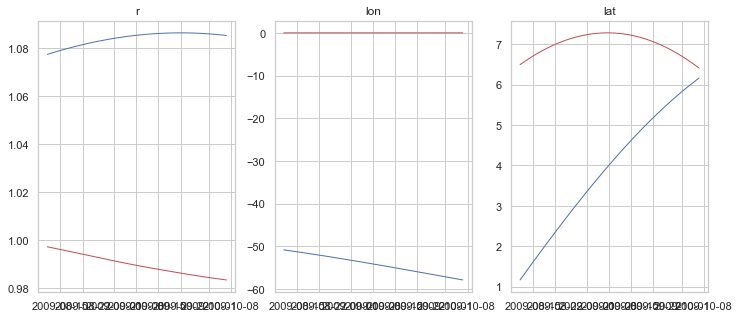

2009-09-06 10:00:00+00:00 2009-10-30 01:00:00+00:00
Data points inside -53.5 < angle < -60.5: 1126
speed -- corr:      0.59 -- offset: 0 hrs
speed -- corr_mean: 0.59 -- corr_std: 0.17
btot -- corr:      0.03 -- offset: -14 hrs
btot -- corr_mean: 0.04 -- corr_std: 0.01
bx -- corr:      0.19 -- offset: -21 hrs
bx -- corr_mean: 0.24 -- corr_std: 0.01
by -- corr:      0.14 -- offset: -10 hrs
by -- corr_mean: 0.17 -- corr_std: 0.01
bz -- corr:      0.11 -- offset: -296 hrs
bz -- corr_mean: 0.14 -- corr_std: 0.05


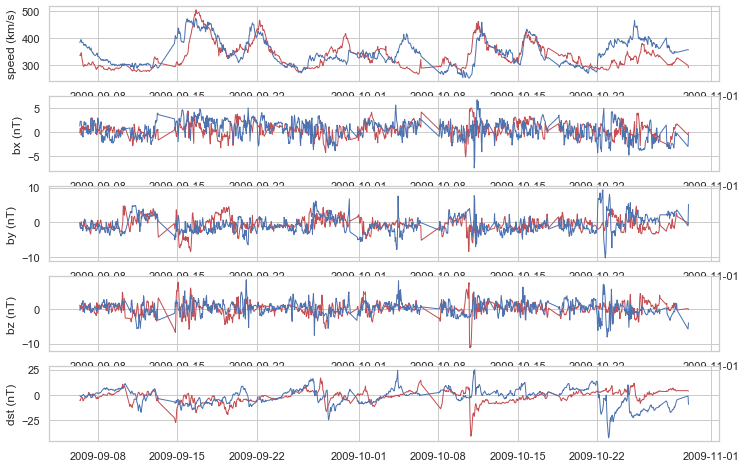

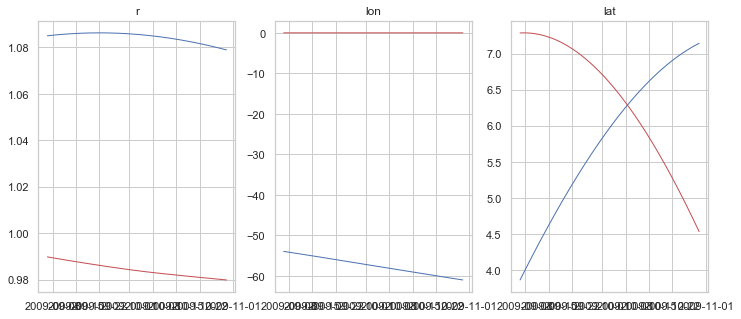

2009-09-29 18:00:00+00:00 2009-11-23 20:00:00+00:00
Data points inside -56.5 < angle < -63.5: 1127
speed -- corr:      0.53 -- offset: 0 hrs
speed -- corr_mean: 0.53 -- corr_std: 0.20
btot -- corr:      -0.01 -- offset: -18 hrs
btot -- corr_mean: 0.00 -- corr_std: 0.05
bx -- corr:      0.10 -- offset: 84 hrs
bx -- corr_mean: 0.14 -- corr_std: 0.02
by -- corr:      -0.01 -- offset: -148 hrs
by -- corr_mean: -0.02 -- corr_std: -0.02
bz -- corr:      0.04 -- offset: -305 hrs
bz -- corr_mean: 0.03 -- corr_std: 0.02


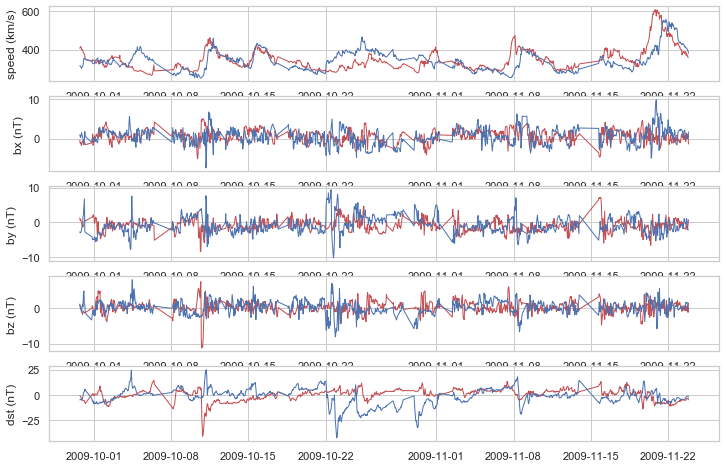

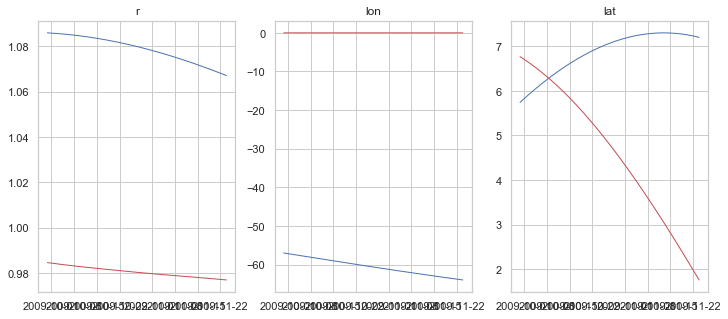

2009-10-22 09:00:00+00:00 2009-12-22 01:00:00+00:00
Data points inside -59.5 < angle < -66.5: 1231
speed -- corr:      0.49 -- offset: 0 hrs
speed -- corr_mean: 0.49 -- corr_std: 0.18
btot -- corr:      0.01 -- offset: -17 hrs
btot -- corr_mean: 0.02 -- corr_std: 0.11
bx -- corr:      0.14 -- offset: -30 hrs
bx -- corr_mean: 0.20 -- corr_std: 0.02
by -- corr:      0.09 -- offset: -33 hrs
by -- corr_mean: 0.11 -- corr_std: -0.02
bz -- corr:      0.04 -- offset: -103 hrs
bz -- corr_mean: 0.02 -- corr_std: 0.08


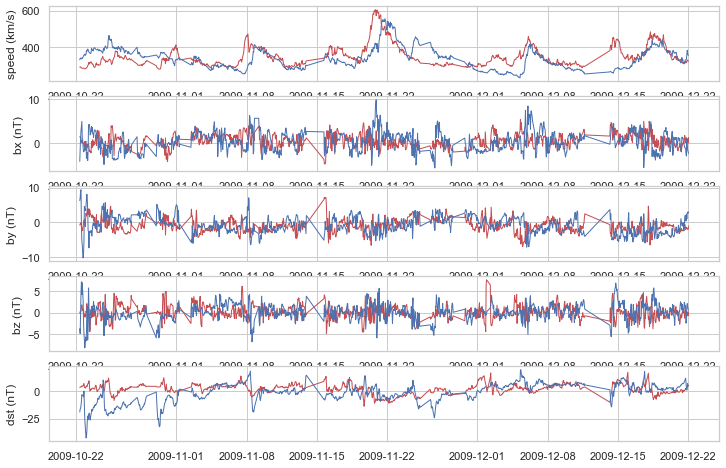

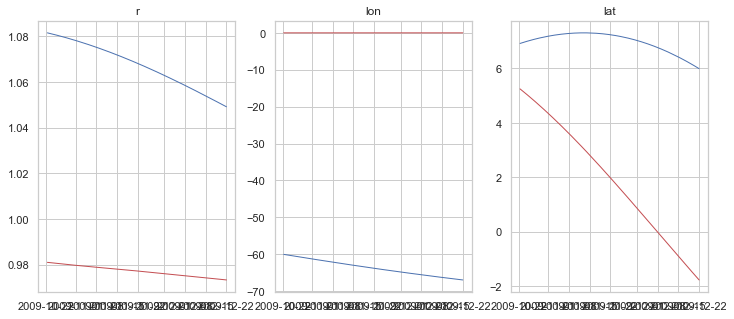

2009-11-15 17:00:00+00:00 2010-07-04 03:00:00+00:00
Data points inside -62.5 < angle < -69.5: 1686
speed -- corr:      0.66 -- offset: 0 hrs
speed -- corr_mean: 0.52 -- corr_std: 0.16
btot -- corr:      0.24 -- offset: -16 hrs
btot -- corr_mean: 0.25 -- corr_std: 0.14
bx -- corr:      0.21 -- offset: -82 hrs
bx -- corr_mean: 0.44 -- corr_std: 0.12
by -- corr:      0.18 -- offset: -39 hrs
by -- corr_mean: 0.40 -- corr_std: 0.08
bz -- corr:      0.03 -- offset: 33 hrs
bz -- corr_mean: 0.04 -- corr_std: 0.11


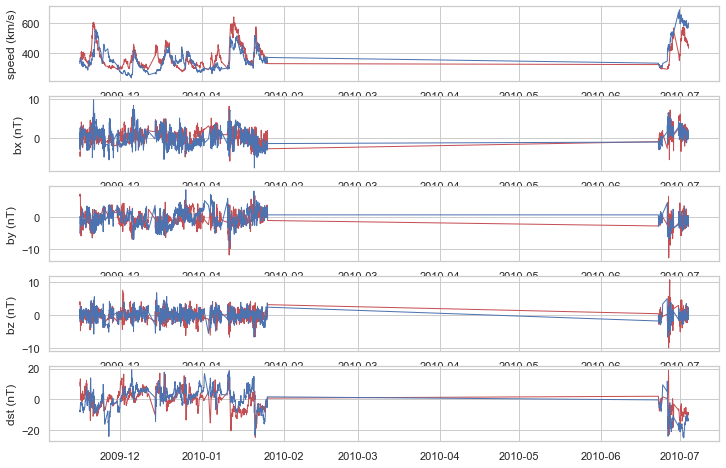

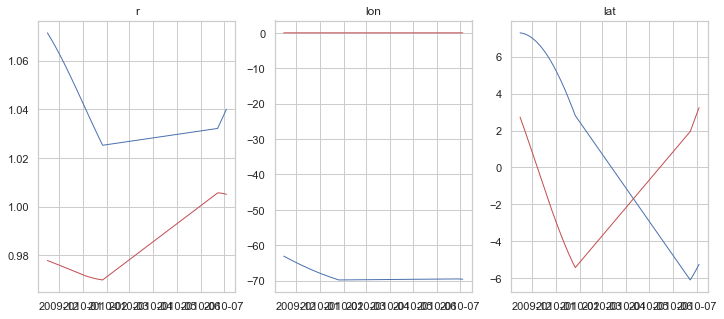

2009-12-14 05:00:00+00:00 2010-08-26 19:00:00+00:00
Data points inside -65.7 < angle < -72.5: 5352
speed -- corr:      0.48 -- offset: 0 hrs
speed -- corr_mean: 0.48 -- corr_std: 0.14
btot -- corr:      0.19 -- offset: -2 hrs
btot -- corr_mean: 0.21 -- corr_std: 0.13
bx -- corr:      0.38 -- offset: -8 hrs
bx -- corr_mean: 0.45 -- corr_std: 0.12
by -- corr:      0.29 -- offset: -2 hrs
by -- corr_mean: 0.35 -- corr_std: 0.10
bz -- corr:      0.00 -- offset: 54 hrs
bz -- corr_mean: 0.02 -- corr_std: 0.13


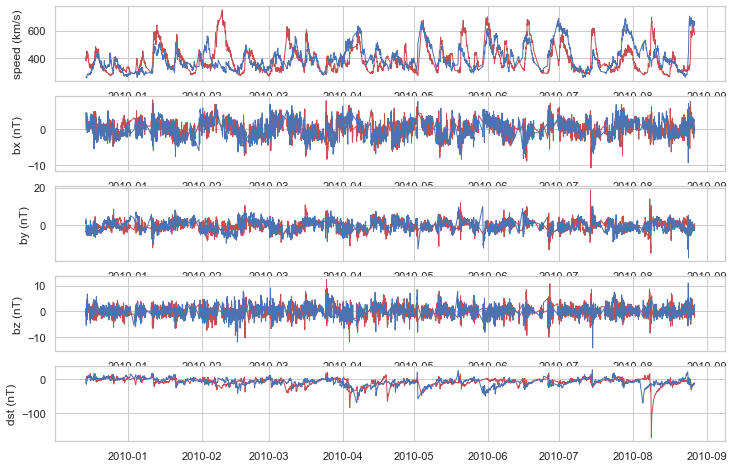

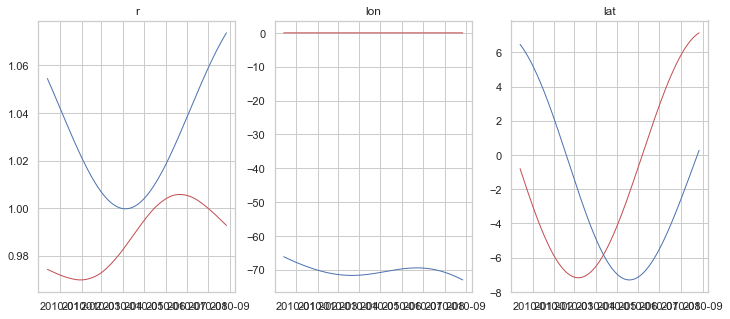

2010-01-13 16:00:00+00:00 2010-09-21 18:00:00+00:00
Data points inside -68.5 < angle < -75.5: 5277
speed -- corr:      0.49 -- offset: 0 hrs
speed -- corr_mean: 0.49 -- corr_std: 0.13
btot -- corr:      0.18 -- offset: 0 hrs
btot -- corr_mean: 0.20 -- corr_std: 0.11
bx -- corr:      0.39 -- offset: 2 hrs
bx -- corr_mean: 0.46 -- corr_std: 0.09
by -- corr:      0.29 -- offset: -5 hrs
by -- corr_mean: 0.36 -- corr_std: 0.09
bz -- corr:      0.02 -- offset: 694 hrs
bz -- corr_mean: 0.05 -- corr_std: 0.11


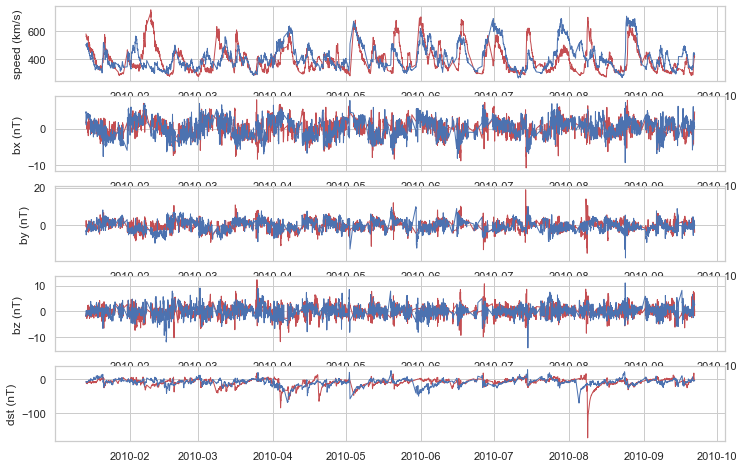

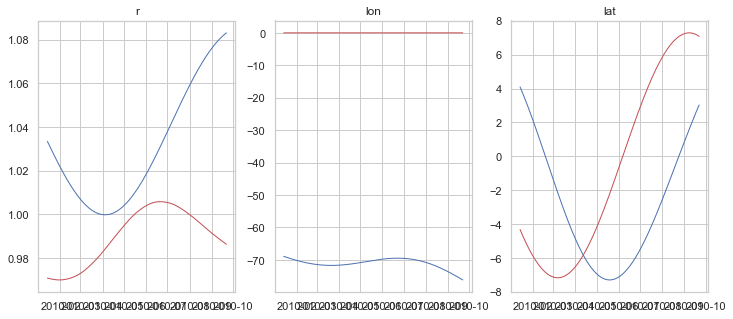

2010-03-09 10:00:00+00:00 2010-10-14 04:00:00+00:00
Data points inside -71.5 < angle < -78.5: 2049
speed -- corr:      0.67 -- offset: 0 hrs
speed -- corr_mean: 0.57 -- corr_std: 0.16
btot -- corr:      0.18 -- offset: 20 hrs
btot -- corr_mean: 0.21 -- corr_std: 0.09
bx -- corr:      0.27 -- offset: -28 hrs
bx -- corr_mean: 0.42 -- corr_std: 0.09
by -- corr:      0.24 -- offset: -46 hrs
by -- corr_mean: 0.35 -- corr_std: 0.10
bz -- corr:      0.02 -- offset: -26 hrs
bz -- corr_mean: 0.02 -- corr_std: 0.12


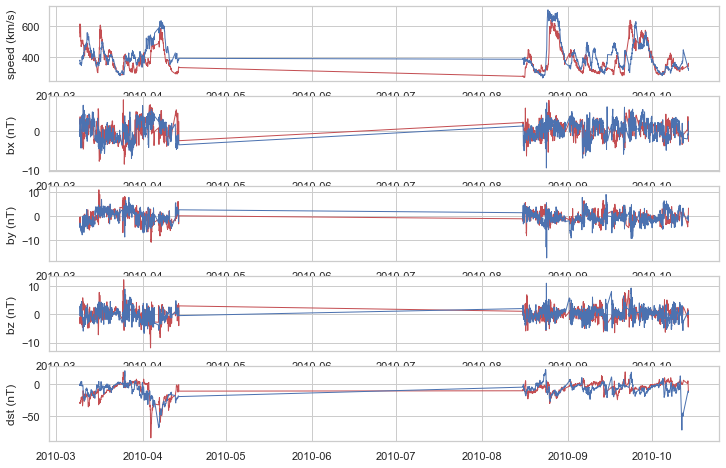

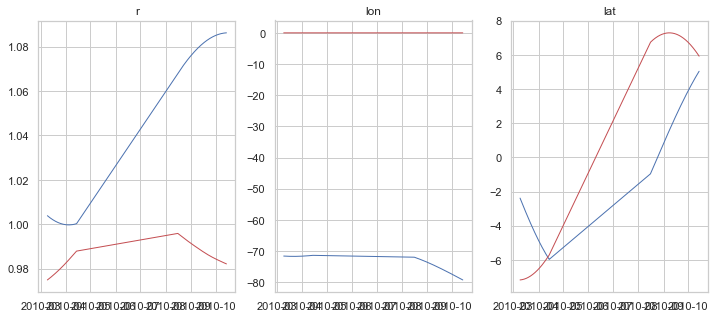

2010-09-13 18:00:00+00:00 2010-11-04 15:00:00+00:00
Data points inside -74.5 < angle < -81.5: 1059
speed -- corr:      0.80 -- offset: 0 hrs
speed -- corr_mean: 0.80 -- corr_std: 0.23
btot -- corr:      0.11 -- offset: -21 hrs
btot -- corr_mean: 0.12 -- corr_std: 0.17
bx -- corr:      0.15 -- offset: 5 hrs
bx -- corr_mean: 0.19 -- corr_std: 0.14
by -- corr:      0.19 -- offset: -11 hrs
by -- corr_mean: 0.25 -- corr_std: 0.05
bz -- corr:      -0.01 -- offset: -8 hrs
bz -- corr_mean: -0.01 -- corr_std: 0.04


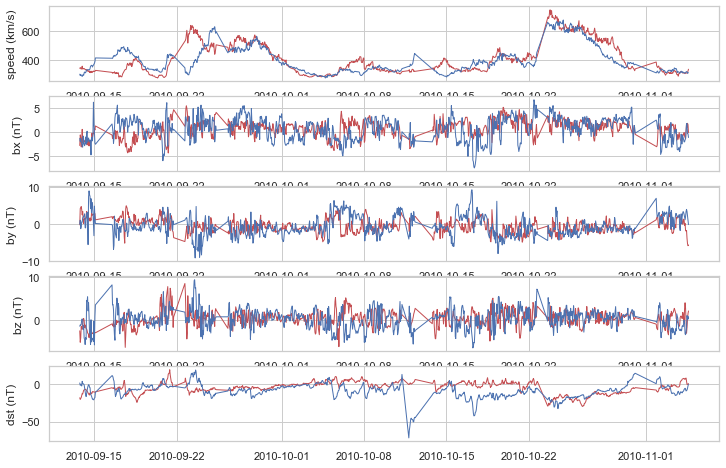

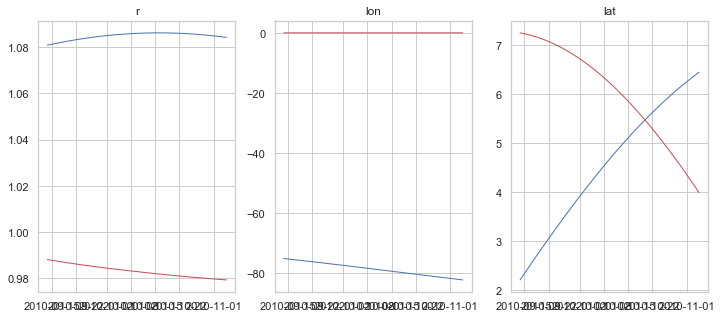

2010-10-06 23:00:00+00:00 2010-11-25 19:00:00+00:00
Data points inside -77.5 < angle < -84.4: 1033
speed -- corr:      0.77 -- offset: 0 hrs
speed -- corr_mean: 0.78 -- corr_std: 0.10
btot -- corr:      -0.01 -- offset: 67 hrs
btot -- corr_mean: -0.01 -- corr_std: 0.03
bx -- corr:      0.26 -- offset: -7 hrs
bx -- corr_mean: 0.32 -- corr_std: 0.08
by -- corr:      0.34 -- offset: -9 hrs
by -- corr_mean: 0.41 -- corr_std: 0.07
bz -- corr:      -0.02 -- offset: -15 hrs
bz -- corr_mean: -0.04 -- corr_std: 0.10


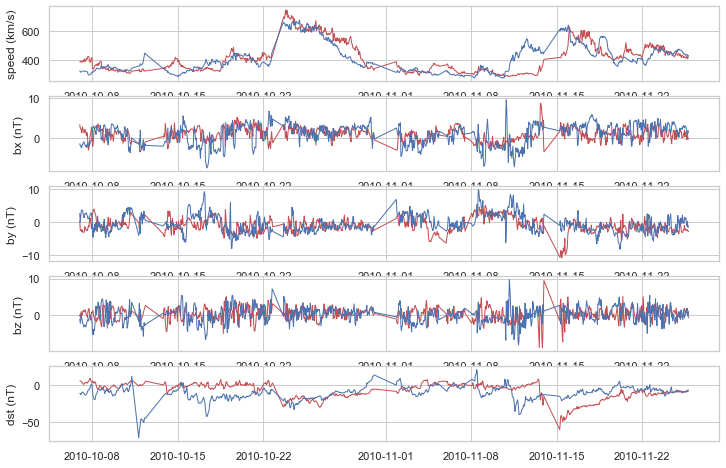

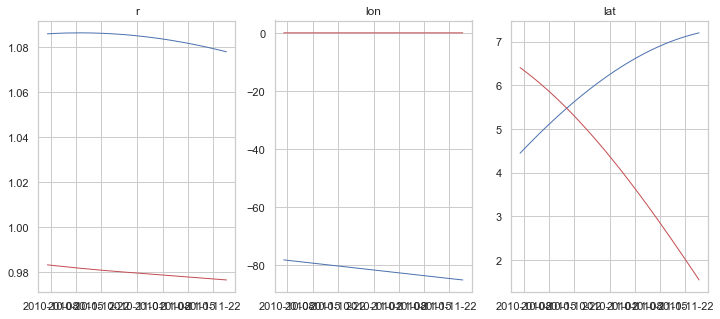

2010-10-28 16:00:00+00:00 2010-12-19 20:00:00+00:00
Data points inside -80.5 < angle < -87.4: 1046
speed -- corr:      0.53 -- offset: 0 hrs
speed -- corr_mean: 0.54 -- corr_std: 0.16
btot -- corr:      0.10 -- offset: 71 hrs
btot -- corr_mean: 0.11 -- corr_std: 0.00
bx -- corr:      0.40 -- offset: -23 hrs
bx -- corr_mean: 0.46 -- corr_std: 0.06
by -- corr:      0.34 -- offset: 8 hrs
by -- corr_mean: 0.41 -- corr_std: 0.10
bz -- corr:      -0.04 -- offset: 613 hrs
bz -- corr_mean: -0.07 -- corr_std: 0.14


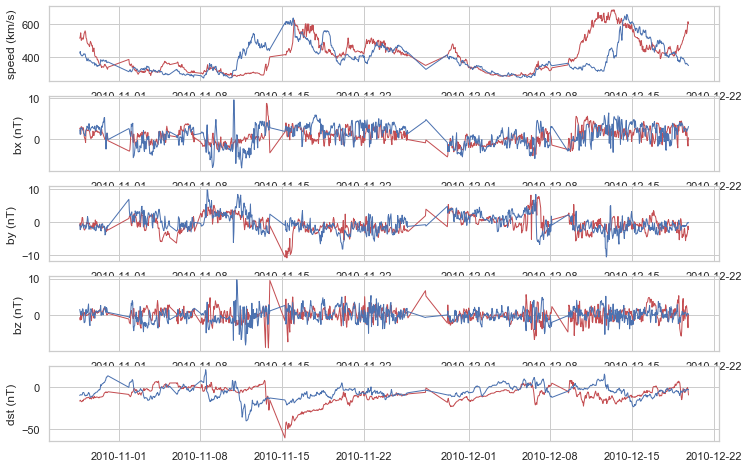

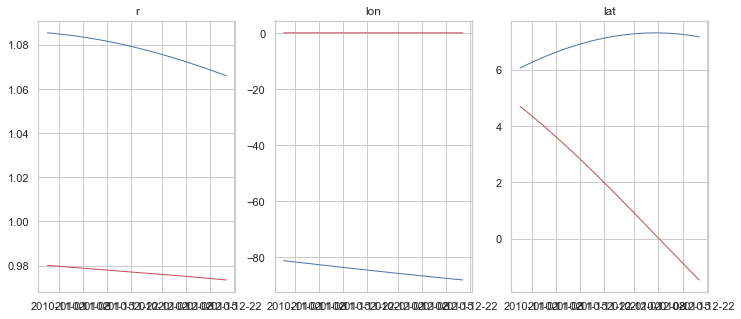

2010-11-19 07:00:00+00:00 2011-01-16 02:00:00+00:00
Data points inside -83.5 < angle < -90.5: 1182
speed -- corr:      0.63 -- offset: 0 hrs
speed -- corr_mean: 0.63 -- corr_std: 0.23
btot -- corr:      0.19 -- offset: 2 hrs
btot -- corr_mean: 0.22 -- corr_std: 0.02
bx -- corr:      0.34 -- offset: -15 hrs
bx -- corr_mean: 0.42 -- corr_std: -0.05
by -- corr:      0.28 -- offset: 9 hrs
by -- corr_mean: 0.36 -- corr_std: 0.11
bz -- corr:      -0.00 -- offset: 124 hrs
bz -- corr_mean: 0.02 -- corr_std: 0.11


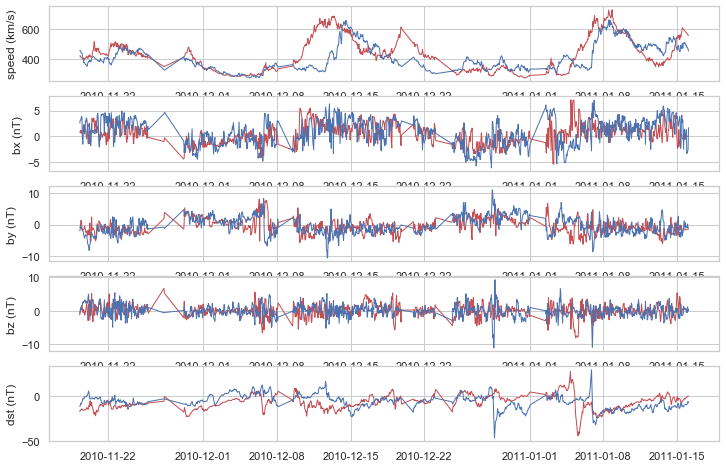

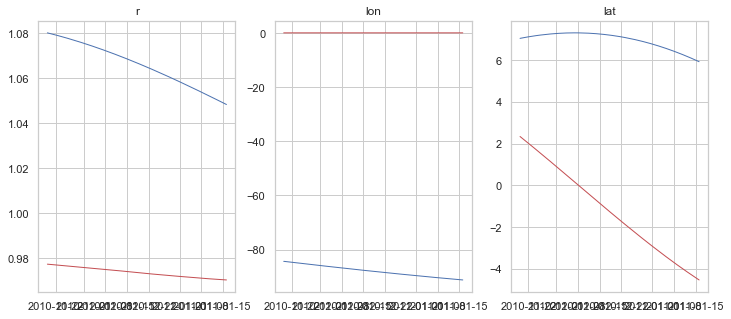

2010-12-12 10:00:00+00:00 2011-08-28 21:00:00+00:00
Data points inside -86.5 < angle < -93.5: 3194
speed -- corr:      0.55 -- offset: 0 hrs
speed -- corr_mean: 0.55 -- corr_std: 0.12
btot -- corr:      0.16 -- offset: 57 hrs
btot -- corr_mean: 0.17 -- corr_std: 0.10
bx -- corr:      0.31 -- offset: 8 hrs
bx -- corr_mean: 0.41 -- corr_std: 0.01
by -- corr:      0.27 -- offset: 12 hrs
by -- corr_mean: 0.36 -- corr_std: 0.06
bz -- corr:      0.04 -- offset: 37 hrs
bz -- corr_mean: 0.15 -- corr_std: 0.10


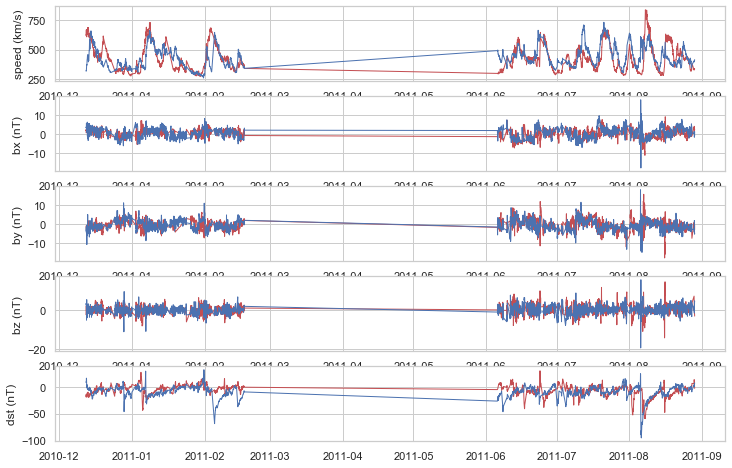

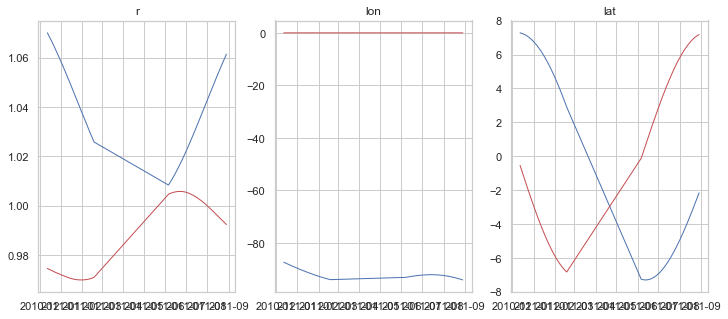

2011-01-06 20:00:00+00:00 2011-09-28 04:00:00+00:00
Data points inside -89.5 < angle < -96.5: 5188
speed -- corr:      0.53 -- offset: 0 hrs
speed -- corr_mean: 0.54 -- corr_std: 0.12
btot -- corr:      0.16 -- offset: 22 hrs
btot -- corr_mean: 0.17 -- corr_std: 0.12
bx -- corr:      0.37 -- offset: 0 hrs
bx -- corr_mean: 0.43 -- corr_std: 0.02
by -- corr:      0.28 -- offset: 7 hrs
by -- corr_mean: 0.36 -- corr_std: 0.08
bz -- corr:      0.11 -- offset: -2 hrs
bz -- corr_mean: 0.16 -- corr_std: 0.09


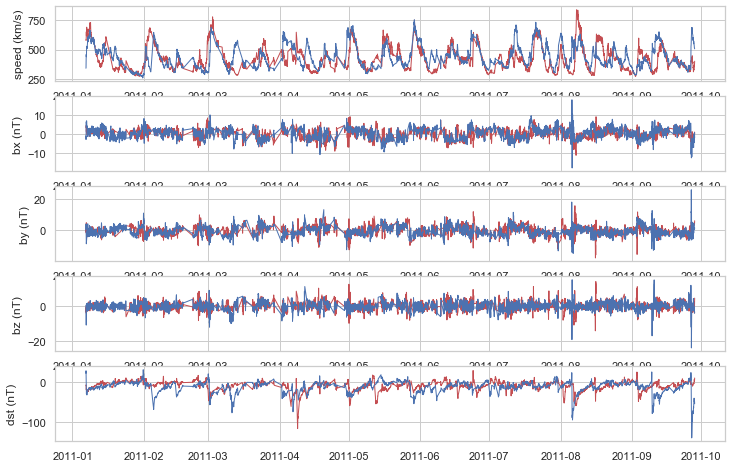

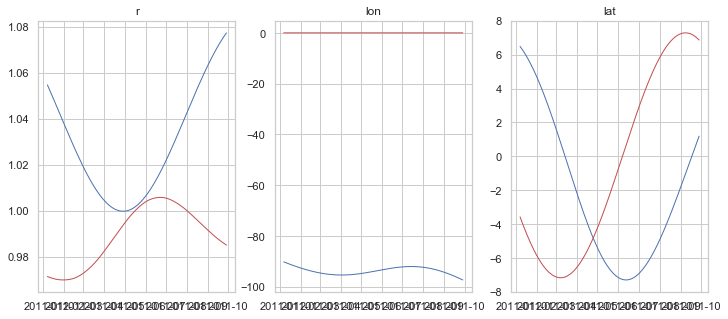

2011-02-06 04:00:00+00:00 2011-10-21 07:00:00+00:00
Data points inside -92.5 < angle < -99.5: 4050
speed -- corr:      0.43 -- offset: 0 hrs
speed -- corr_mean: 0.48 -- corr_std: 0.11
btot -- corr:      0.08 -- offset: -17 hrs
btot -- corr_mean: 0.10 -- corr_std: 0.10
bx -- corr:      0.36 -- offset: 0 hrs
bx -- corr_mean: 0.42 -- corr_std: 0.04
by -- corr:      0.27 -- offset: 5 hrs
by -- corr_mean: 0.38 -- corr_std: 0.06
bz -- corr:      0.11 -- offset: 14 hrs
bz -- corr_mean: 0.14 -- corr_std: 0.08


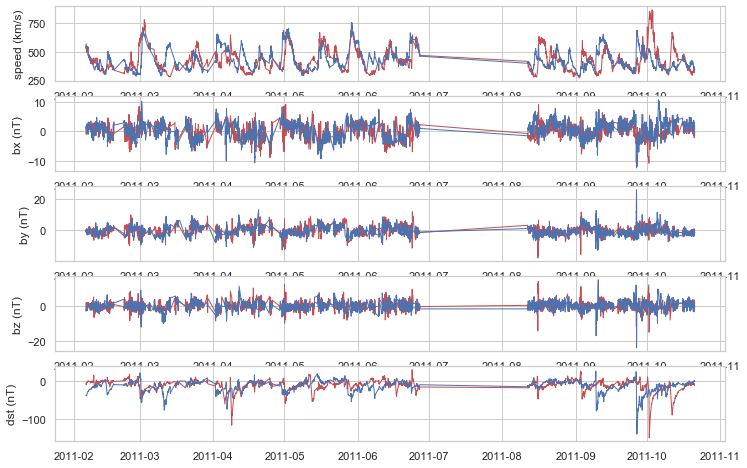

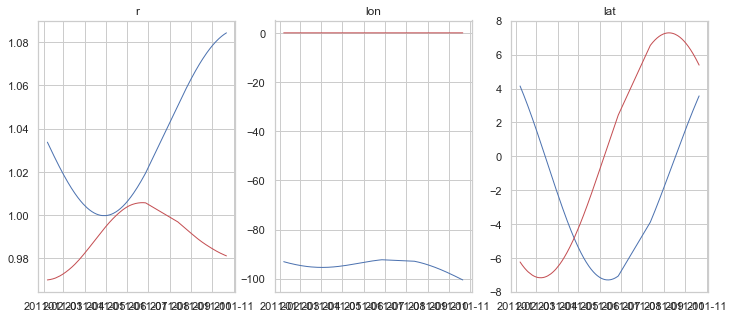

2011-09-19 16:00:00+00:00 2011-11-11 03:00:00+00:00
Data points inside -95.5 < angle < -102.5: 1024
speed -- corr:      0.36 -- offset: 0 hrs
speed -- corr_mean: 0.36 -- corr_std: 0.22
btot -- corr:      -0.15 -- offset: 53 hrs
btot -- corr_mean: -0.16 -- corr_std: 0.09
bx -- corr:      0.27 -- offset: 14 hrs
bx -- corr_mean: 0.31 -- corr_std: 0.12
by -- corr:      0.25 -- offset: 66 hrs
by -- corr_mean: 0.29 -- corr_std: 0.10
bz -- corr:      0.08 -- offset: 16 hrs
bz -- corr_mean: 0.15 -- corr_std: 0.02


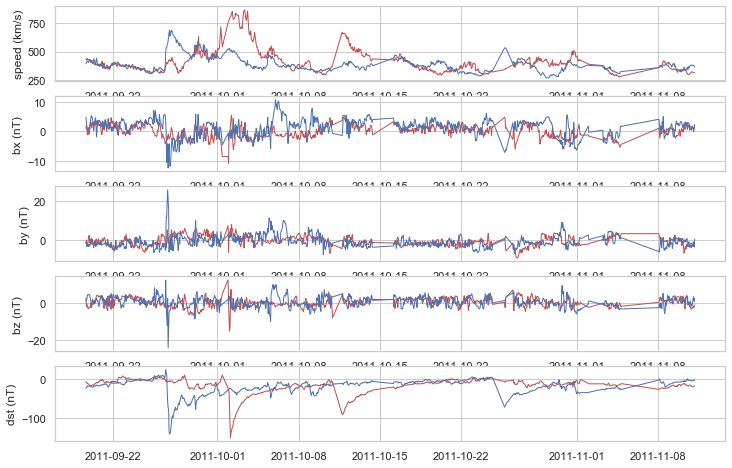

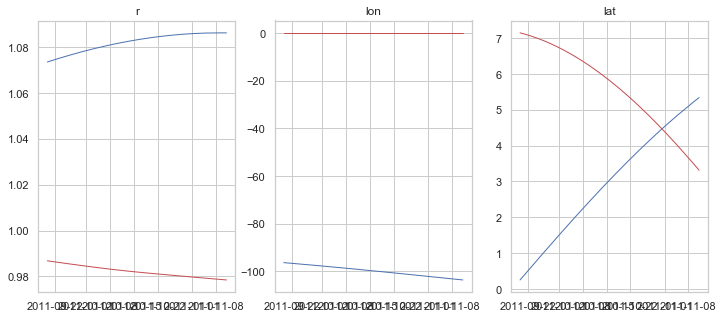

2011-10-14 03:00:00+00:00 2011-12-02 02:00:00+00:00
Data points inside -98.5 < angle < -105.5: 801
speed -- corr:      0.34 -- offset: 0 hrs
speed -- corr_mean: 0.33 -- corr_std: 0.03
btot -- corr:      0.00 -- offset: 18 hrs
btot -- corr_mean: 0.02 -- corr_std: 0.06
bx -- corr:      0.34 -- offset: 13 hrs
bx -- corr_mean: 0.34 -- corr_std: 0.10
by -- corr:      0.20 -- offset: -18 hrs
by -- corr_mean: 0.20 -- corr_std: 0.13
bz -- corr:      0.12 -- offset: 18 hrs
bz -- corr_mean: 0.19 -- corr_std: 0.02


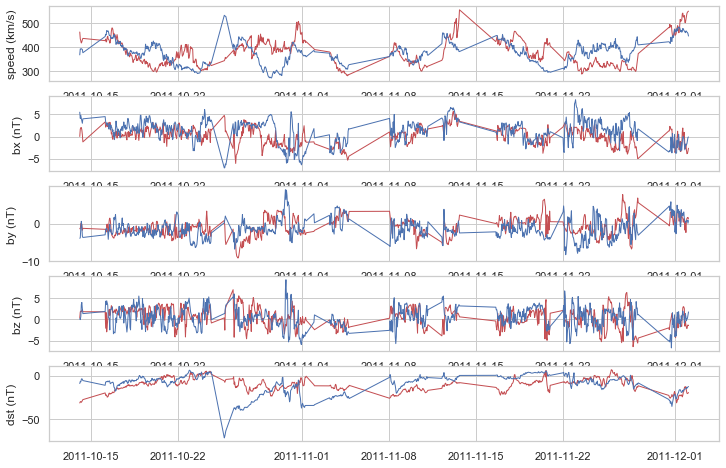

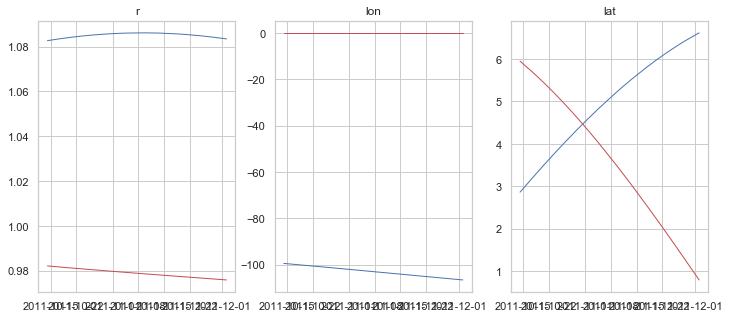

2011-11-04 08:00:00+00:00 2011-12-23 02:00:00+00:00
Data points inside -101.5 < angle < -108.5: 831
speed -- corr:      0.61 -- offset: 0 hrs
speed -- corr_mean: 0.61 -- corr_std: 0.18
btot -- corr:      0.27 -- offset: -14 hrs
btot -- corr_mean: 0.29 -- corr_std: 0.27
bx -- corr:      0.32 -- offset: -15 hrs
bx -- corr_mean: 0.35 -- corr_std: 0.23
by -- corr:      0.29 -- offset: -7 hrs
by -- corr_mean: 0.32 -- corr_std: 0.23
bz -- corr:      -0.02 -- offset: -75 hrs
bz -- corr_mean: -0.01 -- corr_std: 0.16


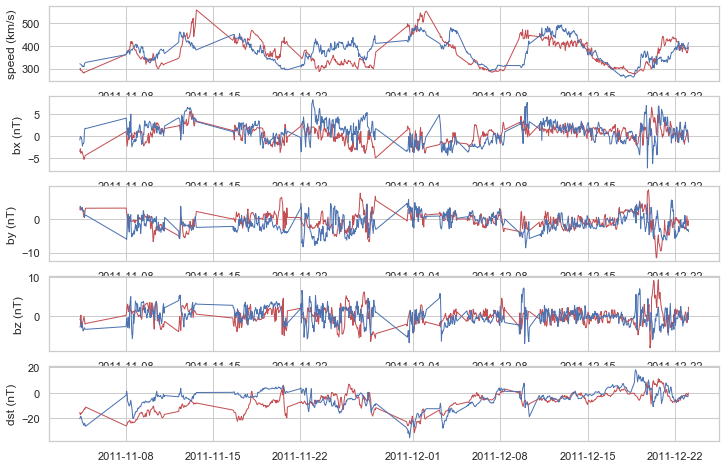

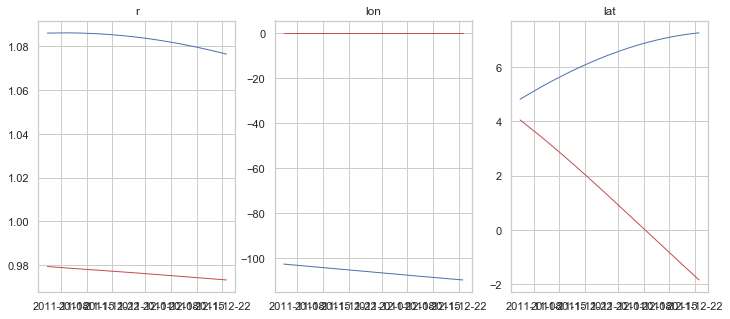

2011-11-25 00:00:00+00:00 2012-01-14 11:00:00+00:00
Data points inside -104.5 < angle < -111.5: 997
speed -- corr:      0.48 -- offset: 0 hrs
speed -- corr_mean: 0.49 -- corr_std: 0.21
btot -- corr:      0.28 -- offset: -12 hrs
btot -- corr_mean: 0.31 -- corr_std: 0.20
bx -- corr:      0.22 -- offset: -9 hrs
bx -- corr_mean: 0.25 -- corr_std: 0.20
by -- corr:      0.29 -- offset: -6 hrs
by -- corr_mean: 0.34 -- corr_std: 0.21
bz -- corr:      -0.12 -- offset: 44 hrs
bz -- corr_mean: -0.13 -- corr_std: 0.23


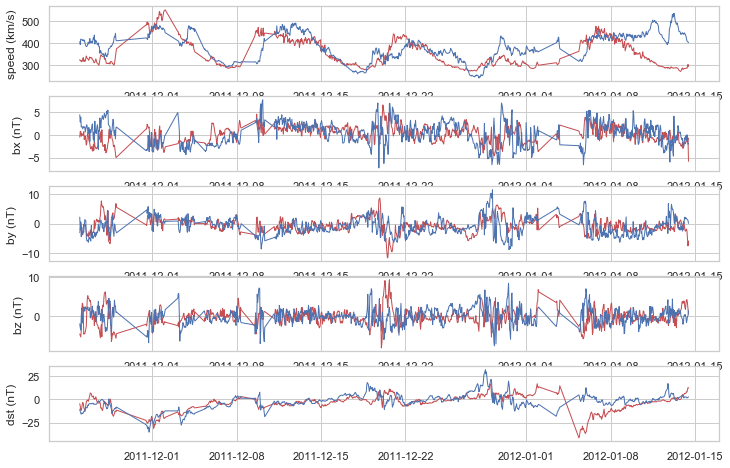

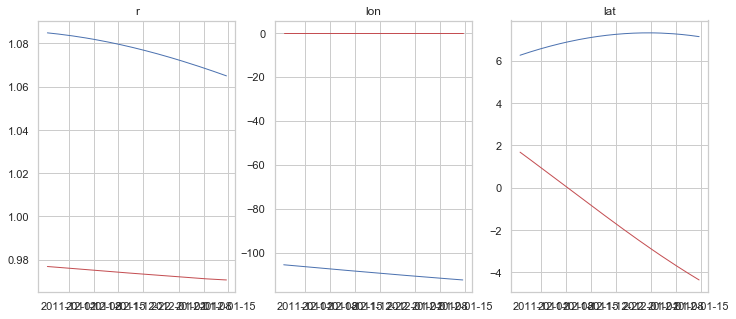

In [27]:
# LOOK AT VARIABLES ACROSS TIME
# Checking data between STEREO-B and OMNI
steptype = 'angle'
if steptype == 'time':
    step = 30*3
    min_time = np.round(stbh['time'][np.where(stbh_lons*180/np.pi < -0)[0][0]], 0)
    max_time = np.round(stbh['time'][np.where(stbh_lons*180/np.pi < -110)[0][0]], 0)
    teststeps = np.arange(min_time, max_time, step)
elif steptype == 'angle':
    lonstep = -3
    lonrange = 7
    teststeps = range(angle_bracket[0], angle_bracket[1], lonstep)

print('Time range covered for analysis in angle bracket [-0, -110]:')
print('start:', num2date(min_time))
print('end:  ', num2date(max_time))
print("")

dttime = [num2date(t).replace(tzinfo=None) for t in stbh['time']]
L1Pos = ps.get_l1_position(dttime, units=stbh.pos.h['Units'], refframe=stbh.pos.h['ReferenceFrame'])

cc_vals = {'lats': [], 'lons': [], 'speed': [], 'btot': [], 'bx': [], 'by': [], 'bz': []}
count = 0
plot_every_n = 1 # 4 to plot every fourth plot
for dtest in teststeps:
    if steptype == 'time':
        t_inds = np.where((stbh['time'] > (dtest)) & (stbh['time'] < dtest+step))
        t_inds_mean = np.where((stbh_mean['time'] > (dtest)) & (stbh_mean['time'] < dtest+step))
    elif steptype == 'angle':
        t_inds = np.where((stbh_lons*180/np.pi > (dtest-lonrange/2.)) & 
                          (stbh_lons*180/np.pi < (dtest+lonrange/2.)))
        print(num2date(stbh['time'][t_inds][0]), num2date(stbh['time'][t_inds][-1]))
        t_inds_mean = np.where((stbh_mean['time'] >= stbh['time'][t_inds][0]) & 
                               (stbh_mean['time'] < stbh['time'][t_inds][-1]))
    lats = stbh_lats[t_inds]*180./np.pi
    lons = stbh_lons[t_inds]*180./np.pi
    cc_vals['lats'].append(np.mean(lats))
    cc_vals['lons'].append(np.mean(lons))
    print('Data points inside {:.1f} < angle < {:.1f}: {}'.format(np.max(lons), np.min(lons), len(t_inds[0])))
    t = np.linspace(0.0, stbh['time'][t_inds][-1] - stbh['time'][t_inds][0], len(t_inds[0]), endpoint=False)
    dt = np.linspace(-t[-1], t[-1], 2*len(t_inds[0])-1)
    for varo in ['speed', 'btot', 'bx', 'by', 'bz']:
        cc_val = np.corrcoef(omni[varo][t_inds], stbh[varo][t_inds])[0][1]
        cc_vals[varo].append(cc_val)
        xcorr = scipy.signal.correlate(stbh[varo][t_inds], omni[varo][t_inds])
        hours_offset = 24.*dt[xcorr.argmax()]
        print("{} -- corr:      {:.2f} -- offset: {:.0f} hrs".format(varo, cc_val, hours_offset))
        corr_mean = np.corrcoef(stbh_mean[varo][t_inds_mean], omni_mean[varo][t_inds_mean])[0][1]
        corr_std = np.corrcoef(stbh_std[varo][t_inds_mean], omni_std[varo][t_inds_mean])[0][1]
        if varo+'_mean' in cc_vals.keys():
            cc_vals[varo+'_mean'].append(corr_mean)
        else:
            cc_vals[varo+'_mean'] = [corr_mean]
        if varo+'_std' in cc_vals.keys():
            cc_vals[varo+'_std'].append(corr_std)
        else:
            cc_vals[varo+'_std'] = [corr_std]
        print("{} -- corr_mean: {:.2f} -- corr_std: {:.2f}".format(varo, corr_mean, corr_std))
    
    if count%plot_every_n == 0:  # only print every fourth plot
        nfig += 1
        fig, (ax1, ax2, ax3, ax4, ax5) = plt.subplots(5, 1, num=nfig, figsize=(12,8))
        ax1.plot_date(stbh['time'][t_inds], stbh['speed'][t_inds], 'r-', lw=1)
        ax1.plot_date(omni['time'][t_inds], omni['speed'][t_inds], 'b-', lw=1)
        ax2.plot_date(stbh['time'][t_inds], stbh['bx'][t_inds], 'r-', lw=1)
        ax2.plot_date(omni['time'][t_inds], omni['bx'][t_inds], 'b-', lw=1)
        ax3.plot_date(stbh['time'][t_inds], stbh['by'][t_inds], 'r-', lw=1)
        ax3.plot_date(omni['time'][t_inds], omni['by'][t_inds], 'b-', lw=1)
        ax4.plot_date(stbh['time'][t_inds], stbh['bz'][t_inds], 'r-', lw=1)
        ax4.plot_date(omni['time'][t_inds], omni['bz'][t_inds], 'b-', lw=1)
        ax5.plot_date(stbh['time'][t_inds], stbh['dst'][t_inds], 'r-', lw=1)
        ax5.plot_date(omni['time'][t_inds], omni['ae'][t_inds], 'b-', lw=1)
        ax1.set_ylabel("speed (km/s)")
        ax2.set_ylabel("bx (nT)")
        ax3.set_ylabel("by (nT)")
        ax4.set_ylabel("bz (nT)")
        ax5.set_ylabel("dst (nT)")

        nfig +=1
        fig, (ax1, ax2, ax3) = plt.subplots(1, 3, num=nfig, figsize=(12,5))
        ax1.plot_date(stbh['time'][t_inds], stbh.pos['r'][t_inds], 'b-', lw=1)
        ax1.plot_date(omni['time'][t_inds], L1Pos['r'][t_inds], 'r-', lw=1)
        ax1.set_title('r')
        ax2.plot_date(stbh['time'][t_inds], stbh.pos['lon'][t_inds]*180/np.pi, 'b-', lw=1)
        ax2.plot_date(omni['time'][t_inds], L1Pos['lon'][t_inds]*180/np.pi, 'r-', lw=1)
        ax2.set_title('lon')
        ax3.plot_date(stbh['time'][t_inds], stbh.pos['lat'][t_inds]*180/np.pi, 'b-', lw=1)
        ax3.plot_date(omni['time'][t_inds], L1Pos['lat'][t_inds]*180/np.pi, 'r-', lw=1)
        ax3.set_title('lat')

        plt.show()
    count += 1

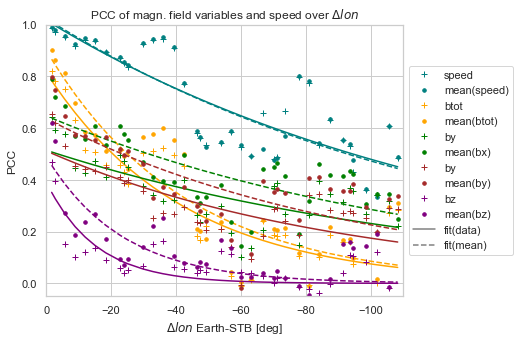

In [28]:
# Plot means over delta-lon
from scipy.optimize import curve_fit 
ms = '+'
ms_mean = '.'
msize = 7
def decaying_fit(x, a, e): 
    return a*np.exp(e*x)
x = np.array(cc_vals['lons'])

fig = plt.figure(figsize=(8,5))
#speed
param, param_cov = curve_fit(decaying_fit, x, cc_vals['speed']) 
btot_fit = decaying_fit(x, *param)
param, param_cov = curve_fit(decaying_fit, x, cc_vals['speed_mean']) 
btot_mean_fit = decaying_fit(x, *param)
plt.plot(x, cc_vals['speed'], ms, c=varcolors['speed'], label='speed')
plt.plot(x, btot_fit, '-', c=varcolors['speed'])
plt.plot(x, cc_vals['speed_mean'], ms_mean, c=varcolors['speed'], label='mean(speed)', ms=msize)#, mfc='none')
plt.plot(x, btot_mean_fit, '--', c=varcolors['speed'])
#btot
param, param_cov = curve_fit(decaying_fit, x, cc_vals['btot']) 
btot_fit = decaying_fit(x, *param)
param, param_cov = curve_fit(decaying_fit, x, cc_vals['btot_mean']) 
btot_mean_fit = decaying_fit(x, *param)
plt.plot(x, cc_vals['btot'], ms, c=varcolors['btot'], label='btot')
plt.plot(x, btot_fit, '-', c=varcolors['btot'])
plt.plot(x, cc_vals['btot_mean'], ms_mean, c=varcolors['btot'], label='mean(btot)', ms=msize)#, mfc='none')
plt.plot(x, btot_mean_fit, '--', c=varcolors['btot'])
#bx
param, param_cov = curve_fit(decaying_fit, x, cc_vals['bx']) 
bx_fit = decaying_fit(x, *param)
param, param_cov = curve_fit(decaying_fit, x, cc_vals['bx_mean']) 
bx_mean_fit = decaying_fit(x, *param)
plt.plot(x, cc_vals['bx'], ms, c=varcolors['bx'], label='by')
plt.plot(x, bx_fit, '-', c=varcolors['bx'])
plt.plot(x, cc_vals['bx_mean'], ms_mean, c=varcolors['bx'], label='mean(bx)', ms=msize)#, mfc='none')
plt.plot(x, bx_mean_fit, '--', c=varcolors['bx'])
#by
param, param_cov = curve_fit(decaying_fit, x, cc_vals['by']) 
by_fit = decaying_fit(x, *param)
param, param_cov = curve_fit(decaying_fit, x, cc_vals['by_mean']) 
by_mean_fit = decaying_fit(x, *param)
plt.plot(x, cc_vals['by'], ms, c=varcolors['by'], label='by')
plt.plot(x, by_fit, '-', c=varcolors['by'])
plt.plot(x, cc_vals['by_mean'], ms_mean, c=varcolors['by'], label='mean(by)', ms=msize)#, mfc='none')
plt.plot(x, by_mean_fit, '--', c=varcolors['by'])
#bz
param, param_cov = curve_fit(decaying_fit, x, cc_vals['bz']) 
bz_fit = decaying_fit(x, *param)
param, param_cov = curve_fit(decaying_fit, x, cc_vals['bz_mean']) 
bz_mean_fit = decaying_fit(x, *param)
plt.plot(x, cc_vals['bz'], ms, c=varcolors['bz'], label='bz')
plt.plot(x, bz_fit, '-', c=varcolors['bz'])
plt.plot(x, cc_vals['bz_mean'], ms_mean, c=varcolors['bz'], label='mean(bz)', ms=msize)#, mfc='none')
plt.plot(x, bz_mean_fit, '--', c=varcolors['bz'])

plt.plot([10,20], [-1,-2], '-', c='grey', label='fit(data)')
plt.plot([10,20], [-1,-2], '--', c='grey', label='fit(mean)')

# Shrink current axis by 20%
ax = plt.gca()
box = ax.get_position()
ax.set_position([box.x0, box.y0, box.width * 0.8, box.height])

# Put a legend to the right of the current axis
ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))#, fontsize=9)
#plt.legend(loc="upper right", fontsize=9)

plt.xlim((0,-110))
plt.ylim((-0.05, 1.0))
plt.title("PCC of magn. field variables and speed over $\Delta lon$")
plt.xlabel(r"$\Delta lon$ Earth-STB [deg]")
plt.ylabel("PCC")
plt.savefig("plots/vars_pcc.pdf")
plt.show()

### Dst accuracy depending on L5-L1 longitude angle diff

Notes:
- Errors from OMNI remain roughly the same over time ranges
- Errors from STEREO appear to increase with increasing distance from L1
- Besides increase, errors follow same trend as OMNI

In [29]:
#tstep = 30
#trange = 60
#min_time = np.round(stbh['time'][np.where(stbh.pos['lon']*180/np.pi < -0)[0][0]], 0)
#max_time = np.round(stbh['time'][np.where(stbh.pos['lon']*180/np.pi < -110)[0][0]], 0)
#testtimes = np.arange(min_time, max_time, step)

#dttime = [num2date(t).replace(tzinfo=None) for t in stbh['time']]
#L1Pos = ps.get_l1_position(dttime, units=stbh.pos.h['Units'], refframe=stbh.pos.h['ReferenceFrame'])

#stat_dicts = {'omni': [], 'stb': [], 'pers': [], 'angles': [], 'latdiffs': []}
#for dtest in testtimes:
#    t_inds = np.where((stbh['time'] > (dtest)) & (stbh['time'] < dtest+step))
#    lats = stbh.pos['lat'][t_inds]*180./np.pi
#    lons = stbh.pos['lon'][t_inds]*180./np.pi
#    stat_dicts['angles'].append(np.mean(lons))

lonstep = -1
lonrange = 4
testangles = range(angle_bracket[0], angle_bracket[1], lonstep)
diff_stds, diff_stds_omni = [], []
stat_dicts = {'omni': [], 'stb': [], 'pers': [], 'lons': [], 'latdiffs': [], 'stblat': [], 'l1lat': []}
for dtest in testangles:
    t_inds = np.where((stbh_lons*180/np.pi > (dtest-lonrange/2.)) & 
                      (stbh_lons*180/np.pi < (dtest+lonrange/2.)))
    stat_dicts['lons'].append(dtest)
    stat_dicts['latdiffs'].append(np.mean(stbh_lats[t_inds]*180./np.pi - L1Pos['lat'][t_inds]*180/np.pi))
    stat_dicts['stblat'].append(np.mean(stbh_lats[t_inds]*180./np.pi))
    stat_dicts['l1lat'].append(np.mean(L1Pos['lat'][t_inds]*180/np.pi))

    #print('Data points inside {} < angle < {}: {}'.format((dtest-lonrange/2.), 
    #                                                      (dtest+lonrange/2.), len(t_inds[0])))

    if len(t_inds[0]) != 0:
        stat_dict_omni = get_statistics(dst_temerinli_omni[t_inds], odst[t_inds], printtext=False)
        stat_dict = get_statistics(dst_temerinli[t_inds], odst[t_inds], printtext=False)
        stat_dict_pers = get_statistics(dst_temerinli_pers[t_inds], odst[t_inds], printtext=False)
    stat_dicts['omni'].append(stat_dict_omni)
    stat_dicts['stb'].append(stat_dict)
    stat_dicts['pers'].append(stat_dict_pers)
    #print('Dst diff mean (L1) +/- std: {:.1f} +/- {:.1f}'.format(stat_dict_omni['diff_mean'], 
    #                                                             stat_dict_omni['diff_std']))
    #print('Dst diff mean (L5) +/- std: {:.1f} +/- {:.1f}'.format(stat_dict['diff_mean'], 
    #                                                             stat_dict['diff_std']))
    diff_stds_omni.append(stat_dict_omni['diff_std'])
    diff_stds.append(stat_dict['diff_std'])

OMNI CC:   slope=0.0001, intercept=0.90, mean=0.88
STB  CC:   slope=0.0056, intercept=0.64, mean=0.35
PERS CC:   slope=0.0035, intercept=0.44, mean=0.24
----
OMNI MAE:  slope=-0.0022, intercept=3.66, mean=3.82
STB  MAE:  slope=-0.0360, intercept=5.64, mean=7.97
PERS MAE:  slope=-0.0310, intercept=7.05, mean=9.12
----
OMNI RMSE: slope=-0.0013, intercept=4.80, mean=4.88
STB  RMSE: slope=-0.0447, intercept=7.71, mean=11.03
PERS RMSE: slope=-0.0396, intercept=9.90, mean=12.59
----
OMNI ME:   slope=0.0217, intercept=0.95, mean=-0.09
STB  ME:   slope=0.0284, intercept=1.69, mean=-0.25
PERS ME:   slope=0.0040, intercept=-0.94, mean=-1.17


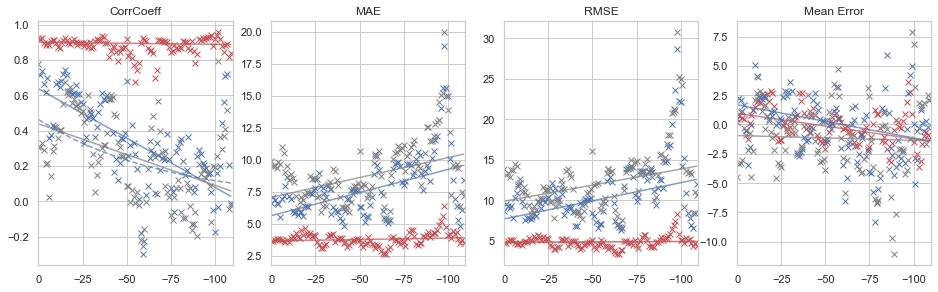

In [30]:
# Get arrays of metrics:
# ----------------------
# Longitude values
modnames = ['omni', 'stb', 'pers']
dlons = np.array(stat_dicts['lons'])
dlats = np.array(stat_dicts['latdiffs'])
ppmc, slope_cc, intercept_cc, mean_cc = {}, {}, {}, {}
mean, slope_me, intercept_me, mean_me = {}, {}, {}, {}
mae, slope_mae, intercept_mae, mean_mae = {}, {}, {}, {}
rmse, slope_rmse, intercept_rmse, mean_rmse = {}, {}, {}, {}
for modname in modnames:
    # Correlation between predicted and observed Dst
    ppmc[modname] = np.array([x['ppmc'] for x in stat_dicts[modname]])
    slope_cc[modname], intercept_cc[modname], lo_slope, up_slope = stats.theilslopes(ppmc[modname], dlons)
    # Mean of error between pred and obs
    mean[modname] = np.array([x['diff_mean'] for x in stat_dicts[modname]])
    slope_me[modname], intercept_me[modname], lo_slope, up_slope = stats.theilslopes(mean[modname], dlons)
    # Mean average error (MAE) between pred and obs
    mae[modname] = np.array([x['mae'] for x in stat_dicts[modname]])
    slope_mae[modname], intercept_mae[modname], lo_slope, up_slope = stats.theilslopes(mae[modname], dlons)
    # Root mean square error (RMSE) between pred and obs
    rmse[modname] = np.array([x['rmse'] for x in stat_dicts[modname]])
    slope_rmse[modname], intercept_rmse[modname], lo_slope, up_slope = stats.theilslopes(rmse[modname], dlons)

for modname in modnames:
    print("{:<4} CC:   slope={:.4f}, intercept={:.2f}, mean={:.2f}".format(modname.upper(), slope_cc[modname], 
                                                                           intercept_cc[modname], 
                                                                           np.mean(ppmc[modname])))
print("----")
for modname in modnames:
    print("{:<4} MAE:  slope={:.4f}, intercept={:.2f}, mean={:.2f}".format(modname.upper(), slope_mae[modname], 
                                                                           intercept_mae[modname],
                                                                           np.mean(mae[modname])))
print("----")
for modname in modnames:
    print("{:<4} RMSE: slope={:.4f}, intercept={:.2f}, mean={:.2f}".format(modname.upper(), slope_rmse[modname], 
                                                                           intercept_rmse[modname],
                                                                           np.mean(rmse[modname])))
print("----")
for modname in modnames:
    print("{:<4} ME:   slope={:.4f}, intercept={:.2f}, mean={:.2f}".format(modname.upper(), slope_me[modname], 
                                                                           intercept_me[modname],
                                                                           np.mean(mean[modname])))

# Test plot:
# ----------
nfig += 1
fig, (ax1, ax2, ax3, ax4) = plt.subplots(1, 4, num=nfig, figsize=(16, 4.5))
for modname in modnames:
    ax1.plot(dlons, ppmc[modname], 'x', c=modc[modname], label=modname.upper())
    ax1.plot(dlons, slope_cc[modname]*dlons+intercept_cc[modname], '-', c=modc[modname], alpha=0.7)
ax1.set_title("CorrCoeff")
ax1.set_xlim([angle_bracket[0], angle_bracket[1]])

for modname in modnames:
    ax2.plot(dlons, mae[modname], 'x', c=modc[modname], label=modname.upper())
    ax2.plot(dlons, slope_mae[modname]*dlons+intercept_mae[modname], '-', c=modc[modname], alpha=0.7)
ax2.set_title("MAE")
ax2.set_xlim([angle_bracket[0], angle_bracket[1]])

for modname in modnames:
    ax3.plot(dlons, rmse[modname], 'x', c=modc[modname], label=modname.upper())
    ax3.plot(dlons, slope_rmse[modname]*dlons+intercept_rmse[modname], '-', c=modc[modname], alpha=0.7)
ax3.set_title("RMSE")
ax3.set_xlim([angle_bracket[0], angle_bracket[1]])

for modname in modnames:
    ax4.plot(dlons, mean[modname], 'x', c=modc[modname], label=modname.upper())
    ax4.plot(dlons, slope_me[modname]*dlons+intercept_me[modname], '-', c=modc[modname], alpha=0.7)
ax4.set_title("Mean Error")
ax4.set_xlim([angle_bracket[0], angle_bracket[1]])

def decaying_fit(x, e, b): 
    return b*np.exp(e*x)
x = np.array(cc_vals['lons'])

param, param_cov = curve_fit(decaying_fit, dlons, ppmc[modname])
pcc_fit = decaying_fit(dlons, *param)
ax1.plot(dlons, pcc_fit, '--', c=modc['stb'], alpha=0.7)

plt.show()

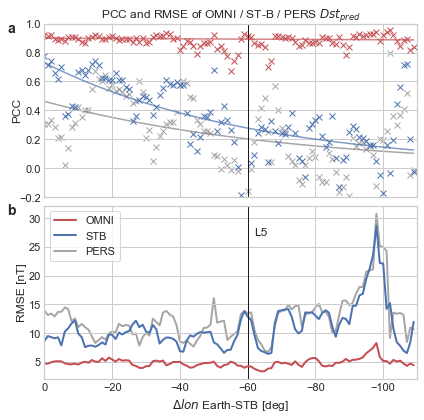

In [31]:
# Plot correlation values between variables:
nfig += 1
#fig, (ax1, ax2, ax3) = plt.subplots(1, 3, num=nfig, figsize=(figwidth, 4.5))
fig, (ax2, ax3) = plt.subplots(2, 1, num=nfig, figsize=(figwidth/2, 6), sharex=True)

# First plot: correlation of variables with increasing distance
#for varo, c, m in zip(['speed', 'btot', 'bx', 'by', 'bz'], 
#                      ['teal','orange','green','coral','purple'], ['o','v','s','^','p']):
#    ax1.plot(cc_vals_10['lons'], cc_vals_10[varo], color=c, ls='--', lw=0.5)
#    ax1.scatter(cc_vals_10['lons'], cc_vals_10[varo], color=c, label=varo, marker=m)
#    ax1.set_xlim([cc_vals_10['lons'][0]+0.5, cc_vals_10['lons'][-1]-0.5])

# Second plot: correlation of Dst(OMNI) and Dst(STB) with Kyoto-Dst
ax2.plot(dlons, ppmc['omni'], 'x', c=modc['omni'], label='OMNI', zorder=2)
ax2.plot(dlons, ppmc['stb'], 'x', c=modc['stb'], label='STB', zorder=1)
ax2.plot(dlons, ppmc['pers'], 'x', c=modc['pers'], alpha=alpha_pers, label='PERS', zorder=0)

# Line denoting position of L5:
ax2.axvline(-60, c='k', lw=1)
#ax2.annotate('L5', (-62, 0.68))
ax3.axvline(-60, c='k', lw=1)
ax3.annotate('L5', (-62, 27))

param, param_cov = curve_fit(decaying_fit, dlons, ppmc['stb']) 
stb_fit = decaying_fit(dlons, *param)
param, param_cov = curve_fit(decaying_fit, dlons, ppmc['pers']) 
pers_fit = decaying_fit(dlons, *param)

# Add linear functions:
ax2.plot(dlons, slope_cc['omni']*dlons+intercept_cc['omni'], '-', c=modc['omni'], alpha=0.7, zorder=2)
ax2.plot(dlons, stb_fit, '-', c=modc['stb'], alpha=0.7, zorder=1)
ax2.plot(dlons, pers_fit, '-', c=modc['pers'], alpha=alpha_pers, zorder=0)

# Third plot: mean average error and stddev of Dst(OMNI) and Dst(STB) with Kyoto-Dst
ax3.plot(dlons, rmse['omni'], c=modc['omni'], ls='-', lw=2, label='OMNI', zorder=2)
#ax3.fill_between(dlons, mean_omni-std_omni, mean_omni+std_omni,
#                 facecolor='r', alpha=0.5)
ax3.plot(dlons, rmse['stb'], c=modc['stb'], ls='-', lw=2, label='STB', zorder=1)
#ax3.fill_between(dlons, mean_stb-std_stb, mean_stb+std_stb,
#                 facecolor='b', alpha=0.5)
ax3.plot(dlons, rmse['pers'], c=modc['pers'], alpha=alpha_pers, ls='-', lw=2, label='PERS', zorder=0)
        
# Formatting:
ylabelpad = -3
ticklabelpad = -2.5
#ax1.set_title("PCC and RMSE of OMNI / ST-B / PERS $Dst_{pred}$")
#ax1.set_xlabel(r"$\Delta lon$ Earth-STB [deg]")
#ax1.set_ylabel("correlation coefficient", labelpad=ylabelpad)
#ax1.tick_params(pad=ticklabelpad)
#ax1.legend()
ax2.set_title("PCC and RMSE of OMNI / ST-B / PERS $Dst_{pred}$")
#ax2.set_xlabel(r"$\Delta lon$ Earth-STB [deg]")
ax2.set_ylabel("PCC", labelpad=ylabelpad)
ax2.tick_params(pad=ticklabelpad)
ax2.set_xlim([angle_bracket[0], angle_bracket[1]])
ax2.set_ylim((-0.2, 1.))
#ax2.legend()
#ax3.set_title("RMSE between pred. $Dst$ and Kyoto $Dst$")
ax3.set_xlabel(r"$\Delta lon$ Earth-STB [deg]")
ax3.set_ylabel("RMSE [nT]", labelpad=ylabelpad+5)
ax3.tick_params(pad=ticklabelpad)
ax3.set_xlim([angle_bracket[0], angle_bracket[1]])
ax3.legend(loc='upper left')

for ax, ann in zip([ax2, ax3], ['a', 'b']):
    ax.text(-0.1, 0.95, ann, transform=ax.transAxes, fontsize=14, weight='bold')

plt.tight_layout()
plt.subplots_adjust(hspace=0.05)
plt.savefig("plots/corr_over_lon.pdf")
plt.show()

### Analysis of values according to Carrington rotation

Calculate PCC, RMSE, MAE, etc. according to Carrington rotation rather than delta-lon.

STEREO-B reached L5 at 2009-10-26 00:00:00+00:00
Number of Carrinton Rotations: 66
L5 reached by STEREO-B at: 2090.0


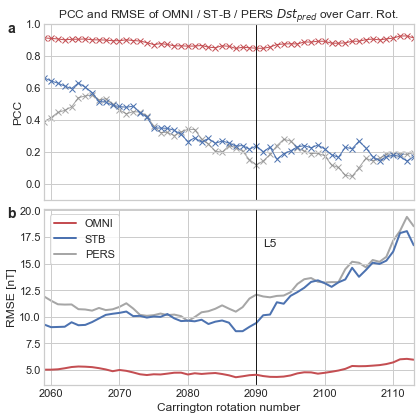

In [32]:
date_L5 = num2date(np.round(stbh['time'][np.where(stbh_lons*180/np.pi < -60)[0][0]], 0))
print("STEREO-B reached L5 at {}".format(date_L5))

carr_rot = np.loadtxt("data/CarringtonRotNums.txt", skiprows=1)
n_crot = np.array(carr_rot[:,0])
t_crot = np.array([(datetime(int(t-t%1),1,1) + timedelta(days=t%1*365.25)) for t in carr_rot[:,4]])
cut_inds = np.where(np.logical_and(t_crot >= num2date(omni['time'][0]-30).replace(tzinfo=None),
                                   t_crot < num2date(omni['time'][-1]).replace(tzinfo=None)))
n_crot_cut = n_crot[cut_inds]
t_crot_cut = t_crot[cut_inds]
n_crot_L5 = n_crot_cut[np.where(t_crot_cut > date_L5.replace(tzinfo=None))[0][0]]
print("Number of Carrinton Rotations:", len(n_crot_cut))
print("L5 reached by STEREO-B at: {}".format(n_crot_L5))

rot_nums, rot_rmse, rot_pcc = [], {'omni': [], 'stb': [], 'pers': []}, {'omni': [], 'stb': [], 'pers': []}
stat_dict = {'omni': [], 'stb': [], 'pers': []}
for inum, num in enumerate(n_crot_cut[:-1]):
    start = date2num(t_crot_cut[inum])
    end = date2num(t_crot_cut[inum+1])
    t_inds = np.where(np.logical_and(omni['time'] >= start, omni['time'] < end))[0]
    
    stat_dict['omni'] = get_statistics(dst_temerinli_omni[t_inds], odst[t_inds], printtext=False)
    stat_dict['stb'] = get_statistics(dst_temerinli[t_inds], odst[t_inds], printtext=False)
    stat_dict['pers'] = get_statistics(dst_temerinli_pers[t_inds], odst[t_inds], printtext=False)
    rot_nums.append(num)
    for mod in modnames:
        rot_rmse[mod].append(stat_dict[mod]['rmse'])
        rot_pcc[mod].append(stat_dict[mod]['ppmc'])
        
window = 11
rot_nums_new, rot_rmse_win = [], {'omni': [], 'stb': [], 'pers': []}
rot_pcc_win = {'omni': [], 'stb': [], 'pers': []}
for i in range(int(window/2), len(rot_nums)-int(window/2)):
    rot_nums_new.append(rot_nums[i])
    for mod in modnames:
        rot_rmse_win[mod].append(np.mean(rot_rmse[mod][i-int(window/2):i+int(window/2)]))
        rot_pcc_win[mod].append(np.mean(rot_pcc[mod][i-int(window/2):i+int(window/2)]))
        
nfig += 1
fig, (ax1, ax2) = plt.subplots(2, 1, num=nfig, figsize=(figwidth/2, 6), sharex=True)

# First plot: mean average error and stddev of Dst(OMNI) and Dst(STB) with Kyoto-Dst
ax1.plot(rot_nums_new, rot_pcc_win['omni'], 'x', c=modc['omni'], lw=2, label='OMNI', zorder=2)
ax1.plot(rot_nums_new, rot_pcc_win['omni'], '-', c=modc['omni'], lw=1, zorder=2)
ax1.plot(rot_nums_new, rot_pcc_win['stb'], 'x', c=modc['stb'], lw=2, label='STB', zorder=1)
ax1.plot(rot_nums_new, rot_pcc_win['stb'], '-', c=modc['stb'], lw=1, zorder=1)
ax1.plot(rot_nums_new, rot_pcc_win['pers'], 'x', c=modc['pers'], alpha=alpha_pers, lw=2, label='PERS', zorder=0)
ax1.plot(rot_nums_new, rot_pcc_win['pers'], '-', c=modc['pers'], alpha=alpha_pers, lw=1, zorder=0)

# Line denoting position of L5:
ax1.axvline(2090, c='k', lw=1)
ax2.axvline(2090, c='k', lw=1)
ax2.annotate('L5', (2091, 16.6))

# Add linear functions:
#ax1.plot(dlons, slope_cc['omni']*dlons+intercept_cc['omni'], '-', c=modc['omni'], alpha=0.7, zorder=2)
#ax1.plot(dlons, slope_cc['stb']*dlons+intercept_cc['stb'], '-', c=modc['stb'], alpha=0.7, zorder=1)
#ax1.plot(dlons, slope_cc['pers']*dlons+intercept_cc['pers'], '-', c=modc['pers'], alpha=alpha_pers, zorder=0)

# Second plot: mean average error and stddev of Dst(OMNI) and Dst(STB) with Kyoto-Dst
ax2.plot(rot_nums_new, rot_rmse_win['omni'], c=modc['omni'], ls='-', lw=2, label='OMNI', zorder=2)
ax2.plot(rot_nums_new, rot_rmse_win['stb'], c=modc['stb'], ls='-', lw=2, label='STB', zorder=1)
ax2.plot(rot_nums_new, rot_rmse_win['pers'], c=modc['pers'], alpha=alpha_pers, ls='-', lw=2, label='PERS', zorder=0)
        
# Formatting:
ylabelpad = 2
ticklabelpad = -2.5
ax1.set_title("PCC and RMSE of OMNI / ST-B / PERS $Dst_{pred}$ over Carr. Rot.")
ax1.set_ylabel("PCC", labelpad=ylabelpad)
ax1.tick_params(pad=ticklabelpad)
ax1.set_xlim([rot_nums_new[0], rot_nums_new[-1]])
ax1.set_ylim((-0.1, 1.))
ax2.set_xlabel("Carrington rotation number")
ax2.set_ylabel("RMSE [nT]", labelpad=ylabelpad)
ax2.tick_params(pad=ticklabelpad)
#ax2.set_xlim([angle_bracket[0], angle_bracket[1]])
ax2.legend(loc='upper left')

for ax, ann in zip([ax1, ax2], ['a', 'b']):
    ax.text(-0.1, 0.95, ann, transform=ax.transAxes, fontsize=14, weight='bold')

plt.tight_layout()
plt.subplots_adjust(hspace=0.05)
plt.savefig("plots/corr_over_crot.pdf")
plt.show()

### Dst accuracy depending on latitude diff

If we assume the overall trend in correlation is purely a result of longitudinal difference, we can subtract this while plotting against latitude to see the effect latitude difference has.

Correlation coefficient (corrected CC(Dst) with diff in lat.)  = 0.05
Correlation coefficient (corrected RMSE(Dst) with diff in lat.) = -0.34
Correlation coefficient (corrected MeanError(Dst) with diff in lat.) = 0.13
Correlation coefficient (corrected MAE(Dst) with diff in lat.) = -0.34


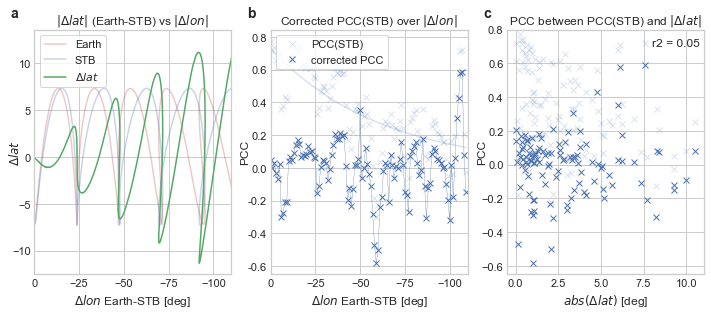

In [33]:
dlats = np.abs(np.array(stat_dicts['latdiffs']))
main_slope = 'stb'
minus_slope = 'omni'
limit = 110
cc_val_lat_cc = np.corrcoef(ppmc['stb'][:limit] - stb_fit[:limit] - slope_cc[minus_slope]*dlons, 
                            dlats[:limit])[0][1]
print("Correlation coefficient (corrected CC(Dst) with diff in lat.)  = {:.2f}".format(cc_val_lat_cc))
cc_val_lat_rmse = np.corrcoef(rmse['stb'][:limit] - slope_rmse[main_slope]*dlons[:limit],# - slope_rmse[minus_slope]*dlons, 
                              dlats[:limit])[0][1]
print("Correlation coefficient (corrected RMSE(Dst) with diff in lat.) = {:.2f}".format(cc_val_lat_rmse))
cc_val_lat_me = np.corrcoef(mean['stb'][:limit] - slope_me[main_slope]*dlons[:limit],# - slope_me[minus_slope]*dlons, 
                            dlats[:limit])[0][1]
print("Correlation coefficient (corrected MeanError(Dst) with diff in lat.) = {:.2f}".format(cc_val_lat_me))
cc_val_lat_mae = np.corrcoef(mae['stb'][:limit] - slope_mae[main_slope]*dlons[:limit],# - slope_mae[minus_slope]*dlons, 
                             dlats[:limit])[0][1]
print("Correlation coefficient (corrected MAE(Dst) with diff in lat.) = {:.2f}".format(cc_val_lat_mae))

plt.close()
fig, (ax1, ax2, ax3) = plt.subplots(1,3, figsize=(figwidth,4.5))
ax1.plot(stbh_lons*180/np.pi, L1Pos['lat']*180/np.pi, '-', c=modc['omni'], alpha=0.3, label="Earth")
ax1.plot(stbh_lons*180/np.pi, stbh_lats*180/np.pi, c=modc['stb'], alpha=0.3, label='STB')
ax1.plot(stbh_lons*180/np.pi, stbh_lats*180/np.pi - L1Pos['lat']*180/np.pi, 'g-', label="$\Delta lat$")

metric = ppmc
slope, intercept = slope_cc, intercept_cc
cc_val = cc_val_lat_cc
ax2.plot(dlons, metric['stb'], 'bx', label='PCC(STB)', alpha=0.2)
ax2.plot(dlons, metric['stb'] - stb_fit, 'bx', label='corrected PCC')
ax2.plot(dlons, metric['stb'] - stb_fit, 'b-', lw=0.3)
ax2.plot(dlons, stb_fit, 'b-', alpha=0.2)
ax3.plot(dlats, metric['stb'] - stb_fit, 'bx')
ax3.plot(dlats, metric['stb'], 'bx', alpha=0.2)

ylabelpad = 0
ticklabelpad = -2.5
xlims = (-0, -110)
ax1.set_xlim(xlims)
ax1.legend(loc='upper left')
ax1.set_xlabel(r"$\Delta lon$ Earth-STB [deg]")
ax1.set_ylabel("$\Delta lat$", labelpad=ylabelpad-9)
ax1.set_title("$|\Delta lat|$ (Earth-STB) vs $|\Delta lon|$")
ax1.tick_params(pad=ticklabelpad)
ax2.set_xlim(xlims)
ax2.legend(loc='upper left')
ax2.set_title("Corrected PCC(STB) over $|\Delta lon|$")
ax2.set_xlabel(r"$\Delta lon$ Earth-STB [deg]")
ax2.set_ylabel("PCC", labelpad=ylabelpad-2)
ax2.tick_params(pad=ticklabelpad)
ax2.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, pos: '{:,.1f}'.format(x)))
ax3.annotate('r2 = {:.2f}'.format(cc_val), (8, 0.7))
ax3.set_xlabel("$abs(\Delta lat)$ [deg]")
ax3.set_ylabel("PCC", labelpad=ylabelpad+1)
ax3.set_title("PCC between PCC(STB) and $|\Delta lat|$")
ax3.tick_params(pad=ticklabelpad)
ax3.yaxis.set_label_coords(-0.1, 0.5)
ax3.set_ylim((-0.65,0.8))

for ax, ann in zip([ax1, ax2, ax3], ['a', 'b', 'c']):
    ax.text(-0.12, 1.05, ann, transform=ax.transAxes, fontsize=14, weight='bold')

plt.subplots_adjust(wspace=0.2)
#plt.tight_layout()
plt.savefig('plots/corr_over_lat.pdf')
plt.show()

### Event-based analysis with 12-hour windows

Calculate true/false event count for values of Dst below threshold (ideally -50 nT) within a time window, in this case 12 hours. Use overlapping windows of 12 hours at 6 hour resolution.

Corr. coeff. Dst(Kyoto) vs. Dst(OMNI) = 0.93
Corr. coeff. Dst(Kyoto) vs. Dst(ST-B) = 0.43
Corr. coeff. Dst(Kyoto) vs. Dst(PERS) = 0.33


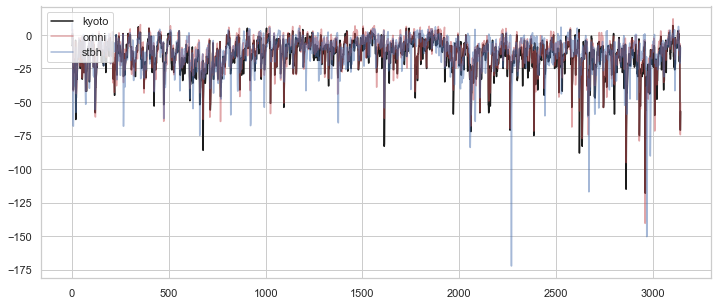

In [34]:
event_dst, event_time = {}, {}
for src, dstdata in zip(['kyoto', 'omni', 'stbh', 'pers'], 
                        [odst, dst_temerinli_omni, dst_temerinli, dst_temerinli_pers]):
    event_dst[src], event_time[src] = [], []
    for i in np.arange(event_window, len(dstdata)-event_window, event_window):
        #event_dst[src].append(len(np.where(dstdata[i-event_window:i+event_window] < event_threshold)[0]))
        event_dst[src].append(np.min(dstdata[i-event_window:i+event_window]))
        event_time[src].append(omni['time'][i])
        
cc_event_omni = np.corrcoef(event_dst['kyoto'], event_dst['omni'])[0][1]
cc_event_stbh = np.corrcoef(event_dst['kyoto'], event_dst['stbh'])[0][1]
cc_event_pers = np.corrcoef(event_dst['kyoto'], event_dst['pers'])[0][1]
print("Corr. coeff. Dst(Kyoto) vs. Dst(OMNI) = {:.2f}".format(cc_event_omni))
print("Corr. coeff. Dst(Kyoto) vs. Dst(ST-B) = {:.2f}".format(cc_event_stbh))
print("Corr. coeff. Dst(Kyoto) vs. Dst(PERS) = {:.2f}".format(cc_event_pers))

nfig += 1
fig = plt.figure(figsize=(figwidth,5))
plt.plot(event_dst['kyoto'], 'k-', label='kyoto')
plt.plot(event_dst['omni'], 'r-', alpha=0.5, label='omni')
plt.plot(event_dst['stbh'], 'b-', alpha=0.5, label='stbh')
plt.legend(loc='upper left')
plt.show()

event_dst['kyoto'] = np.array(event_dst['kyoto'])
event_dst['kyoto'][event_dst['kyoto'] > 1] = 1
event_dst['omni'] = np.array(event_dst['omni'])
event_dst['omni'][event_dst['omni'] > 1] = 1
event_dst['stbh'] = np.array(event_dst['stbh'])
event_dst['stbh'][event_dst['stbh'] > 1] = 1
event_dst['pers'] = np.array(event_dst['pers'])
event_dst['pers'][event_dst['pers'] > 1] = 1

# Save data to file:
savearray = np.vstack((range(0,len(event_dst['kyoto'])), event_dst['kyoto'], event_dst['omni'], 
                       event_dst['stbh'], event_dst['pers'])).T
fileheader = "time dst_kyoto dst_l1 dst_stb dst_pers"
np.savetxt("results/dst_data_24h.txt", savearray, fmt="%.5f", header=fileheader)

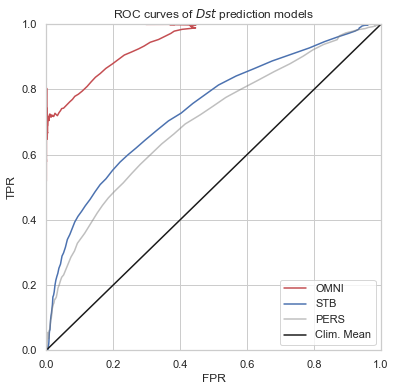

In [35]:
ROC_omni = np.loadtxt("osea_results/ROC_FPR_TPR_l1.txt")
ROC_stb = np.loadtxt("osea_results/ROC_FPR_TPR_stb.txt")
ROC_pers = np.loadtxt("osea_results/ROC_FPR_TPR_persistence.txt")
ROC_baseline = np.loadtxt("osea_results/ROC_FPR_TPR_baseline.txt")

fig = plt.figure(figsize=(figwidth/2, figwidth/2))
plt.plot(ROC_omni[:,0], ROC_omni[:,1], 'r-', label="OMNI")
plt.plot(ROC_stb[:,0], ROC_stb[:,1], 'b-', label="STB")
plt.plot(ROC_pers[:,0], ROC_pers[:,1], '-', c='grey', alpha=0.5, label="PERS")
plt.plot(ROC_baseline[:,0], ROC_baseline[:,1], 'k-', label="Clim. Mean")
plt.xlim((0,1))
plt.ylim((0,1))
plt.xlabel("FPR")
plt.ylabel("TPR")
plt.legend()
plt.title("ROC curves of $Dst$ prediction models")
plt.savefig("plots/roc_curves.pdf")
plt.show()

## DATA ANALYSIS (REDUCED RANGE)

Reducing range of angles from [0, -110] to [-50, -70].

Do some basic statistics then save data to file for event-based analysis.

In [36]:
angle_bracket_reduced = [-50, -70]
min_time = np.round(stbh['time'][np.where(stbh.pos['lon']*180/np.pi < angle_bracket_reduced[0])[0][0]], 0)
max_time = np.round(stbh['time'][np.where(stbh.pos['lon']*180/np.pi < angle_bracket_reduced[1])[0][0]], 0)
print('Time range covered for analysis in angle bracket {}:'.format(angle_bracket_reduced))
print('start:', num2date(min_time))
print('end:  ', num2date(max_time))

# Cut data
stbh_red = copy.deepcopy(stbh)
stbh_red = stbh_red.cut(starttime=num2date(min_time), endtime=num2date(max_time))
omni_red = copy.deepcopy(omni)
omni_red = omni_red.cut(starttime=num2date(min_time), endtime=num2date(max_time))
pers_red = copy.deepcopy(pers)
pers_red = pers_red.cut(starttime=num2date(min_time), endtime=num2date(max_time))

Time range covered for analysis in angle bracket [-50, -70]:
start: 2009-08-02 00:00:00+00:00
end:   2010-01-31 00:00:00+00:00


In [37]:
# Get model Dst
dst_temerinli_omni_red = omni_red['ae']
dst_temerinli_pers_red = pers_red['dst']
dst_temerinli_red = stbh_red['dst']
# Actual Dst for interval
odst_red = omni_red['dst']

print("Mean, Min and Max:")
for ndata, data in zip(['Kyoto', 'OMNI', 'STB', 'PERS'],[odst_red, dst_temerinli_omni_red, 
                                                         dst_temerinli_red, dst_temerinli_pers_red]):
    print("{}: {:.2f} -- {:.2f} -- {:.2f}".format(ndata, np.nanmean(data), np.nanmin(data), np.nanmax(data)))

Mean, Min and Max:
Kyoto: -2.01 -- -47.00 -- 27.00
OMNI: -1.13 -- -42.34 -- 24.90
STB: -1.45 -- -40.67 -- 16.97
PERS: -0.83 -- -62.81 -- 24.17


In [38]:
# Get statistics
sd_omni_red = get_statistics(dst_temerinli_omni_red, odst_red, source='L1')
sd_stb_red = get_statistics(dst_temerinli_red, odst_red, source='STEREO-B')
sd_pers_red = get_statistics(dst_temerinli_pers_red, odst_red, source='PERSISTENCE MODEL')

DATA FROM L1
------------
Dst diff mean +/- std: -0.89 +/- 4.38

Dst obs  mean +/- std: -2.01 +/- 8.00
Dst pred mean +/- std: -1.13 +/- 7.62
Dst obs  min / max: -47.00 / 27.00
Dst pred min / max: -42.34 / 24.90

Pearson correlation: 0.85 
Cross-correlation:   0.0 hours
Mean absolute error: 3.38 nT
RMSE:                4.38 nT

DATA FROM STEREO-B
------------------
Dst diff mean +/- std: -0.56 +/- 8.89

Dst obs  mean +/- std: -2.01 +/- 8.00
Dst pred mean +/- std: -1.45 +/- 6.29
Dst obs  min / max: -47.00 / 27.00
Dst pred min / max: -40.67 / 16.97

Pearson correlation: 0.25 
Cross-correlation:   11.5 hours
Mean absolute error: 6.63 nT
RMSE:                8.89 nT

DATA FROM PERSISTENCE MODEL
---------------------------
Dst diff mean +/- std: -1.19 +/- 10.90

Dst obs  mean +/- std: -2.01 +/- 8.00
Dst pred mean +/- std: -0.83 +/- 8.36
Dst obs  min / max: -47.00 / 27.00
Dst pred min / max: -62.81 / 24.17

Pearson correlation: 0.12 
Cross-correlation:   -6251.1 hours
Mean absolute error: 8.0

In [39]:
# Save data to file:
savearray = np.vstack((omni_red['time'], odst_red, dst_temerinli_omni_red, 
                       dst_temerinli_red, dst_temerinli_pers_red,
                       omni_red['speed'], stbh_red['speed'], pers_red['speed'])).T
fileheader = "time dst_kyoto dst_l1 dst_stb dst_pers v_l1 v_stb v_pers"
np.savetxt("results/dst_data_red.txt", savearray, fmt="%.5f", header=fileheader)

## Offset in Dst as a function of offset in B

Plots the offset in Dst as a function of linear offset in magnetic field measurements.

In [40]:
offset_vars = ['bx', 'by', 'bz', 'btot']
offset_vals = [-1.0, -0.7, -0.5, -0.3, -0.1, 0., 0.1, 0.3, 0.5, 0.7, 1.0]
offset_results_mean = np.zeros((len(offset_vars), len(offset_vals)))
offset_results_min = np.zeros((len(offset_vars), len(offset_vals)))

omni = ps.get_omni_data(starttime=datetime(2007,1,1), endtime=datetime(2009,1,1), download=True)
omni = omni.interp_nans()

for ivar, var in enumerate(offset_vars):
    for ival, val in enumerate(offset_vals):
        print("Adding {} to {}".format(val, var))
        mag_offset = copy.deepcopy(omni)
        if var == 'btot':
            mag_offset[var] = np.sqrt(mag_offset['bx']**2. + mag_offset['by']**2. + mag_offset['bz']**2.)
            mag_offset[var] += val
        else:
            mag_offset[var] += val
            mag_offset['btot'] = np.sqrt(mag_offset['bx']**2. + mag_offset['by']**2. + mag_offset['bz']**2.)
        
        # Make dst predictions:
        dst_temerinli = mag_offset.make_dst_prediction()['dst']
        with open('dst_pred_model_final.pickle', 'rb') as f:
            model = pickle.load(f)
        dstdiff_pred = mag_offset.make_dst_prediction_from_model(model)['dst']
        dst_temerinli += dstdiff_pred
        
        offset_results_mean[ivar, ival] = np.mean(dst_temerinli)
        offset_results_min[ivar, ival] = np.min(dst_temerinli)
        #print('var\t', '\t'.join([str(x) for x in offset_vals]))
        #for ivar2, r in enumerate(offset_results_mean):
        #    print(offset_vars[ivar2]+'\t', '\t'.join(['{:.2f}'.format(x) for x in r]))
        #print()

null_offset_mean = offset_results_mean[0,offset_vals.index(0.0)]
offset_diffmean = offset_results_mean - null_offset_mean
null_offset_min = offset_results_min[0,offset_vals.index(0.0)]
offset_diffmin = offset_results_min - null_offset_min
print('var\t', '\t'.join([str(x) for x in offset_vals])) 
print("MEANS:")
for ivar2, r in enumerate(offset_diffmean): 
    print(offset_vars[ivar2]+'\t', '\t'.join(['{:.2f}'.format(x) for x in r])) 
print()
print("MINIMA:")
for ivar2, r in enumerate(offset_diffmin): 
    print(offset_vars[ivar2]+'\t', '\t'.join(['{:.2f}'.format(x) for x in r])) 
print()

Adding -1.0 to bx
Adding -0.7 to bx
Adding -0.5 to bx
Adding -0.3 to bx
Adding -0.1 to bx
Adding 0.0 to bx
Adding 0.1 to bx
Adding 0.3 to bx
Adding 0.5 to bx
Adding 0.7 to bx
Adding 1.0 to bx
Adding -1.0 to by
Adding -0.7 to by
Adding -0.5 to by
Adding -0.3 to by
Adding -0.1 to by
Adding 0.0 to by
Adding 0.1 to by
Adding 0.3 to by
Adding 0.5 to by
Adding 0.7 to by
Adding 1.0 to by
Adding -1.0 to bz
Adding -0.7 to bz
Adding -0.5 to bz
Adding -0.3 to bz
Adding -0.1 to bz
Adding 0.0 to bz
Adding 0.1 to bz
Adding 0.3 to bz
Adding 0.5 to bz
Adding 0.7 to bz
Adding 1.0 to bz
Adding -1.0 to btot
Adding -0.7 to btot
Adding -0.5 to btot
Adding -0.3 to btot
Adding -0.1 to btot
Adding 0.0 to btot
Adding 0.1 to btot
Adding 0.3 to btot
Adding 0.5 to btot
Adding 0.7 to btot
Adding 1.0 to btot
var	 -1.0	-0.7	-0.5	-0.3	-0.1	0.0	0.1	0.3	0.5	0.7	1.0
MEANS:
bx	 -0.00	-0.01	-0.01	-0.01	-0.00	0.00	0.00	0.01	0.02	0.03	0.06
by	 -0.11	-0.05	-0.02	-0.01	0.00	0.00	-0.00	-0.02	-0.04	-0.07	-0.14
bz	 -6.22	-4.27	-

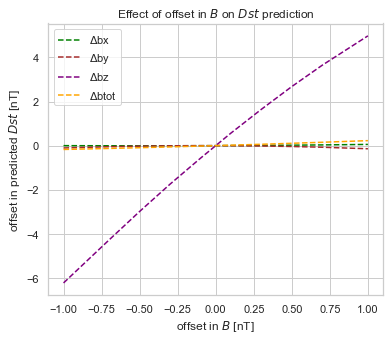

In [41]:
fig = plt.figure(figsize=figsize_half)
for ivar, var in enumerate(offset_vars[:4]):
    plt.plot(offset_vals, offset_diffmean[ivar], '--', c=varcolors[var], label=r'$\Delta$'+var)
plt.xlabel(r"offset in $B$ [nT]")
plt.ylabel(r"offset in predicted $Dst$ [nT]")
plt.title(r"Effect of offset in $B$ on $Dst$ prediction")
plt.legend()
plt.savefig("plots/dst_offset.pdf")
plt.show()